# CompSpec Cookhouse 1

## Intro
* **Date**: 11/29/2020
* **What**: This is a cookhouse, bitch.  That means I get to try a bunch of stuff out and see what works.  Throw some well-curated mud against the wall and see what sticks.  On the docket we got CS-i2, bringing back the win-rate term, better use of specialization, and ordered data.
* **Why**: Because the first classifier was a third-rate dumpster fire, and I need to go back to the drawing board.  I especially want to see CS-i2 outperform CS-i.  I also super need to see how CompSpec does with ordered data.  If I want this motherfucker to work in real-time, it's going to need to perform well with orderly information, because information isn't processed in a massively shuffled manner.  
* **Hopes**: I got a couple hopes.  I want CS-i2 to work really well.  Because I already have the classification code, I can just kinda yote CS-i2 in there and see if it gets better classification results.  I want to see if I can find a way for the win-rate term to not ruin diversity.  I want to mess with how the specialization term work so that we eradicate fuzzy threes.  I want the network to still learn diverse specialized prototypes even if the data is ordered.
* **Limitations**: Really the biggest one is that everything could and probably will go wrong.  This is a cookhouse, so I'm not going to address all the limitations I forsee, but really the biggest limitation is the incredibly uncertainty of the unknown, to get fucking poetic about it.  Let's get coding.

## Code

In [215]:
import numpy as np
import matplotlib.pyplot as plt

from time import time
from tensorflow.keras.datasets import mnist
from tqdm import tqdm

L = 28 * 28   #Size of mnist in pixels
S = 60000     #Size of training set

(train_X, train_y), (test_X, test_y) = mnist.load_data()
train_X = train_X / 255.0

flat_x = np.reshape(train_X, [-1, L])
flat_test = np.reshape(test_X, [-1, L])

In [28]:
def draw_weights(synapses, Kx, Ky):
    yy=0
    HM=np.zeros((28*Ky,28*Kx))
    for y in range(Ky):
        for x in range(Kx):
            HM[y*28:(y+1)*28,x*28:(x+1)*28]=synapses[yy,:].reshape(28,28)
            yy += 1
    plt.clf()
    nc=np.amax(np.absolute(HM))
    im=plt.imshow(HM,cmap='Greys')
    fig.colorbar(im,ticks=[0, np.amax(HM)])
    plt.axis('off')
    fig.canvas.draw()   

In [3]:
def classify(w, w_c, v):
    v_sq = np.square(v).T #Automatically transpose
    v_norm = np.linalg.norm(v)

    wv_v = w @ v_sq

    wv_wv_norm = np.sqrt(np.maximum(np.square(w) @ v_sq, prec))

    o = wv_v / (wv_wv_norm * v_norm)

    #Handle classification layer
    v_sq_c = np.square(o).T
    v_norm_c = np.linalg.norm(o)

    wv_v_c = w_c @ v_sq_c

    wv_norm_c = np.sqrt(np.maximum(np.square(w_c) @ v_sq_c, prec))

    o_c = wv_v_c / (wv_norm_c * v_norm_c)
    
#     print(o_c)
    
    return np.argmax(o_c)

In [4]:
def get_accuracy(w, w_c, flat_test, test_y):
    num_correct = 0
    
    mis_c = np.zeros(10)
    for (v, lbl) in tqdm(zip(flat_test, test_y)):
        if classify(w, w_c, v) == lbl:
            num_correct += 1 
        else:
            mis_c[lbl] += 1
            
    print("Misclassified inputs:", mis_c)
    print("Model accuracy:", 100 * num_correct / flat_test.shape[0])
            
    return 100 * num_correct / flat_test.shape[0]

In [72]:
def plot_everything(w, w_c, x, y):
    plt.figure(figsize=(2 * 2 * x, 2 * y))

    w_c_t = w_c.T

    for i in range(x * y):
        plt.subplot(y, 2 * x, (2 * i) + 1)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(w[i].reshape(28, 28), cmap='Greys')
        plt.subplot(y, 2 * x, (2 * i) + 2)
        plt.xticks(range(10))
        plt.bar(range(10), w_c_t[i], color='blue')

    plt.show()

## Analysis Dialog

Alright, the first matter on the docket is CS-i2.  The idea behind CS-i2 is that we're not learning a weight prototype that's normalized to the unit sphere, we're learning an input filter.  Also we assume that neurons always take measures between 0 and 1.  Here are the equations we're testing:

$$
o = \frac{\left<wq, q\right>}{\left<q, q\right>}
$$


$$
\Delta w = (v - w) \;g(s)\; \xi
$$

So yeah, what you'll notice is that $w$ is really only acting like a filter, and there's no notion of spherical learning going on.  Also $g$ is a monotonically decreasing function such that $g(0) = 1$.  If the form of this equation doesn't look familiar, than please for the love of god refamiliarize yourself with the experiments from the past week.  Ok, let's see how this mother fucker does.   

100%|██████████| 6000/6000 [00:00<00:00, 7967.96it/s]


Max val:  0.5945925624347235 Min value:  0.3522796904642441 Mean val:  0.549496568069512 Std:  0.06782323850477485
Elapsed time:  3.6577837467193604  seconds


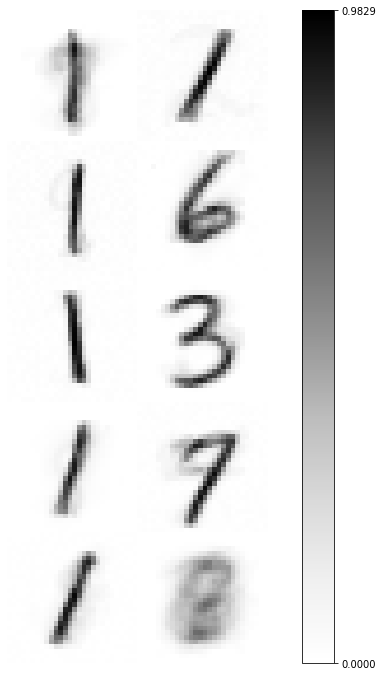

In [31]:
%matplotlib inline
fig=plt.figure(figsize=(12,12))

Kx = 2
Ky = 5
Nep = 3
T_s = 60000
xi = 0.5
phi = 2 / 11

B = 10 #Batch size

prec = 0.01

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) * o

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

In [30]:
s

array([[0.56836742],
       [0.56821672],
       [0.57000549],
       [0.60837914],
       [0.56240075],
       [0.55768155],
       [0.35160616],
       [0.53487072],
       [0.57208791],
       [0.58027917]])

Alright so I got CS-i2 cooked up.  Already, it's pretty clear that we got a fuzzy three absorbing most everything.  But let me hit you with 100 neurons.

<IPython.core.display.Javascript object>


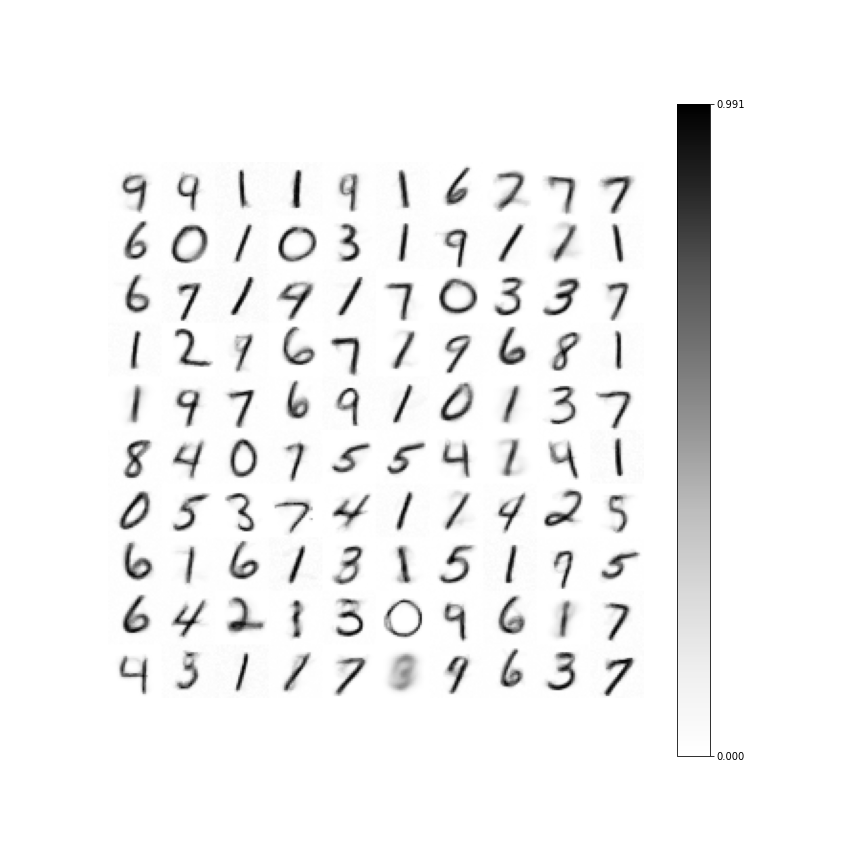

100%|██████████| 600/600 [00:00<00:00, 775.15it/s]


Max val:  0.661970425119963 Min value:  0.35589030550452116 Mean val:  0.5750933187956705 Std:  0.038423549209254226
Elapsed time:  6.782016038894653  seconds


<IPython.core.display.Javascript object>


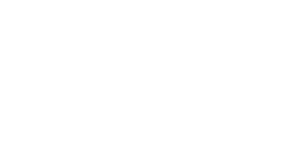

In [37]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 5
T_s = 60000
xi = 0.5
phi = 2 / 11

B = 100 #Batch size

prec = 0.01

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) * o

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Ok, let's talk the good and the bad. The good is that this is learning reasonable prototypes, as far as I can tell.  To better demonstrate the bad, I'm going to lower $\xi$ down to 0.1

<IPython.core.display.Javascript object>


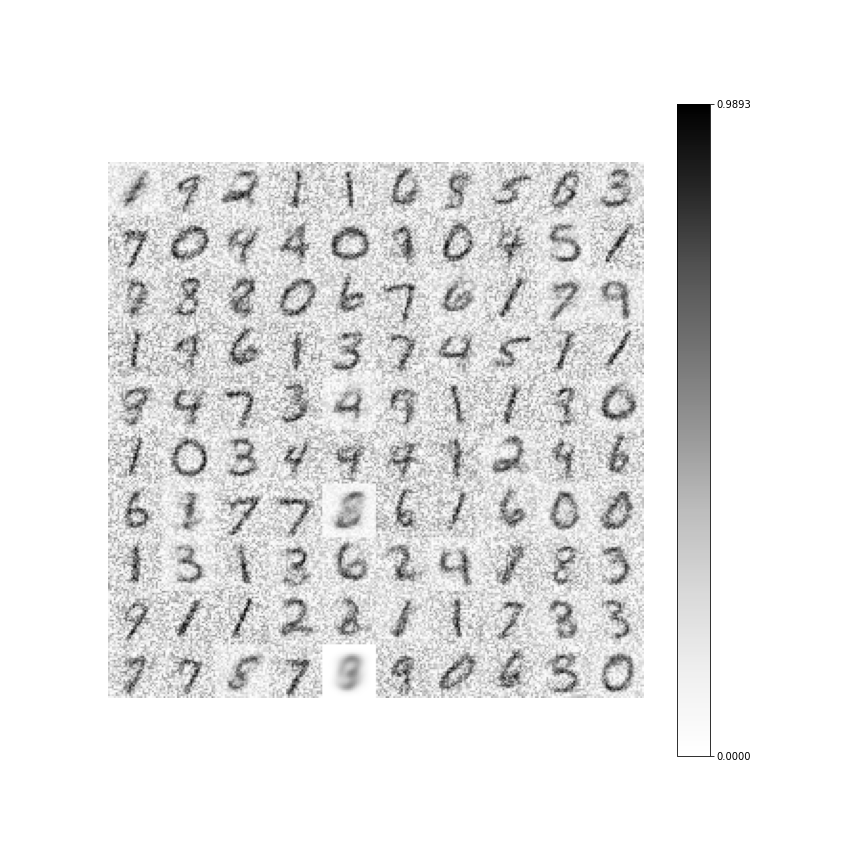

100%|██████████| 600/600 [00:00<00:00, 767.50it/s]


Max val:  0.6349658377791761 Min value:  0.3535854313717778 Mean val:  0.5308001678222275 Std:  0.036782426518705495
Elapsed time:  6.929276466369629  seconds


<IPython.core.display.Javascript object>


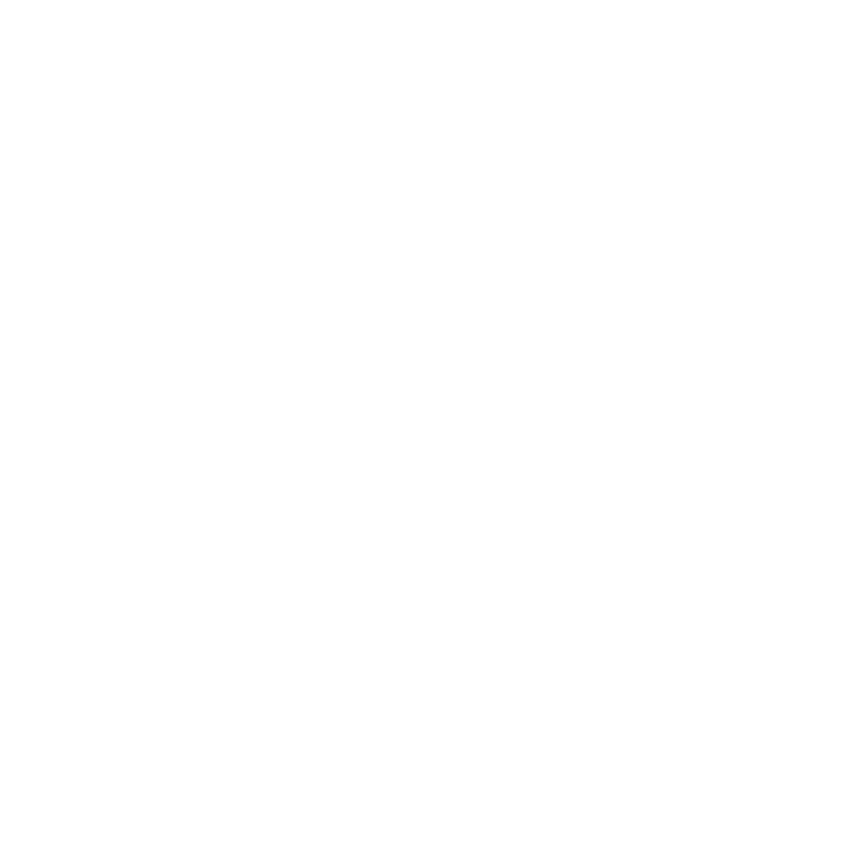

In [43]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 11

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

The first time around, I was using $o$ instead of $1 / (1 - o)$ in the competition value.  But here, you can clearly see that even after 5 epochs, most of the values remain uninitialized. That's bad. This makes me pretty darn nervous, because I think what it insinuates is that CompSpec has basically just been copying the first $n$ input vectors, and after that, the prototypes are largely un-updated.  That works for something like mnist where the first $n$ inputs are a fairly good representation of everything else to come, but for a more complex dataset, such a strategy is shit.  The solution?  We need to bring back the win rate term.  However, before I do, I think I'm going to run this through the classifier and see how it does.

Actually first, I think I'm going to decrease phi quite a bit and see what happens.

<IPython.core.display.Javascript object>


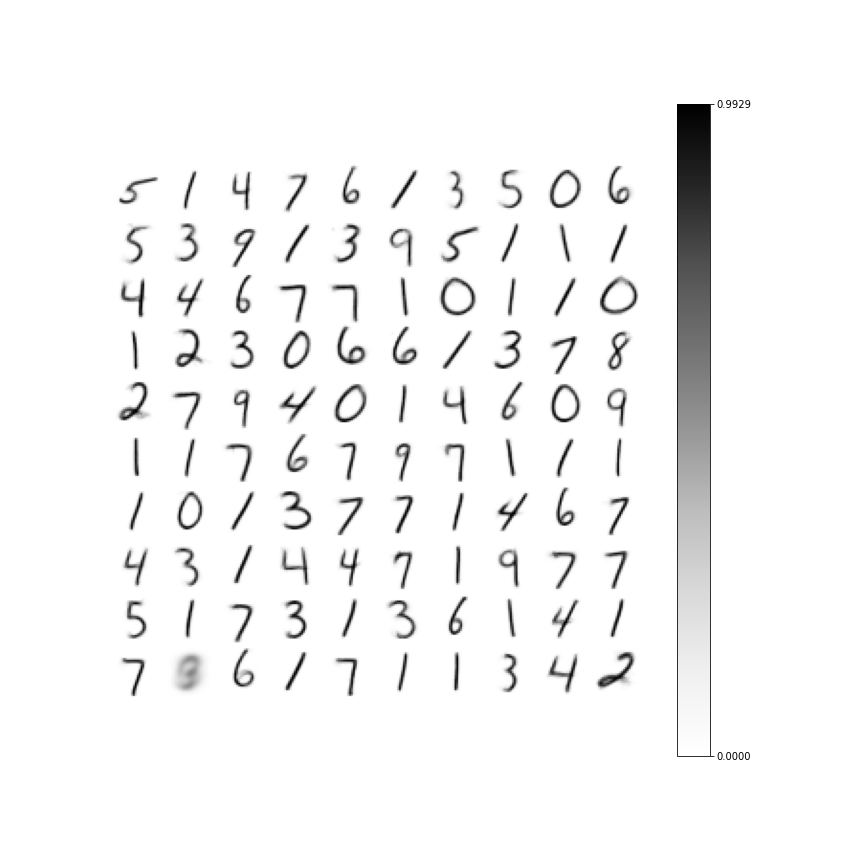

100%|██████████| 600/600 [00:00<00:00, 769.32it/s]


Max val:  0.6739067232157749 Min value:  0.35468172373139484 Mean val:  0.5833969738356084 Std:  0.05346045407455841
Elapsed time:  13.254697322845459  seconds


<IPython.core.display.Javascript object>


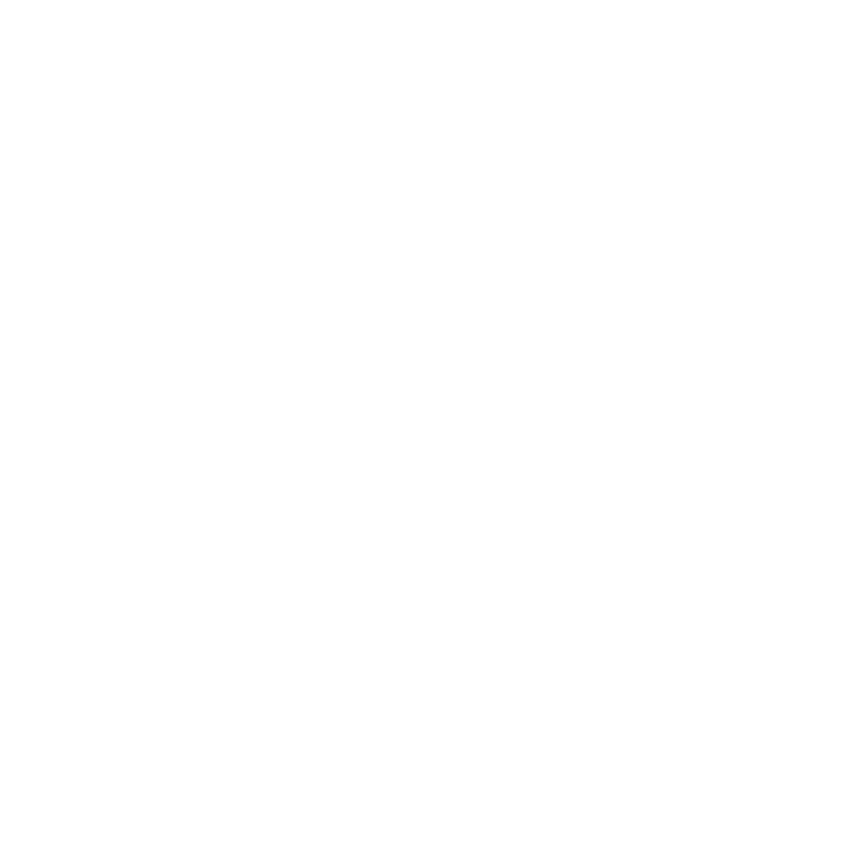

In [46]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Wow so decreasing phi allows for much clearer prototypes to be learned.  The issue?  Look how incredibly pristine all the prototypes are.  Now look at the fuzzy three.  The fuzzy three is clearly absorbing nearly all of the inputs, and the prototypes are selecting very specific inputs to update on.  This actually makes me curious.  I'm going to try this network with ordered data and see what happens.  

<IPython.core.display.Javascript object>


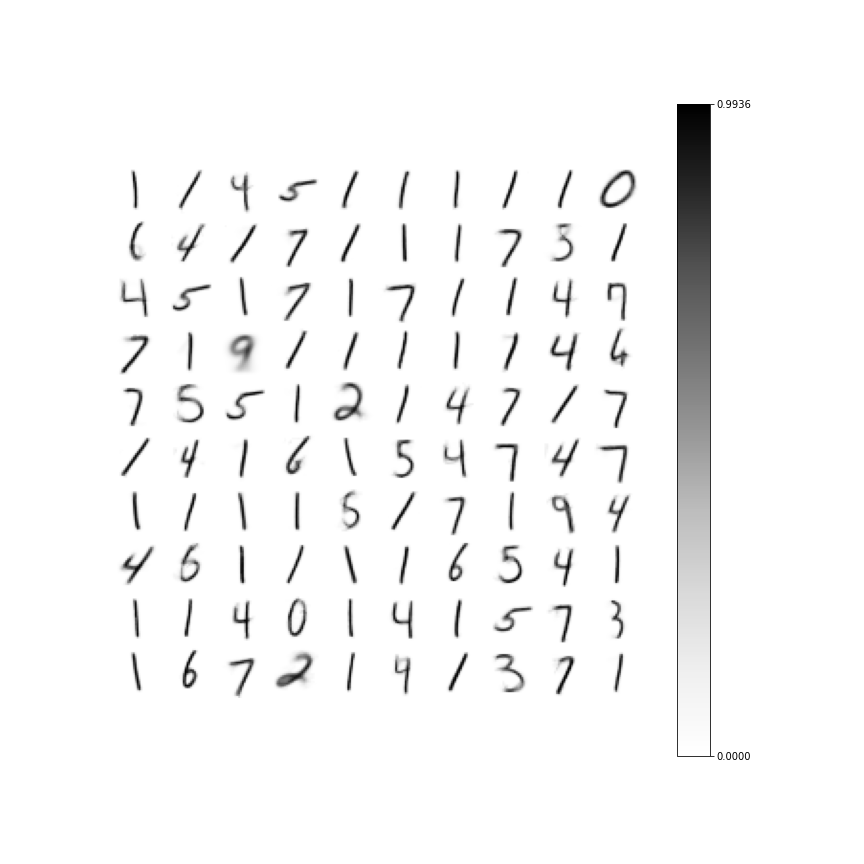

100%|██████████| 600/600 [00:00<00:00, 809.78it/s]


Max val:  0.6918741300188231 Min value:  0.42341990550326497 Mean val:  0.6096793759732558 Std:  0.044723365473585734
Elapsed time:  18.37284231185913  seconds


<IPython.core.display.Javascript object>


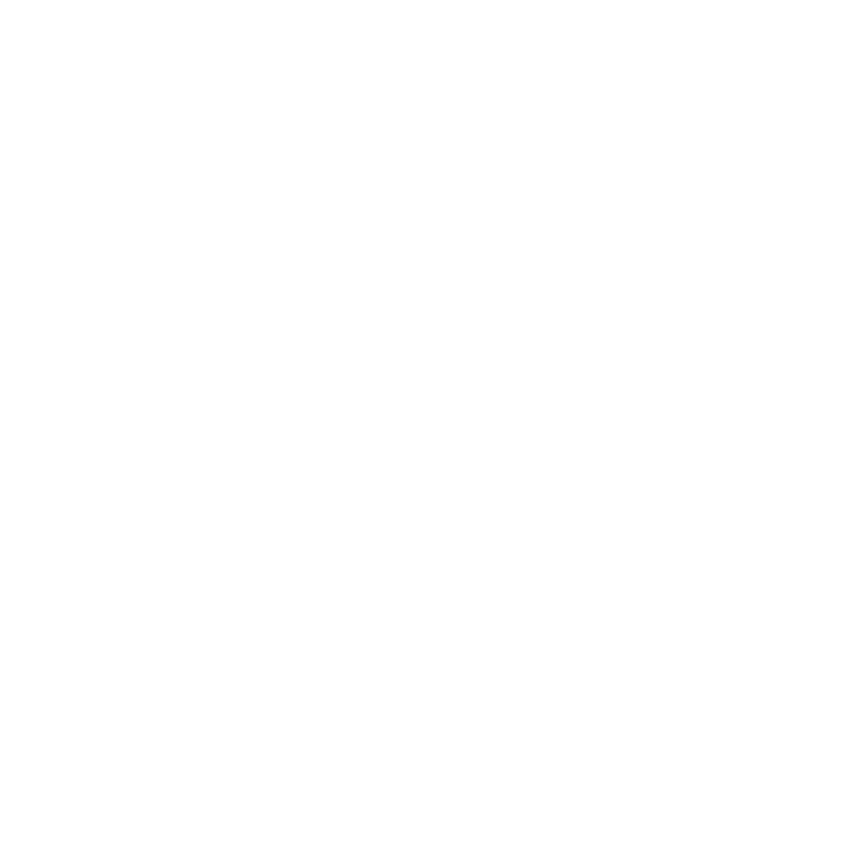

In [56]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 20
T_s = 60000
xi = 0.1
phi = 2 / 501

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :]
in_sq = np.square(inputs)
in_norm_sq = np.sum(in_sq, axis=1)

for ep in range(Nep):

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Wow, that actually worked way better than I was expecting.  Unfortunately, you'll notice there's very poor representation for eights and 9's, and in general, more complicated shapes.  I'm going to try to increase phi and see if we can change that...

<IPython.core.display.Javascript object>


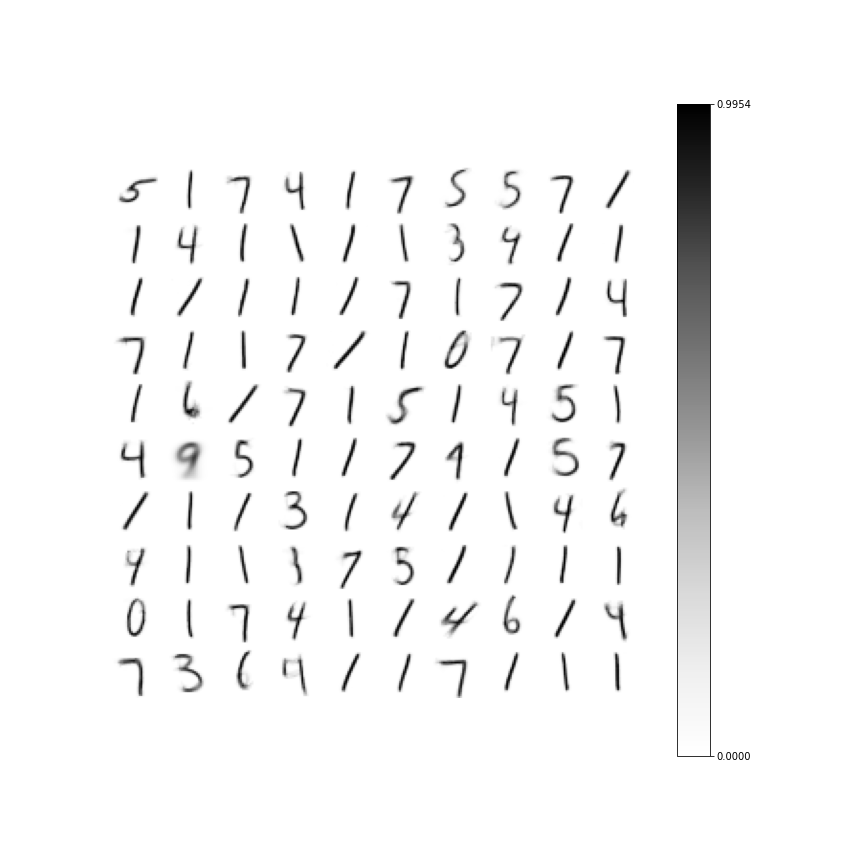

100%|██████████| 600/600 [00:00<00:00, 763.98it/s]


Max val:  0.6826475984618813 Min value:  0.41984813698805934 Mean val:  0.5964640054455284 Std:  0.04359938546586897
Elapsed time:  27.578964948654175  seconds


<IPython.core.display.Javascript object>


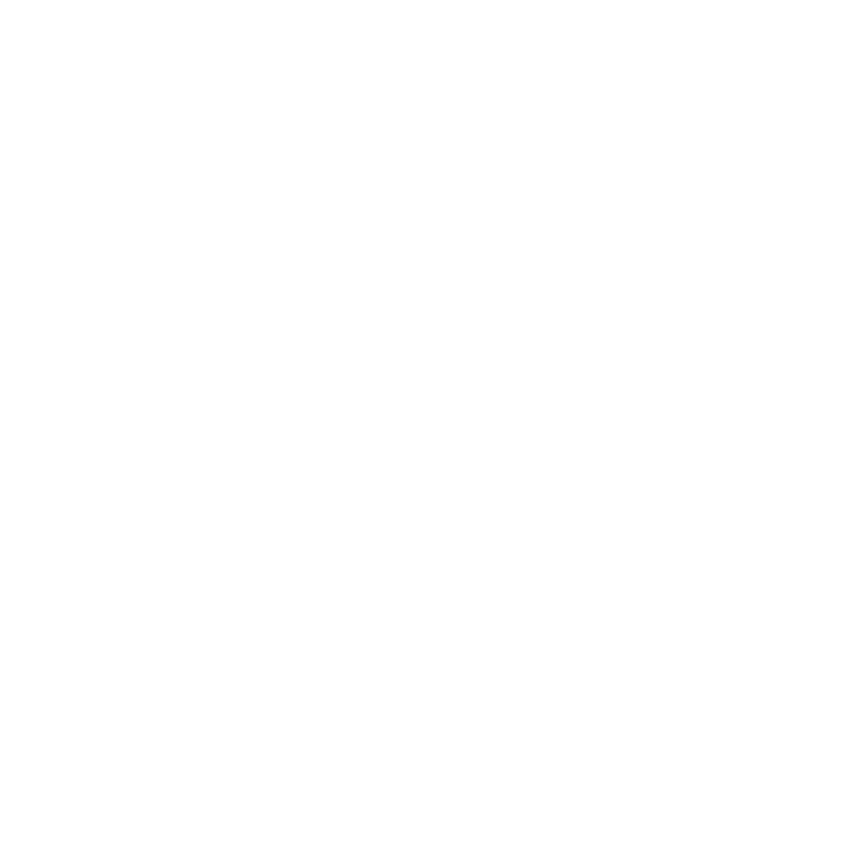

In [58]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 30
T_s = 60000
xi = 0.1
phi = 2 / 1001

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :]
in_sq = np.square(inputs)
in_norm_sq = np.sum(in_sq, axis=1)

for ep in range(Nep):

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Wow, even if I decrease $\phi$ a ton, it still to the same values.  I think that fuzzy nine is absorbing most of the more complicated shapes.  And yeah, there's very poor representation for shapes that simply have more activated pixels.  Adding the win rate term should hopefully fix that.  Ok, here's the classification.  

Actually wait.  First I'm going to increase $\xi$.

<IPython.core.display.Javascript object>


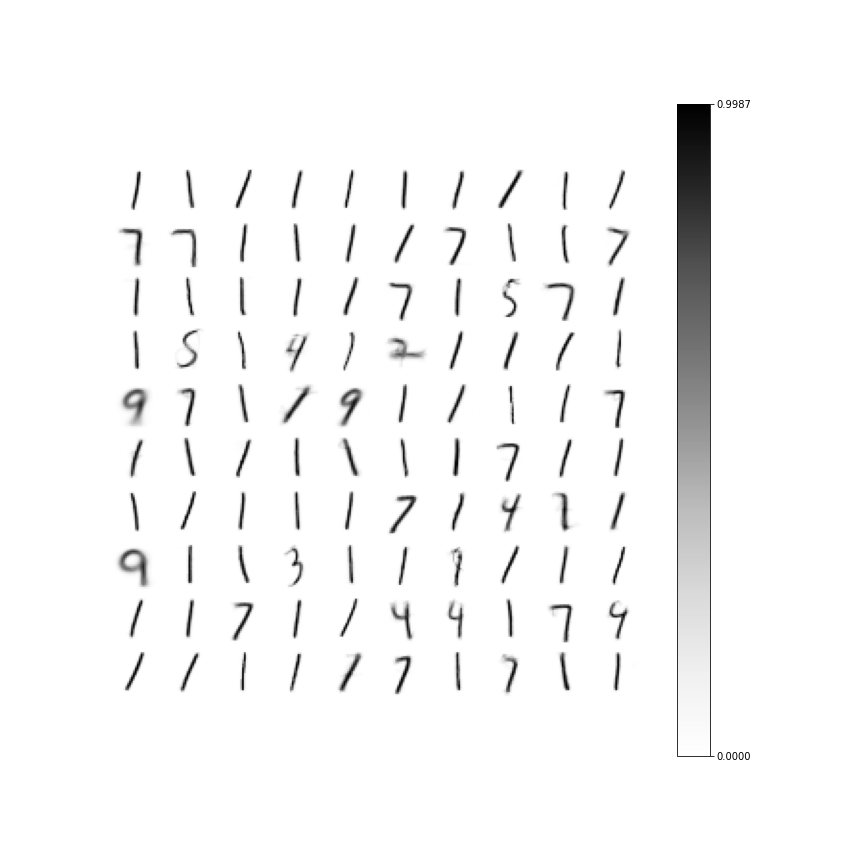

100%|██████████| 600/600 [00:00<00:00, 818.01it/s]


Max val:  0.6109675291543103 Min value:  0.4662016883345119 Mean val:  0.5481541038053946 Std:  0.024015635146446317
Elapsed time:  27.420759916305542  seconds


<IPython.core.display.Javascript object>


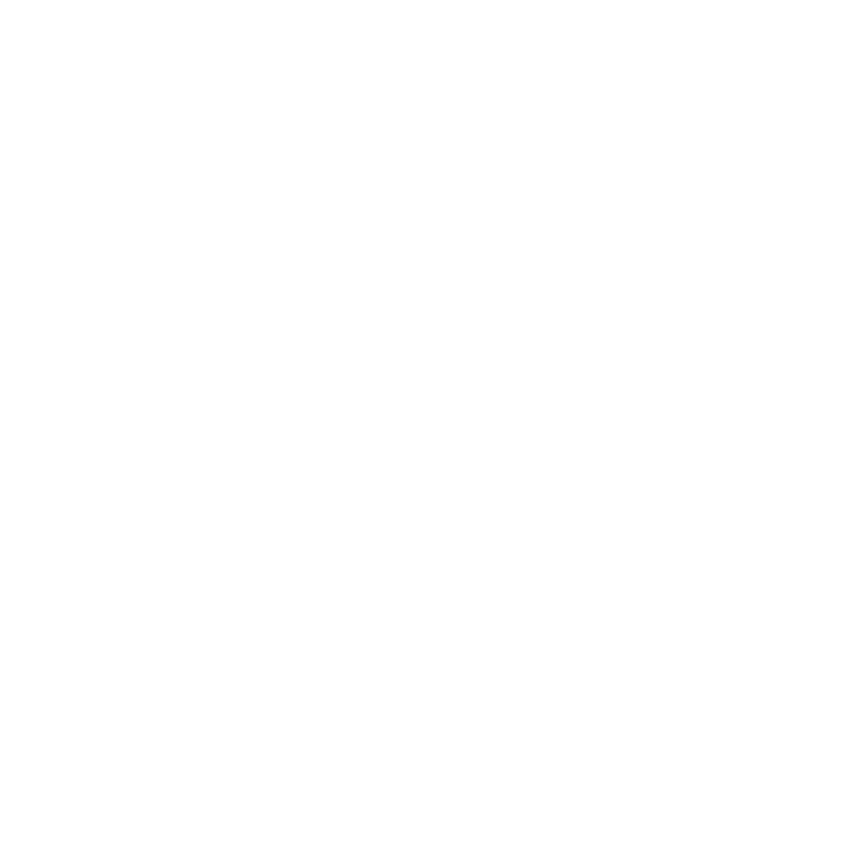

In [59]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 30
T_s = 60000
xi = 0.5
phi = 2 / 1001

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :]
in_sq = np.square(inputs)
in_norm_sq = np.sum(in_sq, axis=1)

for ep in range(Nep):

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Wow, a lot more ones.  Actually, that gives me an idea.  Time to decrease $\xi$ a bunch.

<IPython.core.display.Javascript object>


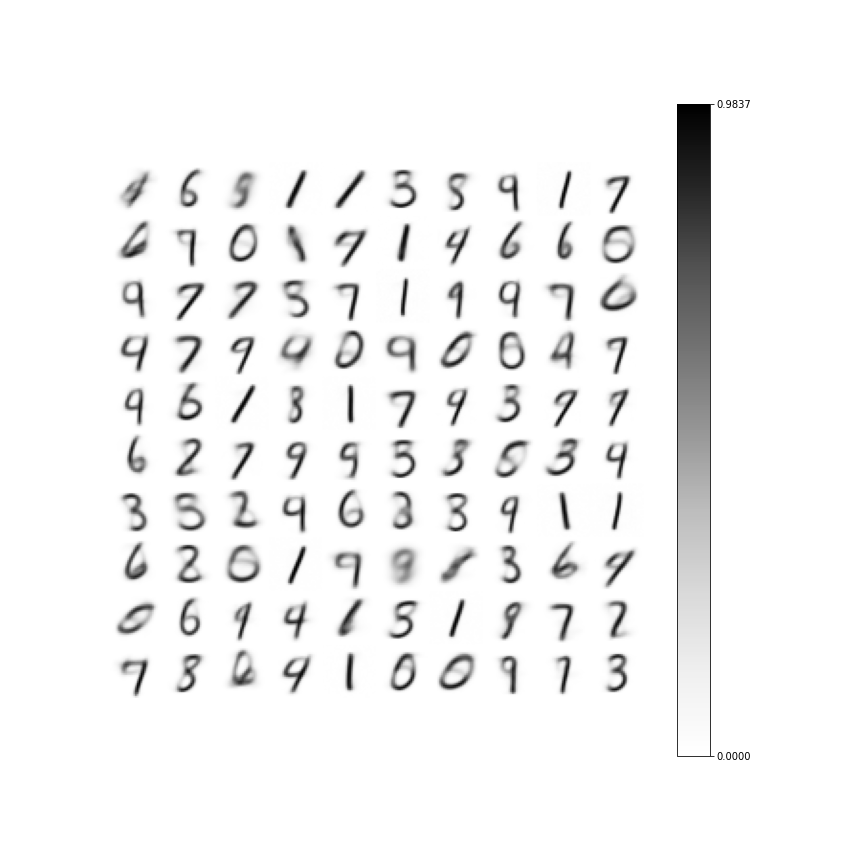

100%|██████████| 600/600 [00:00<00:00, 820.74it/s]


Max val:  0.603015309361165 Min value:  0.38795494544093867 Mean val:  0.5230595177129063 Std:  0.03246290355048572
Elapsed time:  9.666130065917969  seconds


<IPython.core.display.Javascript object>


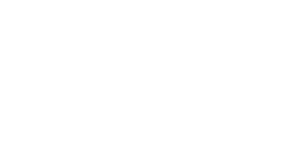

In [61]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.01
phi = 2 / 1001

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :]
in_sq = np.square(inputs)
in_norm_sq = np.sum(in_sq, axis=1)

for ep in range(Nep):

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (((1 - s) ** 2) + 0.1) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Ah-ha! That's interesting.  I'm now going to get rid of that $ + 0.1$ term lurking in the update step.

<IPython.core.display.Javascript object>


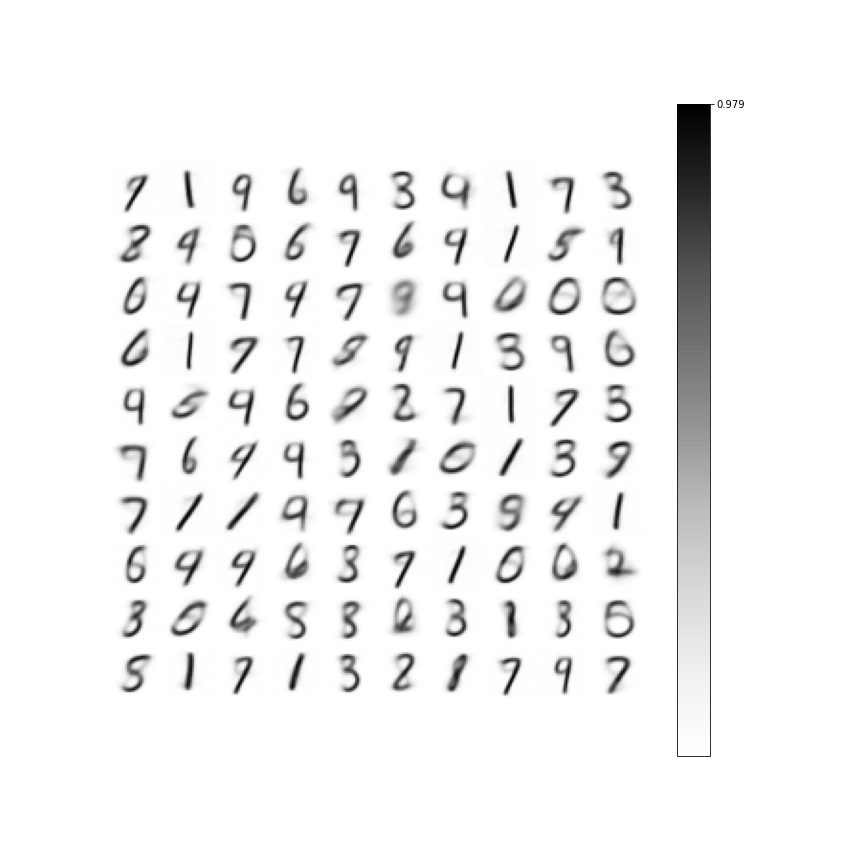

100%|██████████| 600/600 [00:00<00:00, 823.94it/s]


Max val:  0.5866164462966513 Min value:  0.37704836794452695 Mean val:  0.5197077093271353 Std:  0.03128651249329062
Elapsed time:  9.675539016723633  seconds


<IPython.core.display.Javascript object>


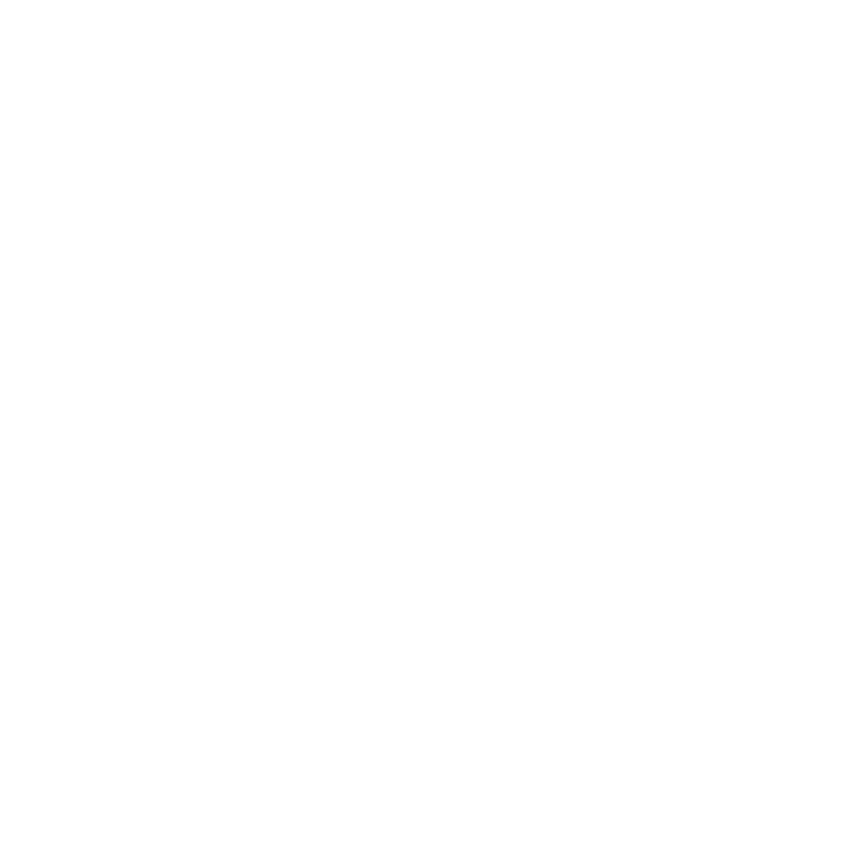

In [62]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.01
phi = 2 / 1001

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :]
in_sq = np.square(inputs)
in_norm_sq = np.sum(in_sq, axis=1)

for ep in range(Nep):

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * np.square(1 - s) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Ok, that's pretty good.  Let's try that with the classifier.  Wait first I need to try this with shuffled data.

<IPython.core.display.Javascript object>


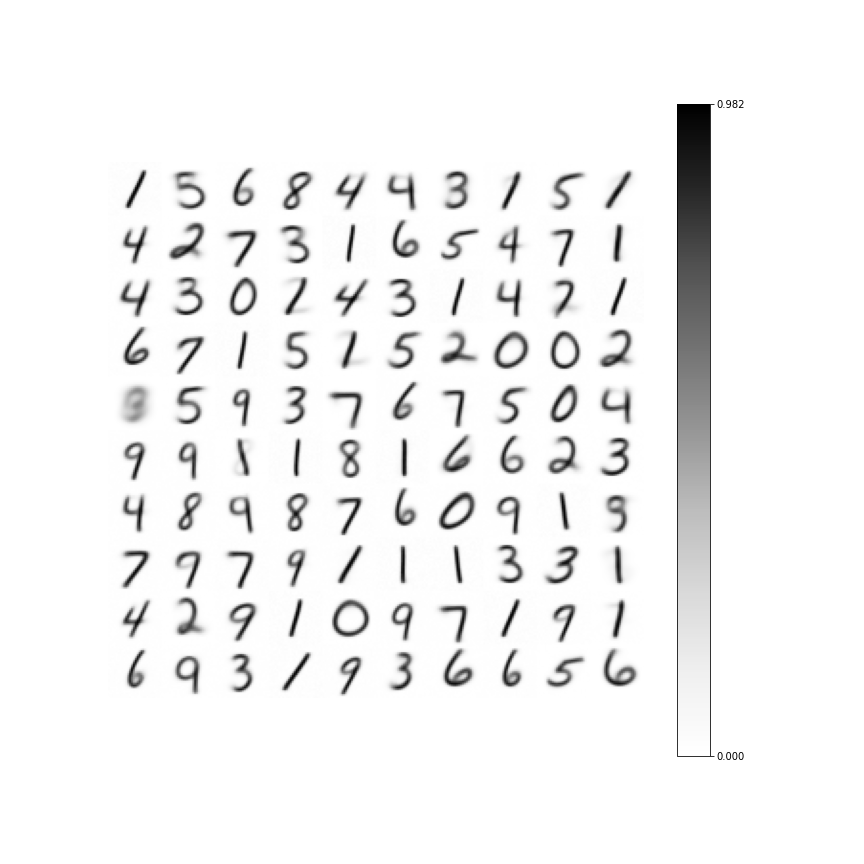

100%|██████████| 600/600 [00:00<00:00, 768.14it/s]


Max val:  0.6849832203132895 Min value:  0.3551605941917196 Mean val:  0.570078323147475 Std:  0.0566127530065274
Elapsed time:  13.549238204956055  seconds


<IPython.core.display.Javascript object>


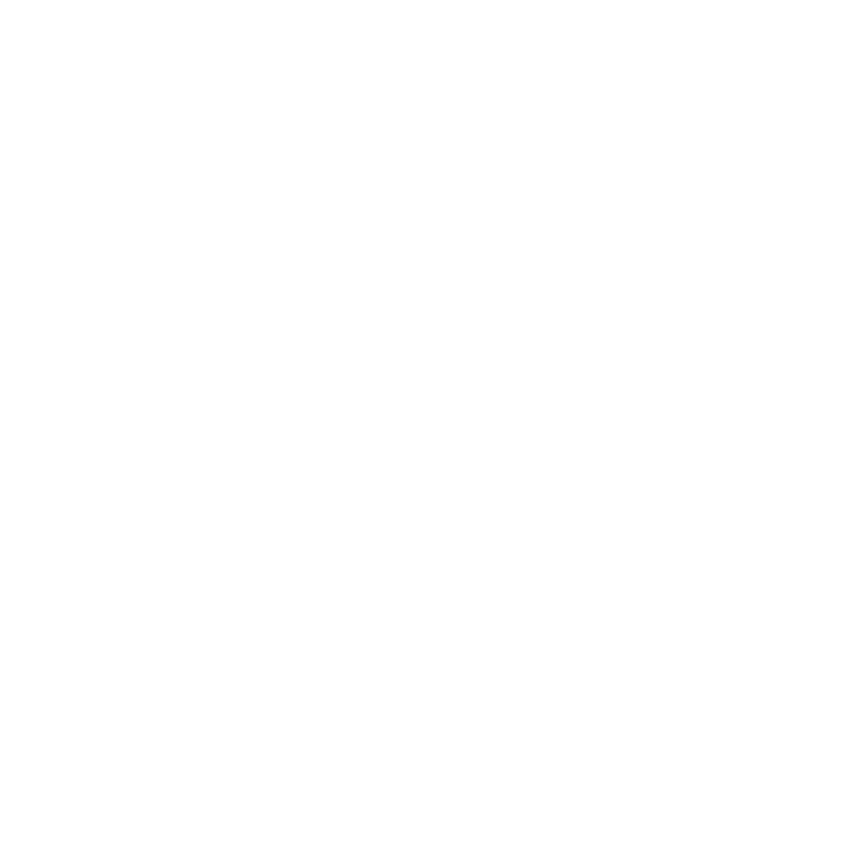

In [63]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.01
phi = 2 / 1001

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * np.square(1 - s) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Ok, it checks out.  I don't like that fuzzy three though.  

100%|██████████| 600/600 [00:00<00:00, 731.82it/s]


Max val:  1.1241752065220783 Min value:  0.3340263283443718 Mean val:  0.8757191159990181 Std:  0.11685713136332695
Elapsed time:  8.645175218582153  seconds


10000it [00:02, 3570.68it/s]


Misclassified inputs: [ 928. 1135. 1032. 1010.  982.  892.  958. 1028.   26. 1009.]
Model accuracy: 10.0


<Figure size 864x864 with 0 Axes>

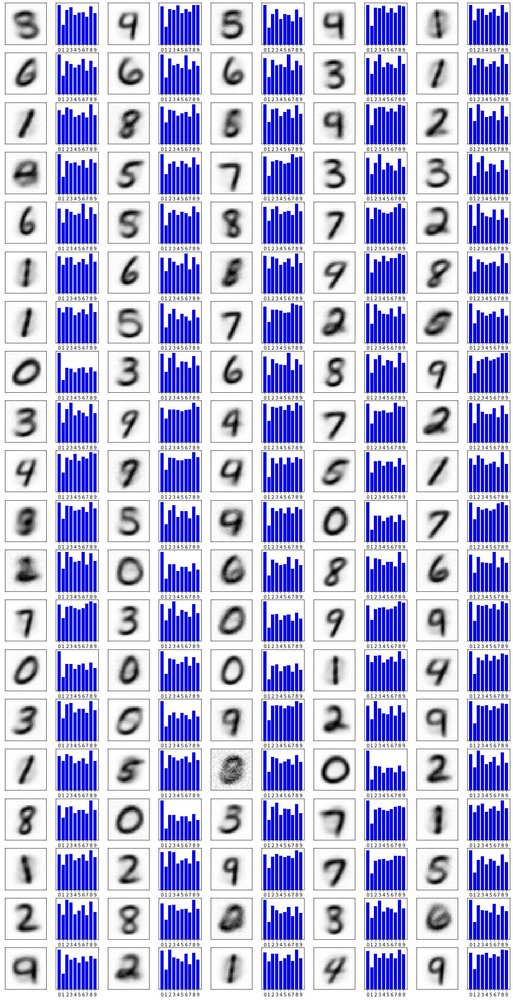

In [67]:
%matplotlib inline
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.01
phi = 2 / 1001

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x
in_sq = np.square(inputs)
in_norm = np.linalg.norm(inputs, axis=1)

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

for ep in range(Nep):
    for i in tqdm(range(T_s // B)):
        # Handle hidden layer
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * np.square(1 - s) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

        #Handle classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        v_sq_c = np.square(o)
        v_norm_sq_c = np.sum(v_sq_c, axis=0)

        wv_v_c = w_c @ v_sq_c

        wv_norm_c = np.sqrt(np.maximum(np.square(w_c) @ v_sq_c, prec))

        o_c = wv_v_c / v_norm_sq_c
        
        w_win_mask_c = np.zeros(10).reshape(-1, 1)
        w_win_mask_c[batch_wins] = 1
        
        w_win_c = w_c * w_win_mask_c

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - w_win_c) * np.square(1 - s_c) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

get_accuracy(w, w_c, flat_test, test_y)
plot_everything(w, w_c, 5, 20)

Yikes.  That's super not good.  Let's try this with a more brutal learning curve.

100%|██████████| 600/600 [00:00<00:00, 685.13it/s]


Max val:  0.6914581444090744 Min value:  0.354945261768588 Mean val:  0.588167651692495 Std:  0.06058303615768642
Elapsed time:  12.782597303390503  seconds


10000it [00:02, 3571.09it/s]


Misclassified inputs: [   6. 1135. 1032. 1010.  932.  892.  957. 1028.  974. 1009.]
Model accuracy: 10.25


<Figure size 864x864 with 0 Axes>

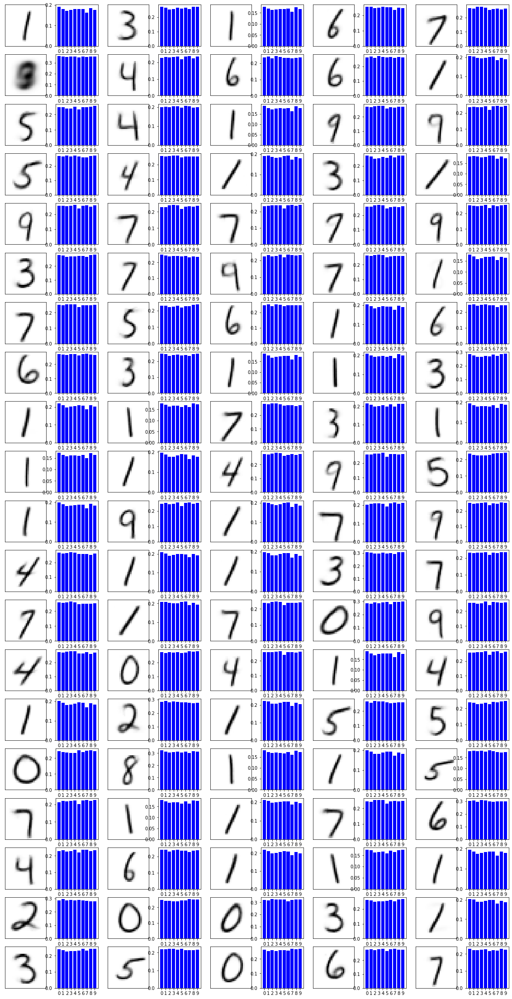

In [73]:
%matplotlib inline
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.random.uniform(0, 1, (10, N)) # synapses of each neuron
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        # Handle hidden layer
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = np.square(1 - s) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * np.square(1 - s) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

        #Handle classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        v_sq_c = np.square(o)
        v_norm_sq_c = np.sum(v_sq_c, axis=0)

        wv_v_c = w_c @ v_sq_c

        wv_norm_c = np.sqrt(np.maximum(np.square(w_c) @ v_sq_c, prec))

        o_c = wv_v_c / v_norm_sq_c
        
        w_win_mask_c = np.zeros(10).reshape(-1, 1)
        w_win_mask_c[batch_wins] = 1
        
        w_win_c = w_c * w_win_mask_c

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - w_win_c) * np.square(1 - s_c) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

get_accuracy(w, w_c, flat_test, test_y)
plot_everything(w, w_c, 5, 20)

Yikes. That ain't good.  I don't even know what to think.  

Actually I do.  This one layer shit clearly isn't working.  I think I need convolution to get an even reasonable classifier.  Bleh.  I kinda want to end the cookhouse now, but I really should try the win-rate term out first.  

But actually, first I'm going to mess with the learning curve.

<IPython.core.display.Javascript object>


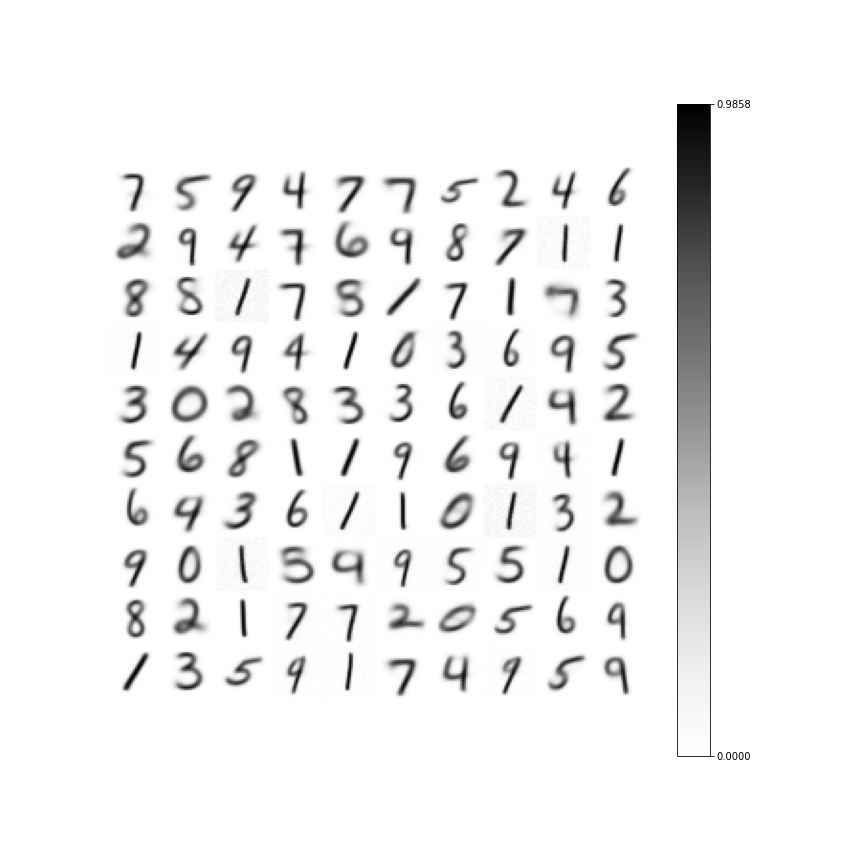

100%|██████████| 600/600 [00:00<00:00, 757.76it/s]


Max val:  0.8185393925388978 Min value:  0.4540776561720562 Mean val:  0.6132084470351138 Std:  0.07846530199956993
Elapsed time:  27.469709157943726  seconds


<IPython.core.display.Javascript object>


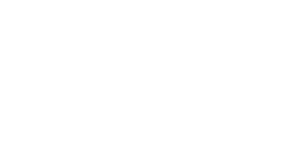

In [84]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 20
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01


B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

<IPython.core.display.Javascript object>


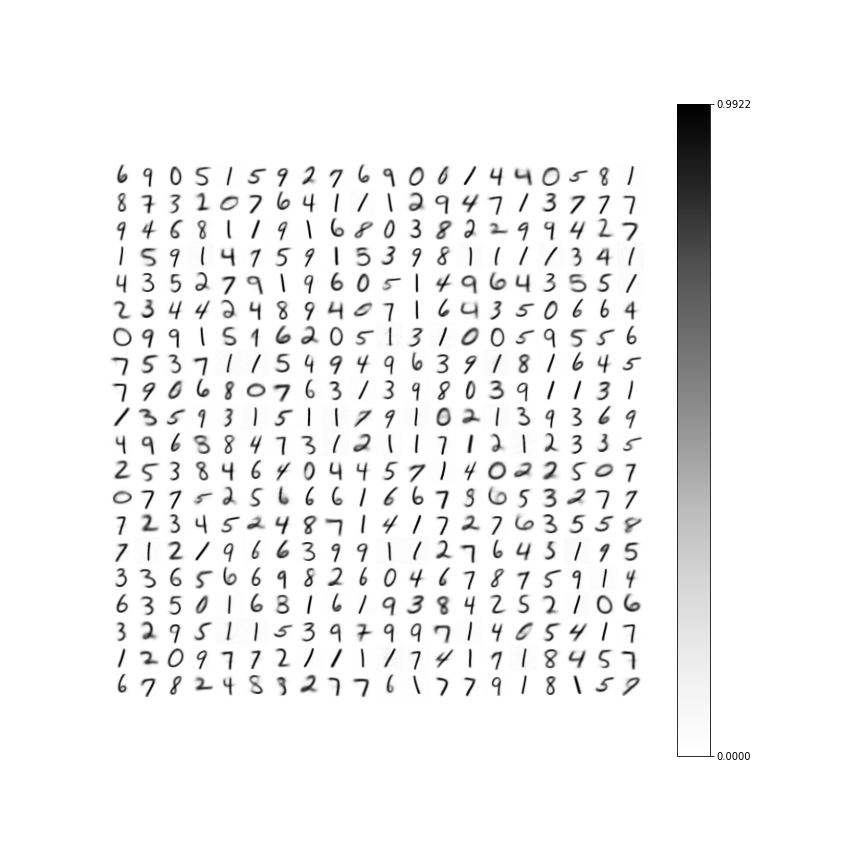

100%|██████████| 600/600 [00:05<00:00, 118.10it/s]


Max val:  0.7897913804930744 Min value:  0.21501518114960944 Mean val:  0.5051199119502815 Std:  0.11979545156638731
Elapsed time:  28.143455982208252  seconds


<IPython.core.display.Javascript object>


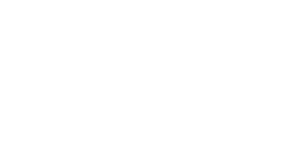

In [93]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.1


B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

Well, I think I found a way to get rid of the fuzzy threes.  Basically I'm using the exponential version of a learning curve, and making it so that only super low specialization experience a boost in competition value and and learning constant.  Another key is to keep $\phi$ low.  Otherwise, the neurons become specialized too quickly and then never learn.

Now, I am a bit nervous because it seems like if I let the network run for a very long time, a bunch of neurons tend toward 1.  Hmm.  Anyway, I'm going to run this through the classifier and see what happens.

100%|██████████| 600/600 [00:05<00:00, 106.35it/s]


Max val:  0.7941516062313322 Min value:  0.20523146619215563 Mean val:  0.5059761047578314 Std:  0.11721341383056345
Elapsed time:  30.047491788864136  seconds


10000it [00:16, 594.57it/s]


Misclassified inputs: [ 980. 1135. 1032. 1010.  982.  859.  958.   37.  974. 1009.]
Model accuracy: 10.24


<Figure size 864x864 with 0 Axes>

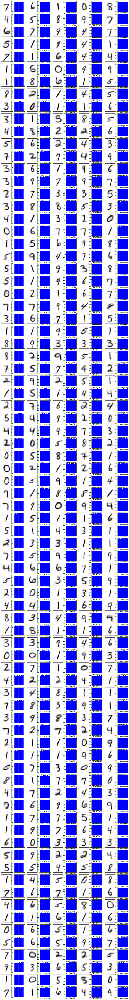

In [96]:
%matplotlib inline
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.1

B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.random.uniform(0, 1, (10, N)) # synapses of each neuron
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        # Handle hidden layer
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

        #Handle classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        v_sq_c = np.square(o)
        v_norm_sq_c = np.sum(v_sq_c, axis=0)

        wv_v_c = w_c @ v_sq_c

        wv_norm_c = np.sqrt(np.maximum(np.square(w_c) @ v_sq_c, prec))

        o_c = wv_v_c / v_norm_sq_c
        
        w_win_mask_c = np.zeros(10).reshape(-1, 1)
        w_win_mask_c[batch_wins] = 1
        
        w_win_c = w_c * w_win_mask_c

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - w_win_c) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

get_accuracy(w, w_c, flat_test, test_y)
plot_everything(w, w_c, 5, 80)

Well, I fucking hate that.  However, I'm going to bring the wta classification into play here and see what it has to say about these architectures.

In [104]:
def wta_classification(w, T_s):
    v = flat_x[:T_s]
    train_lbls = train_y[:T_s]
    
    v_sq = np.square(v).T
    v_norm_sq = np.sum(v_sq, axis=0)
    
    wins = np.argmax((w @ v_sq) / v_norm_sq, axis=0)
    
    n_wins = np.zeros((w.shape[0], 10))
    
    for (n_i, lbl) in zip(wins, train_lbls):
        n_wins[n_i][lbl] += 1
        
    n_cls = np.argmax(n_wins, axis=1)
    print("Neuron classes:", n_cls)
    
    num_test = test_y.shape[0]
    test_v = flat_test / np.array([np.linalg.norm(flat_test, axis=1)]).T
    t_v_sq = np.square(test_v)
    t_v_norm_sq = np.sum(t_v_sq, axis=1)
    
    num_correct = 0
    
    incorrect = np.zeros(10)
    
    for i in range(num_test):
        w_mul_v = (w @ t_v_sq[i].T) / t_v_norm_sq[i]
        
        n_max = np.argmax(w_mul_v)

        pre = n_cls[n_max]
        if pre == test_y[i]:
            num_correct += 1
        else:
            incorrect[test_y[i]] += 1
            
    print("Accuracy:", str(num_correct * 100 / num_test) + '%')
    print("Misclassifieds: ", incorrect)
        

In [105]:
wta_classification(w, T_s)

Neuron classes: [7 6 1 0 8 4 5 8 9 7 6 7 9 4 7 5 1 9 4 1 7 1 6 4 4 1 6 0 9 9 1 8 6 1 5 8 2
 1 4 5 3 0 1 1 6 3 1 5 8 5 4 8 2 2 6 5 6 2 4 3 7 2 7 4 9 3 6 1 1 6 3 9 7 9
 7 2 7 1 3 5 3 8 8 5 3 4 1 3 1 0 0 6 7 7 1 0 5 6 9 8 5 9 4 7 6 5 1 9 3 8 5
 1 9 6 7 0 2 1 6 7 7 7 9 4 8 3 6 7 0 5 0 1 9 5 1 8 9 3 3 3 8 2 9 5 1 7 5 7
 4 2 2 9 2 5 0 1 5 1 4 4 2 7 6 2 4 5 4 4 2 5 4 4 0 7 3 2 0 5 8 2 0 5 8 7 1
 0 2 1 2 6 0 5 9 0 4 7 1 8 8 1 7 9 0 9 4 1 5 0 1 6 5 0 4 3 1 2 3 3 1 1 7 5
 9 1 9 4 6 6 7 1 5 6 3 5 9 2 0 1 3 1 4 4 1 6 9 8 3 4 9 7 0 8 1 1 6 3 3 9 4
 6 0 0 1 9 3 2 7 0 0 7 4 2 2 4 1 3 4 8 1 1 7 8 3 9 0 3 9 8 3 7 7 2 7 2 4 2
 1 1 0 9 0 1 0 9 6 5 7 3 0 9 8 1 7 7 0 4 7 2 4 3 2 6 9 6 9 0 7 7 5 1 1 9 7
 6 4 6 0 3 3 3 5 9 2 2 4 5 5 4 5 8 1 4 5 0 8 7 6 7 0 6 4 6 5 8 0 1 1 6 1 6
 0 6 5 1 6 5 6 5 9 7 7 0 2 2 5 9 3 6 5 3 0 0 5 3 0 7 1 6 4 4]
Accuracy: 87.46%
Misclassifieds:  [  8.  45.  79. 144. 170. 207.  95. 132. 157. 217.]


Ok, here's 100 neurons.

<IPython.core.display.Javascript object>


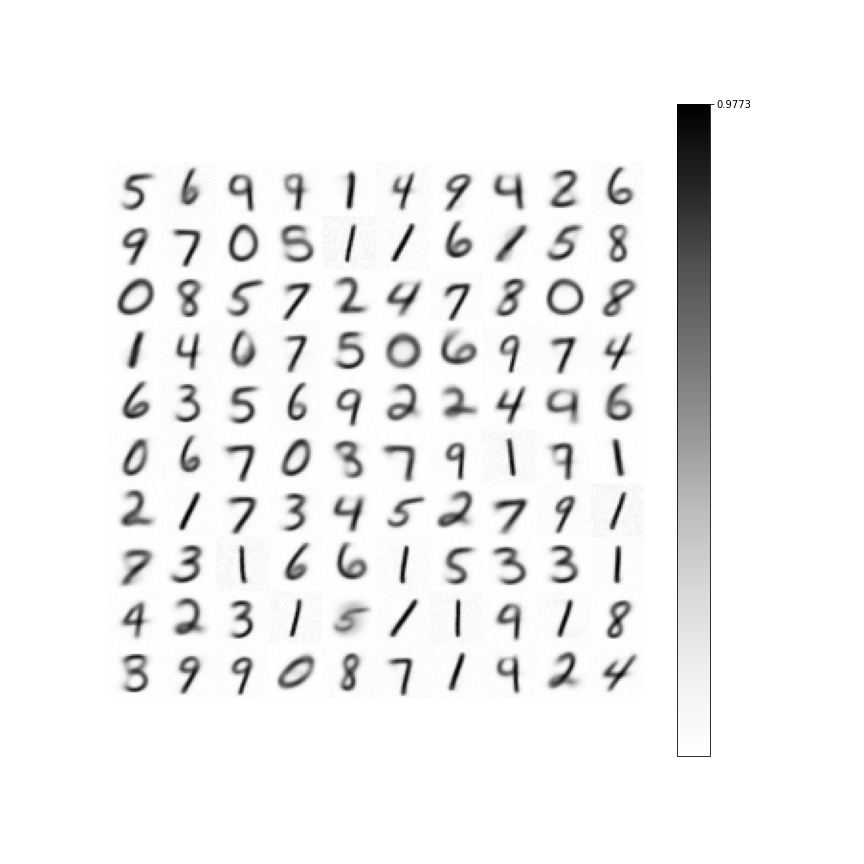

100%|██████████| 600/600 [00:00<00:00, 716.98it/s]


Max val:  0.7631265380860112 Min value:  0.39913719476995774 Mean val:  0.5828339344943964 Std:  0.0658329463811799
Elapsed time:  4.310556888580322  seconds
Neuron classes: [5 6 9 4 1 4 9 4 2 6 9 7 0 5 1 1 6 1 5 8 0 8 5 7 2 4 7 8 0 8 1 4 4 7 5 0 6
 9 7 4 6 3 5 6 9 2 2 4 4 6 0 6 7 0 3 7 9 1 7 1 2 1 7 3 4 5 2 7 9 0 7 3 1 6
 6 1 5 3 3 1 4 2 3 1 5 1 1 9 1 8 3 9 9 5 8 7 1 4 2 4]
Accuracy: 82.34%
Misclassifieds:  [ 75.  26.  98. 263. 275. 256.  88. 156. 280. 249.]


<IPython.core.display.Javascript object>


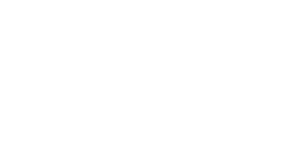

In [107]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 3
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01


B = 100 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

wta_classification(w, T_s)

Here's 400:

<IPython.core.display.Javascript object>


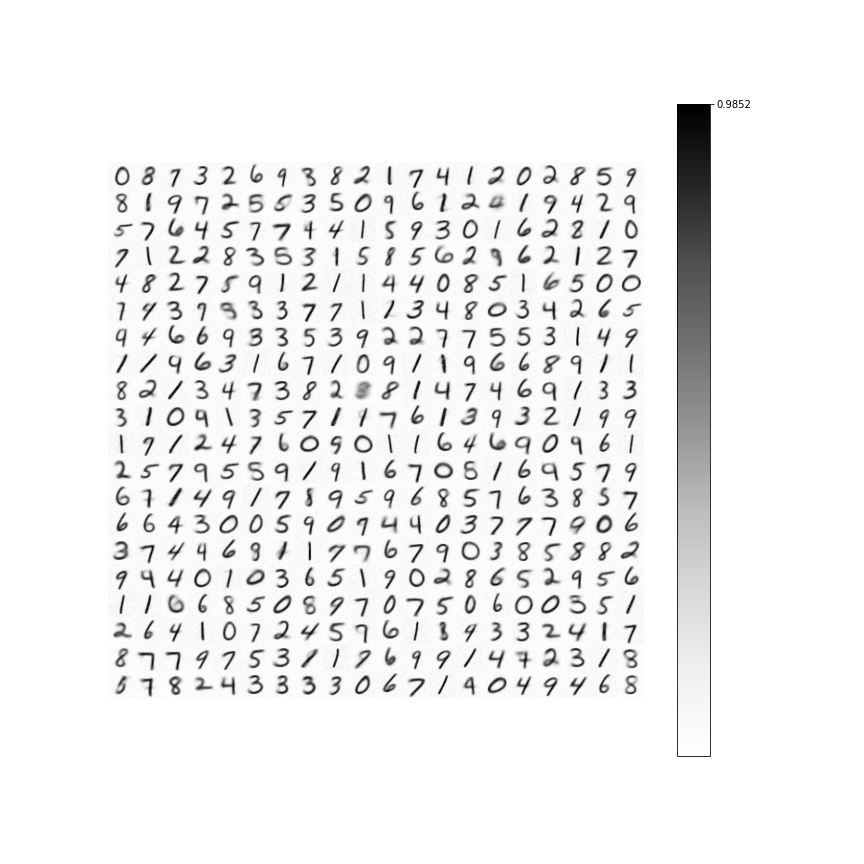

100%|██████████| 150/150 [00:02<00:00, 62.67it/s]


Max val:  0.5596549000440358 Min value:  0.29530899707879543 Mean val:  0.39861452112982065 Std:  0.04135990024651285
Elapsed time:  9.143854856491089  seconds
Neuron classes: [0 8 7 3 2 6 9 3 8 2 1 7 4 1 2 0 2 8 5 9 8 1 9 7 2 5 5 3 5 0 9 6 1 2 5 1 9
 4 2 9 5 7 6 4 5 7 7 4 4 1 5 9 3 0 0 6 2 8 1 0 7 1 2 2 8 3 5 3 1 5 8 5 6 2
 7 6 2 1 2 7 4 8 2 7 5 9 1 2 1 1 4 4 0 8 5 1 5 5 0 0 7 4 3 9 9 3 3 7 7 0 1
 3 4 8 0 3 4 2 6 5 4 4 6 6 9 3 3 5 3 9 2 2 7 7 5 5 3 1 4 9 1 1 4 6 3 0 6 7
 1 0 9 1 1 9 6 6 8 9 1 1 8 2 1 3 4 7 3 8 2 0 8 1 4 7 4 6 9 1 3 3 3 1 0 9 1
 3 5 7 1 1 7 6 1 3 9 3 2 1 9 9 1 7 1 2 4 7 6 0 9 0 1 1 6 4 6 9 0 9 6 0 2 5
 7 9 5 5 9 1 9 1 6 7 0 5 1 6 9 5 7 9 6 7 1 4 9 1 7 1 9 5 9 6 8 5 7 6 3 8 5
 7 6 6 4 3 0 0 5 9 5 7 4 4 0 3 7 7 7 9 0 6 3 7 4 4 6 9 1 1 7 7 6 7 9 0 3 8
 5 8 8 2 9 4 4 0 1 0 3 6 5 1 9 0 2 8 6 5 2 9 5 6 0 1 6 6 8 5 0 8 9 7 0 7 5
 0 6 0 0 3 5 1 2 6 4 1 0 7 2 4 5 7 6 1 1 4 3 3 2 4 1 7 8 7 7 9 7 5 3 1 1 7
 6 9 9 1 4 7 2 3 1 8 0 7 8 2 4 3 3 3 3 0 6 7 0 4 0 4 9 4 6 8]
Accuracy: 86

<IPython.core.display.Javascript object>


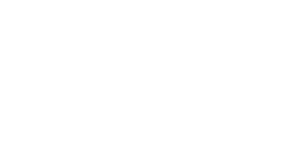

In [109]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 3
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01


B = 400 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

wta_classification(w, T_s)

Interestingly enough, I think that's more in-line with what Diehl's network got.  Let's try 1,600 and see what happens.

<IPython.core.display.Javascript object>


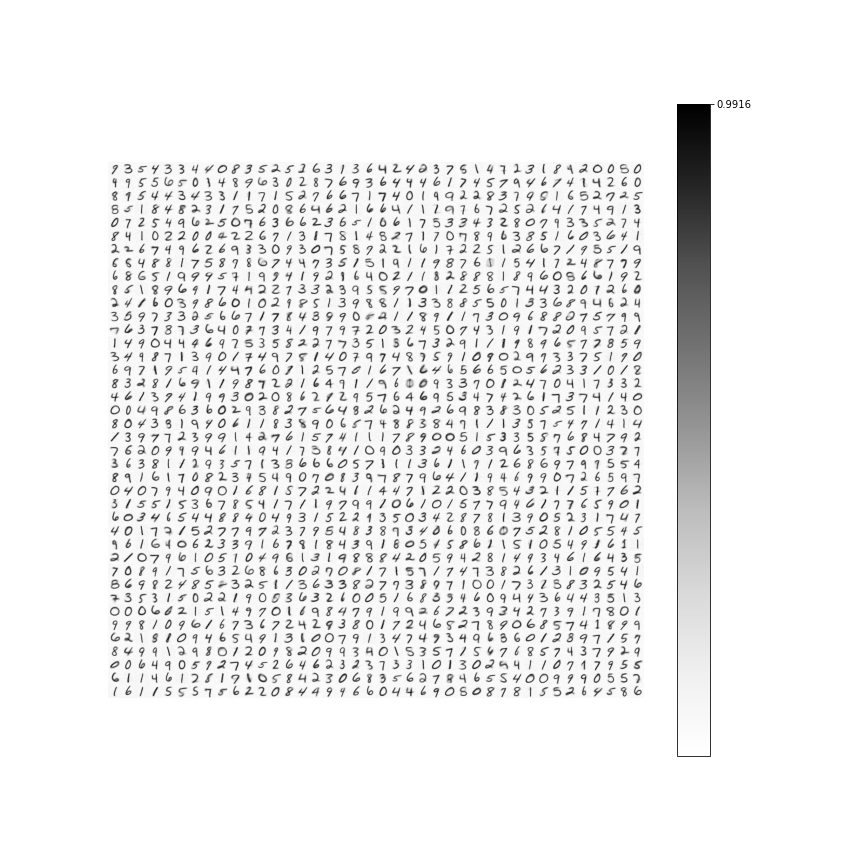

100%|██████████| 120/120 [00:08<00:00, 14.28it/s]


Max val:  0.23414586663549752 Min value:  0.1648498633330224 Mean val:  0.1944745173098733 Std:  0.010995940015297403
Elapsed time:  27.340909957885742  seconds
Neuron classes: [9 3 5 ... 5 8 6]
Accuracy: 88.67%
Misclassifieds:  [  9.  20.  96.  95. 216. 241.  75. 134. 133. 114.]


<IPython.core.display.Javascript object>


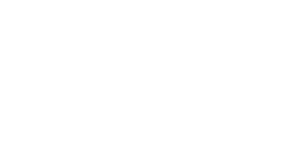

In [110]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 3
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01


B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.random.uniform(0, 1, (N, L)) # synapses of each neuron
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron

for ep in range(Nep):
    inputs = flat_x[np.random.permutation(S), :]
    in_sq = np.square(inputs)
    in_norm_sq = np.sum(in_sq, axis=1)
    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B]
        v_sq = in_sq[i * B: (i + 1) * B].T #Automatically transpose
        v_norm_sq = in_norm_sq[i * B: (i + 1) * B]

        wv_v = w @ v_sq

        o = wv_v / v_norm_sq

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)
        
        w_win_mask = np.zeros(N).reshape(-1, 1)
        w_win_mask[wins] = 1
        
        w_win = w * w_win_mask

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        v_update = win_mask @ v

        w += (v_update - w_win) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

wta_classification(w, T_s)

Interestingly enough, this is doing worse than the OG.  I wonder if I could rid of fuzzy threes using the exponential with the og.  I'm going to bring that back in now and see what I can get.  

In [111]:
def draw_weights(synapses, Kx, Ky):
    yy=0
    HM=np.zeros((28*Ky,28*Kx))
    for y in range(Ky):
        for x in range(Kx):
            HM[y*28:(y+1)*28,x*28:(x+1)*28]=synapses[yy,:].reshape(28,28)
            yy += 1
    plt.clf()
    nc=np.amax(np.absolute(HM))
    im=plt.imshow(HM,cmap='bwr',vmin=-nc,vmax=nc)
    fig.colorbar(im,ticks=[0, np.amax(HM)])
    plt.axis('off')
    fig.canvas.draw()   

In [112]:
def wta_classification(w, T_s):
    flat_x = np.reshape(train_X, [-1, L])
    flat_test = np.reshape(test_X, [-1, L])
    
    v = flat_x[:T_s]
    train_lbls = train_y[:T_s]
    
    v = v / np.array([np.linalg.norm(v, axis=1)]).T
    w = w / np.array([np.linalg.norm(w, axis=1)]).T
    
    wins = np.argmax(w @ (flat_x[:T_s, :]).T, axis=0)
    
    n_wins = np.zeros((w.shape[0], 10))
    
    for (n_i, lbl) in zip(wins, train_lbls):
        n_wins[n_i][lbl] += 1
        
    n_cls = np.argmax(n_wins, axis=1)
    print("Neuron classes:", n_cls)
    
    num_test = test_y.shape[0]
    test_v = flat_test / np.array([np.linalg.norm(flat_test, axis=1)]).T
    
    num_correct = 0
    
    incorrect = np.zeros(10)
    
    for i in range(num_test):
        w_mul_v = w @ test_v[i].T
        
        n_max = np.argmax(w_mul_v)
        
        pre = n_cls[n_max]
        if pre == test_y[i]:
            num_correct += 1
        else:
            incorrect[test_y[i]] += 1
            
    print("Accuracy:", str(num_correct * 100 / num_test) + '%')
    print("Misclassifieds: ", incorrect)
        

In [117]:
"""
flat_x: training data
S: Size of training set
L: Size of input
Kx: Num cols of neurons
Ky: Num rows of neurons
Nep: Num epochs
T_s: Number of training inputs
xi: Base learning constant
phi: Specialization ema constant
B: Batch size

zeta: Brutality of exponent
beta: giver of life lol

Returns: (synapse_weights, neuron specialization values)
"""
def run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta):
    start = time()
    N = Kx * Ky
    
    w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
    w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
    s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

    for ep in range(Nep):
        # Uncomment the following line if you'd like to shuffle the data between epochs
        inputs = flat_x[np.random.permutation(S), :].reshape(S, L)

        for i in tqdm(range(T_s // B)):
            v = inputs[i * B: (i + 1) * B, :]

            w_mul_v = w @ v.T 
            o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

            c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

            wins = np.argmax(c, axis=0)     

            win_mask = np.zeros((N, B))
            win_mask[wins, np.arange(B)] = 1
            win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

            win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

            v_update = win_mask @ v

            del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

            w += del_syn

            s[wins] *= (1 - phi)
            s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

        draw_weights(w, Kx, Ky)

    print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
    print("Elapsed time: ", time() - start, " seconds")
    
    return (w, s)

100%|██████████| 600/600 [00:00<00:00, 675.20it/s]


Max val:  0.6544333731942076 Min value:  0.487541741382574 Mean val:  0.5584824582297694 Std:  0.02695798858950118
Elapsed time:  1.1534087657928467  seconds



Neuron classes: [6 9 3 9 0 3 3 7 6 7 1 9 7 9 1 8 8 7 1 5 0 7 8 8 9 0 7 2 0 0 5 3 3 9 1 4 7
 1 4 9 3 3 7 9 1 9 0 1 1 9 0 4 0 1 0 6 4 3 2 7 8 8 1 9 2 9 5 6 2 5 7 2 6 5
 3 3 2 6 0 6 7 4 6 1 8 1 7 5 1 4 0 6 9 2 4 6 4 0 1 0]
Accuracy: 87.97%
Misclassifieds:  [ 17.  15. 117. 143. 238. 217.  48. 119. 192.  97.]


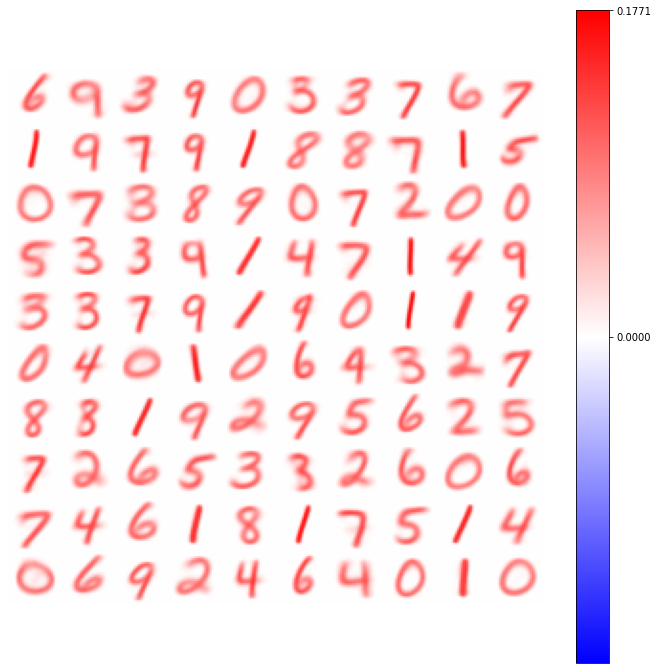

In [124]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01

B = 100 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Holy shit.  That just got a wta accuracy of 88% after one epoch.  That's unreal.  After running it a couple times, it looks like it's getting between 85-88%.  Holy fucking shit.  Let's try 400 neurons.  

Actually wait.  First I'm going to run it with like 5 epochs and see what the average wta is.

100%|██████████| 600/600 [00:00<00:00, 675.99it/s]


Max val:  0.9257677264635291 Min value:  0.7329047111744216 Mean val:  0.8324822543854477 Std:  0.04444720093233434
Elapsed time:  5.884128570556641  seconds



Neuron classes: [2 6 3 1 3 0 4 9 9 8 5 6 0 7 9 7 9 0 1 9 6 7 4 5 4 3 5 7 8 0 6 7 5 6 1 3 9
 2 9 7 2 1 2 1 1 7 0 1 6 8 5 0 1 1 1 0 3 0 6 1 2 7 0 8 1 1 9 6 7 4 4 7 9 1
 0 1 3 4 9 9 6 5 3 1 3 3 8 0 5 7 1 1 5 6 2 4 7 2 8 0]
Accuracy: 88.83%
Misclassifieds:  [ 23.  10. 115. 105. 296. 126.  32. 110. 175. 125.]


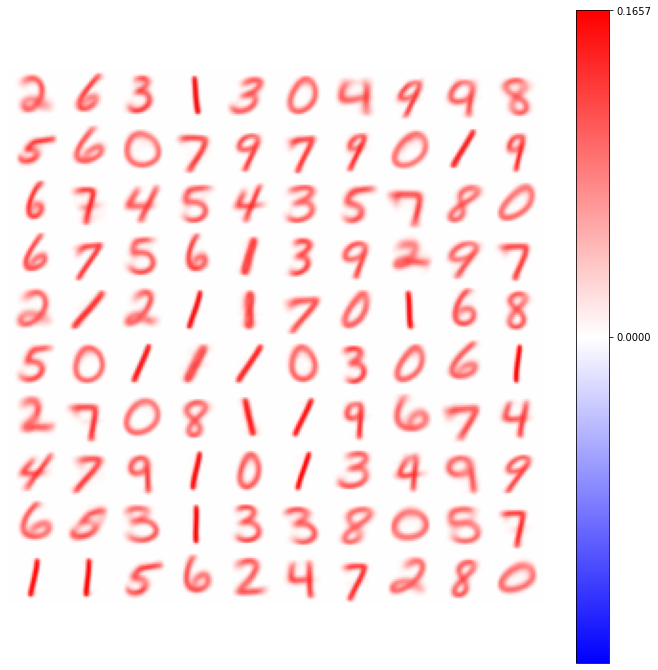

In [127]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01

B = 100 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Holy shit.  It's like 88-89%.  Wait, I'm going to try it with 10 neurons.

100%|██████████| 1200/1200 [00:00<00:00, 2565.48it/s]


Max val:  0.8414812005423284 Min value:  0.7082903914530336 Mean val:  0.7557956049423253 Std:  0.04011008115218573
Elapsed time:  3.707052230834961  seconds



Neuron classes: [4 8 1 1 3 7 2 1 0 6]
Accuracy: 59.63%
Misclassifieds:  [ 153.   10.  275.  260.  441.  892.  145.  401.  451. 1009.]


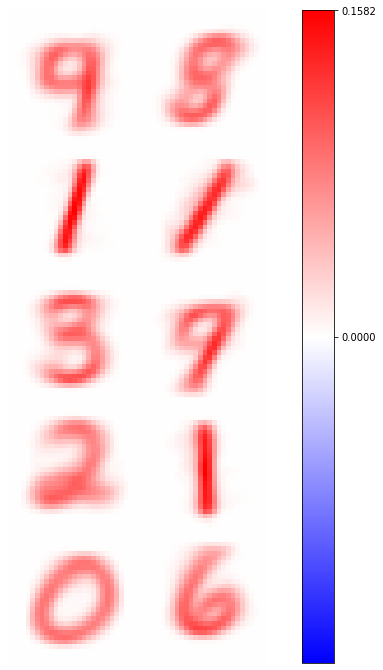

In [128]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 2
Ky = 5
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01

B = 50 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Wow that's kinda wild.  It just got 60% accuracy with only 10 neurons.  Ok, now let's do 400.  One epoch first.

100%|██████████| 150/150 [00:02<00:00, 50.56it/s]


Max val:  0.15430513840408477 Min value:  0.0 Mean val:  0.04309965310160502 Std:  0.04529995325173014
Elapsed time:  3.2552928924560547  seconds



Neuron classes: [0 3 0 5 2 3 0 0 6 0 0 6 2 0 0 0 0 0 0 0 3 9 5 6 2 9 2 0 0 0 9 0 0 7 4 8 9
 0 0 0 0 0 0 9 0 0 1 0 1 0 4 0 0 0 0 0 9 0 0 9 1 0 7 2 0 5 0 0 0 0 7 2 0 4
 0 0 2 0 0 3 0 0 0 3 3 0 8 0 0 0 2 0 5 1 8 0 3 0 4 6 5 6 0 9 0 1 0 0 3 0 0
 5 9 3 0 0 6 0 0 0 0 6 0 0 4 3 0 1 0 0 4 0 7 1 3 7 0 0 8 0 9 0 0 2 0 0 0 6
 7 5 3 0 7 0 0 0 4 7 6 9 3 1 8 9 2 0 4 0 0 5 3 0 0 0 0 0 8 7 0 8 0 7 0 6 2
 0 0 6 0 0 3 1 3 0 0 0 1 0 0 0 1 0 0 3 0 0 6 3 6 0 3 0 1 0 8 0 9 1 0 7 0 5
 8 0 0 0 0 9 0 0 0 0 0 0 9 0 3 1 0 0 0 5 9 1 0 3 7 4 2 7 0 1 3 0 4 0 0 0 0
 9 0 7 0 0 2 5 0 0 0 0 7 1 0 1 9 7 0 0 0 0 0 2 7 0 2 0 4 1 0 7 0 3 0 5 0 3
 3 5 0 0 6 0 9 0 2 0 3 0 0 0 4 0 1 0 0 9 6 0 0 1 0 0 8 0 9 6 0 8 0 7 0 0 0
 0 0 0 5 3 0 0 0 0 0 9 0 0 0 6 2 0 0 3 0 0 0 9 0 0 9 0 7 0 0 0 0 0 0 4 0 7
 3 0 0 7 0 0 0 0 0 0 6 0 0 0 0 0 6 9 0 2 1 0 0 0 9 6 1 0 0 8]
Accuracy: 85.78%
Miscla

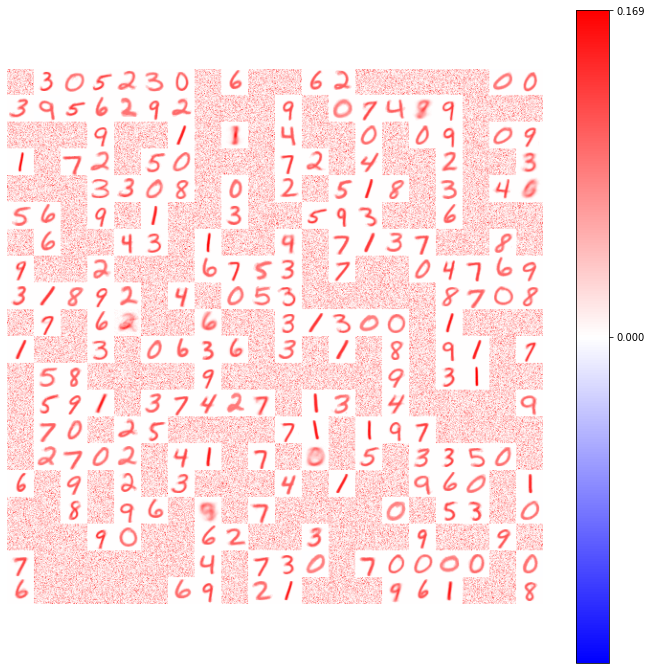

In [130]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 20
beta = 0.01

B = 400 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Oh, that's interesting.  I'll make zeta more brutal.

100%|██████████| 150/150 [00:02<00:00, 51.55it/s]


Max val:  0.08183147340751414 Min value:  0.0 Mean val:  0.04058595996138036 Std:  0.01818269531732379
Elapsed time:  3.201160192489624  seconds



Neuron classes: [5 0 9 6 9 0 9 2 5 5 8 6 3 2 6 7 7 2 6 9 1 0 8 2 6 9 4 3 9 3 9 0 0 0 1 5 3
 4 0 0 0 3 9 4 0 0 6 9 6 8 6 8 6 0 6 6 7 9 0 4 0 7 0 7 8 8 0 3 0 7 3 3 6 0
 3 6 4 0 7 0 0 2 4 0 6 7 3 0 5 1 6 3 8 3 0 7 1 1 3 0 8 8 9 9 3 6 0 5 0 1 0
 4 7 7 8 2 8 7 9 9 9 3 9 5 6 4 0 0 1 0 0 8 7 6 8 3 8 0 2 2 0 2 8 1 6 8 1 8
 4 1 0 0 3 4 0 0 3 2 0 4 1 5 3 9 3 0 0 9 7 2 0 6 1 5 5 3 9 3 2 7 7 0 8 9 3
 0 9 0 6 0 2 3 1 2 0 3 0 1 0 6 0 9 6 9 5 9 1 3 6 0 2 3 1 2 9 0 6 6 9 4 0 3
 8 2 8 1 1 1 2 0 0 6 6 1 9 1 8 6 9 4 5 5 6 0 4 6 5 9 0 0 0 1 9 1 8 9 7 4 6
 0 0 5 6 3 0 0 6 0 1 9 1 4 0 9 2 4 4 7 3 5 4 2 6 0 0 2 3 2 6 3 9 4 0 0 7 7
 1 8 2 3 7 7 9 2 0 0 0 2 1 1 8 0 2 0 4 7 9 7 9 0 1 9 1 0 9 0 3 6 0 6 0 8 3
 7 4 6 0 6 5 9 7 9 7 2 1 6 5 2 1 1 0 7 0 8 2 5 9 9 2 8 0 3 7 2 0 0 6 7 4 0
 7 0 0 0 3 9 8 0 7 0 0 6 8 8 6 2 1 1 3 4 0 6 7 9 5 8 3 0 3 4]
Accuracy: 88.57%
Misclas

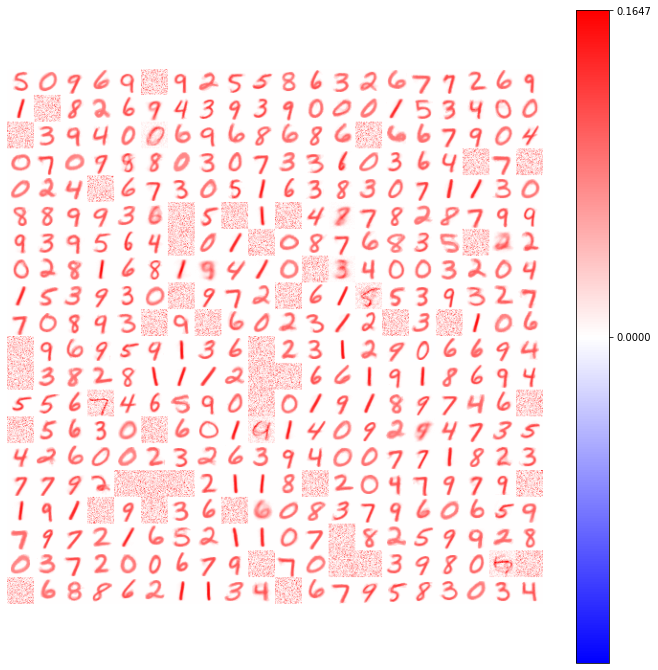

In [131]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 40
beta = 0.01

B = 400 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Oh wait, that's not it.  I think I should mess with phi.  Let's see.

100%|██████████| 150/150 [00:02<00:00, 51.24it/s]


Max val:  0.3025149987154671 Min value:  0.09755401350130881 Mean val:  0.1554048480019671 Std:  0.02870838864459737
Elapsed time:  3.250308036804199  seconds



Neuron classes: [1 4 3 8 5 7 5 8 3 9 2 1 1 8 9 7 4 1 9 0 0 9 7 4 2 0 1 7 1 7 5 8 2 6 5 8 3
 4 6 2 9 7 2 1 7 8 6 5 8 4 2 4 2 4 8 2 3 5 2 7 9 7 4 8 8 8 8 9 4 3 3 4 7 3
 2 4 4 5 4 8 0 2 0 0 0 7 2 3 2 1 6 9 3 1 6 6 9 2 6 9 5 6 7 2 6 3 6 0 6 6 9
 1 3 1 1 7 7 2 7 2 0 4 0 9 6 0 8 3 3 7 7 6 4 2 3 1 5 4 0 6 2 1 4 4 0 8 2 1
 9 1 3 6 8 6 5 1 2 9 3 8 4 0 6 6 0 5 3 5 7 0 8 8 1 9 7 4 6 4 9 0 4 6 9 7 0
 1 1 3 5 6 6 0 2 7 8 9 1 9 5 7 5 5 9 5 9 0 8 7 0 2 4 3 7 1 4 9 0 5 0 0 1 4
 0 3 6 4 9 6 3 5 0 0 1 0 3 2 4 3 9 6 0 9 0 1 7 0 7 6 3 8 3 4 9 8 2 0 2 0 0
 0 3 0 0 0 3 2 3 2 0 8 0 3 6 3 3 2 1 4 9 2 9 8 4 0 7 4 0 3 2 3 6 6 3 7 9 6
 7 9 6 6 5 8 0 1 8 7 5 0 5 4 1 0 0 1 2 9 7 4 9 5 7 7 6 2 2 0 6 9 7 3 7 8 6
 0 0 5 2 2 9 2 9 1 9 4 0 5 6 0 2 3 3 8 3 0 0 7 4 6 6 0 6 0 0 9 7 2 6 1 1 5
 6 9 8 3 4 8 3 9 7 7 7 2 3 9 0 9 3 8 7 6 6 8 4 6 7 4 5 1 0 2]
Accuracy: 

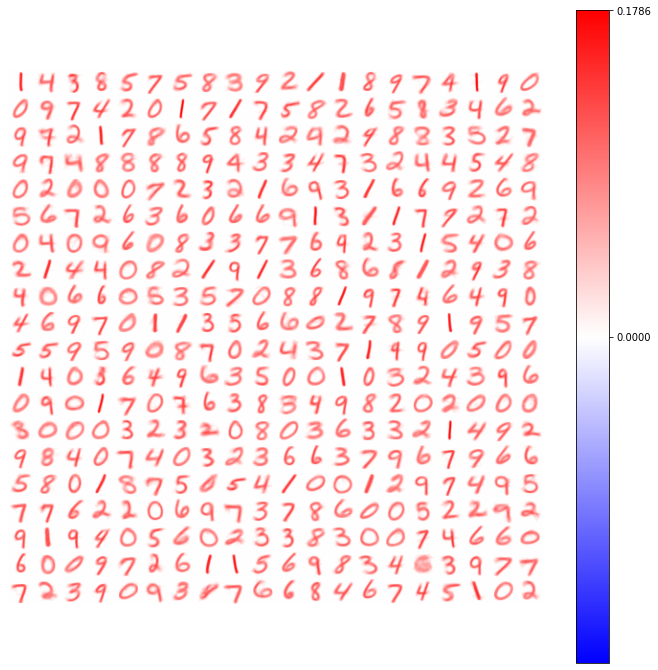

In [136]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 400 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Ah-ha.  The neuron specializations weren't updating as quickly, so bumped zeta up a bunch.  Also, to make sure that the network is still learning after it crosses the specialization threshold, I bumped up beta as well.  The result?  The network is getting like 92.6% accuracy.  That's dog-shit wild.  That value has been pretty consistent, so I don't think it's going to change much with epochs, but here's the same set-up with 5 epochs.

100%|██████████| 120/120 [00:02<00:00, 44.39it/s]


Max val:  0.8159235598997435 Min value:  0.48590440384267963 Mean val:  0.6561371620412056 Std:  0.05613054313136596
Elapsed time:  15.133443117141724  seconds



Neuron classes: [4 1 0 7 9 6 0 2 2 9 0 6 9 1 8 0 7 4 8 4 3 5 5 0 7 6 3 6 3 0 7 4 4 9 6 0 3
 7 5 0 0 7 0 4 5 1 9 5 3 4 8 2 2 6 4 0 1 2 1 2 2 6 0 3 0 3 6 7 0 2 7 4 9 8
 2 7 9 8 7 2 2 1 0 1 9 7 8 2 6 7 0 3 9 6 1 5 1 0 0 3 6 0 4 1 3 0 1 6 4 8 3
 0 5 1 9 8 9 4 2 5 8 7 4 2 6 9 1 0 3 1 9 7 8 2 8 7 2 0 9 5 6 8 7 1 0 8 0 3
 6 0 7 5 1 4 7 5 3 6 2 4 1 2 4 2 0 5 3 3 0 1 1 7 2 7 4 1 5 0 9 6 4 2 0 9 0
 3 3 1 8 2 7 9 7 9 6 0 4 3 2 8 0 5 5 9 1 9 8 6 5 2 1 6 5 3 8 2 0 6 3 4 2 2
 6 8 2 9 0 3 2 7 3 9 0 4 7 6 9 4 5 9 3 0 9 5 0 3 2 7 6 0 5 1 5 2 6 4 9 2 0
 4 8 0 5 8 8 0 8 7 4 4 2 1 9 6 3 9 4 0 6 9 0 9 1 3 6 5 5 6 5 0 5 7 1 5 1 8
 3 4 9 7 6 6 6 0 9 6 6 5 6 3 4 4 1 6 2 0 9 8 2 4 4 5 7 9 3 4 9 1 7 1 3 5 0
 7 3 4 1 0 9 5 1 1 3 8 7 8 7 7 6 2 1 8 6 8 3 8 6 9 7 6 4 2 4 5 7 3 3 7 6 0
 9 2 4 7 7 4 0 7 3 8 7 8 6 8 4 5 8 3 5 6 0 7 2 9 1 5 3 4 3 9]
Accuracy:

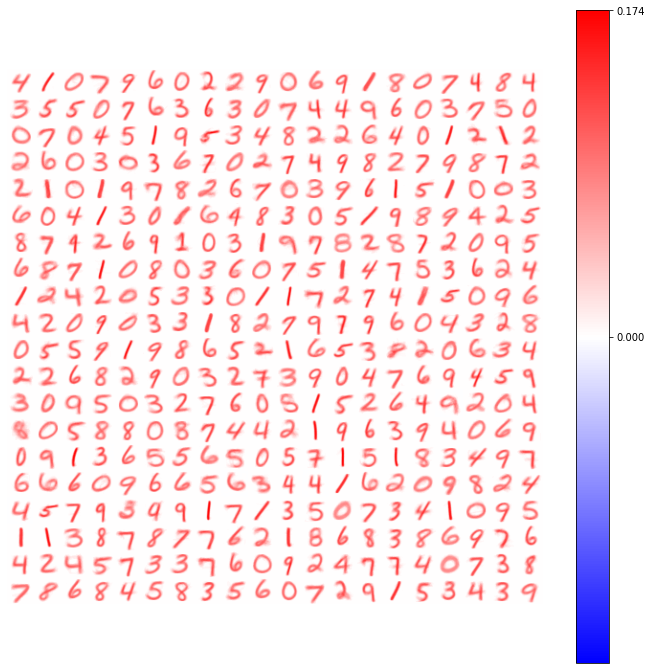

In [143]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Well, I was wrong.  It got waaay better.  It's like at 94% accuracy now.  Holy fucking shit.  That's almost as good as Diehl's 6,400 neuron network.  I gotta try 10 epochs.

100%|██████████| 120/120 [00:02<00:00, 44.42it/s]


Max val:  0.9237289931162666 Min value:  0.6768546125387069 Mean val:  0.8108900452684833 Std:  0.04363173547686677
Elapsed time:  30.038570165634155  seconds



Neuron classes: [3 6 9 3 2 6 5 6 0 6 2 5 6 5 5 3 2 0 6 1 6 9 8 0 3 1 3 2 4 6 4 2 0 0 3 8 7
 7 9 2 7 9 1 9 3 5 7 2 0 7 5 4 7 9 7 8 6 0 4 7 6 7 3 4 4 0 8 5 9 3 0 1 5 6
 6 3 7 9 6 1 9 1 1 6 9 0 9 8 7 6 6 2 4 6 7 2 9 8 0 8 4 5 4 5 6 1 9 8 3 7 9
 5 0 0 1 0 3 7 8 2 8 2 5 0 6 8 5 6 4 9 6 3 4 9 7 1 4 1 5 2 7 8 4 5 1 3 2 8
 2 5 7 0 0 6 0 8 0 8 9 8 1 2 6 2 3 0 4 9 5 3 5 8 9 3 3 9 4 0 5 2 5 9 3 2 1
 6 7 9 6 3 1 9 0 8 3 4 2 9 2 0 6 2 5 4 8 9 7 2 1 9 3 9 1 4 1 0 3 0 0 2 0 7
 5 5 3 4 2 7 6 4 6 6 9 8 0 0 9 2 4 4 4 0 2 8 2 8 6 6 7 6 7 4 6 2 9 6 2 6 7
 8 1 1 7 6 7 5 3 8 0 0 7 0 0 5 7 8 2 2 9 4 8 2 6 7 0 2 8 2 6 5 6 0 0 9 2 7
 7 7 7 5 0 3 1 4 8 8 3 7 0 5 1 0 9 6 0 0 2 3 0 9 3 4 3 1 1 9 0 8 7 0 1 0 8
 9 4 0 8 7 3 0 2 7 1 4 0 5 9 4 3 0 3 0 8 9 5 3 4 5 6 6 2 7 8 5 2 0 7 9 0 9
 8 3 3 8 6 7 1 2 1 6 4 0 3 1 4 1 0 3 3 1 4 1 4 9 2 0 6 1 6 7]
Accuracy: 

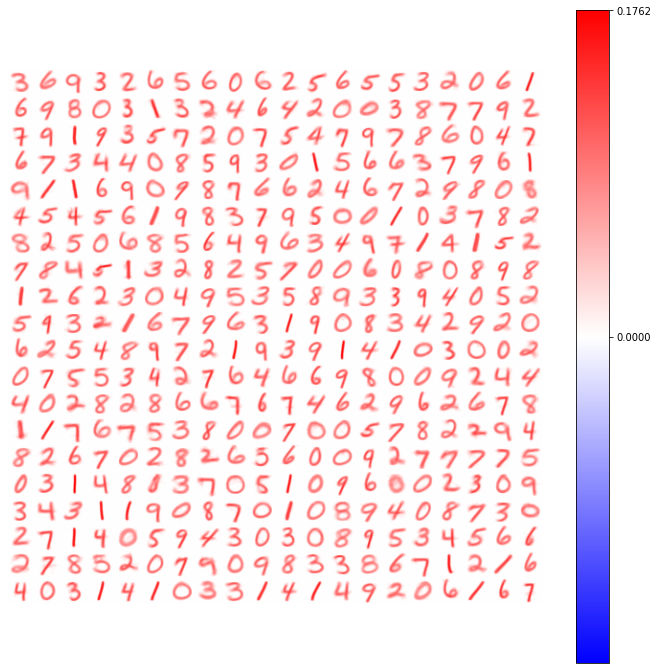

In [144]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Ok, so it's sitting at around 93.6% accuracy.  That's incredibly good.  Holy fucking shit.  I'm going to try the 100 neuron network with these settings as well, see what happens.

100%|██████████| 120/120 [00:00<00:00, 218.37it/s]


Max val:  0.34334766050328763 Min value:  0.2332938738130826 Mean val:  0.2806399279618855 Std:  0.01834565284016581
Elapsed time:  0.8168132305145264  seconds



Neuron classes: [4 3 6 0 1 6 6 9 0 6 1 7 9 4 2 6 0 2 0 7 7 2 1 4 5 7 1 8 0 0 7 1 5 3 2 4 0
 3 2 5 1 9 0 8 3 4 1 8 9 6 0 5 3 3 4 9 0 2 0 8 6 6 0 6 7 8 9 1 3 9 9 5 7 4
 1 5 6 8 3 6 3 0 1 8 4 9 9 7 2 5 9 0 9 7 8 9 4 2 3 8]
Accuracy: 88.16%
Misclassifieds:  [ 14.   9. 113. 109. 327. 205.  36. 140. 132.  99.]


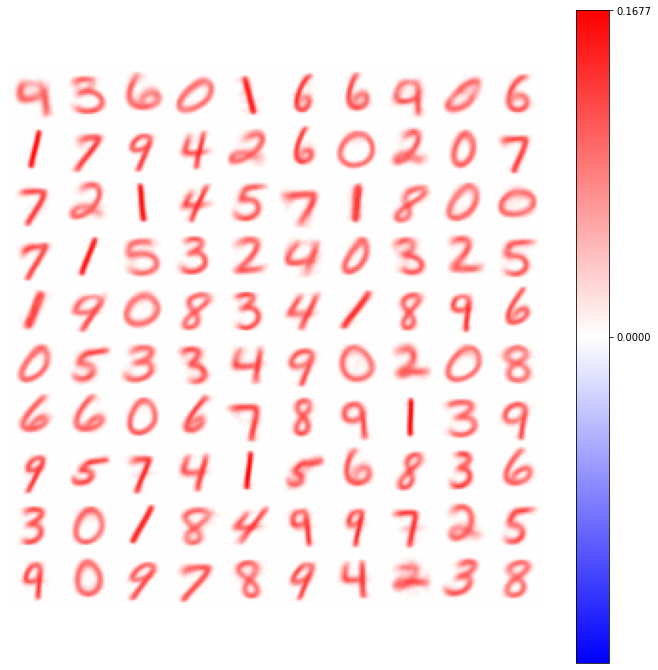

In [147]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

After one epoch, we're sitting at around 87-88% accuracy.  Dope.  Let's try 5, then 10 epochs.

100%|██████████| 120/120 [00:00<00:00, 206.40it/s]


Max val:  0.8247524561056033 Min value:  0.6581792452088703 Mean val:  0.7395787301379921 Std:  0.03164443673212613
Elapsed time:  4.464207410812378  seconds



Neuron classes: [7 4 4 0 0 2 9 0 8 3 1 7 9 6 6 9 8 6 2 3 4 9 6 6 2 3 7 8 3 8 9 5 0 0 4 6 1
 0 6 6 1 9 3 2 4 0 7 5 1 4 2 8 2 0 4 2 6 9 1 7 0 2 6 7 5 1 7 9 5 7 7 7 0 6
 5 3 0 4 4 3 8 4 2 3 9 0 1 8 9 8 5 0 2 9 5 8 5 8 9 5]
Accuracy: 89.65%
Misclassifieds:  [ 14.  19.  85. 159. 236. 124.  27. 134. 128. 109.]


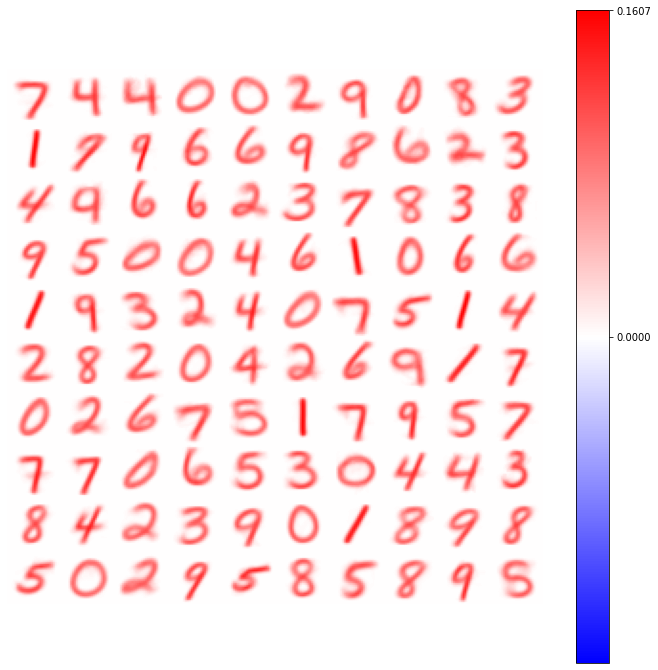

In [150]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

With 5 epochs, it's pretty consistently sitting at around 89.5% Shoot dang. Let's do 10.

100%|██████████| 120/120 [00:00<00:00, 207.10it/s]


Max val:  0.9034832072444366 Min value:  0.7377311605531413 Mean val:  0.8153133288313004 Std:  0.03488314547635344
Elapsed time:  8.646037340164185  seconds



Neuron classes: [9 5 0 2 4 7 6 1 5 2 2 2 8 8 9 4 6 1 6 2 4 4 8 4 0 9 5 7 2 2 5 8 3 6 1 0 2
 7 4 3 0 2 7 6 3 9 0 4 0 5 4 5 9 6 7 8 1 4 8 6 5 4 1 2 0 0 0 7 3 8 3 1 8 8
 9 3 4 6 7 0 6 9 1 0 1 6 0 7 1 7 9 5 9 3 7 2 8 3 0 6]
Accuracy: 90.24%
Misclassifieds:  [ 17.  13.  72. 149. 165. 142.  31. 123. 118. 146.]


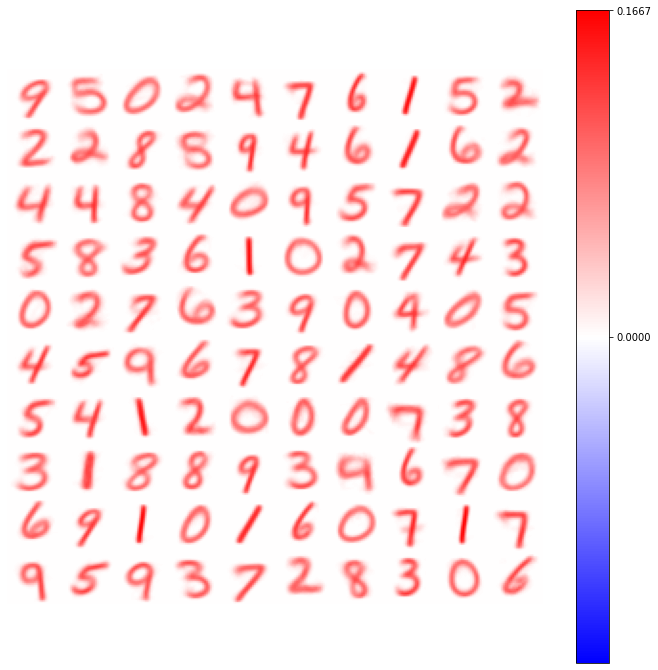

In [154]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Wow, with those settings, it's getting to about 90% accuracy with 10 epochs.  That's dogshit wild.  

Well, the only thing left to do is to try 1,600 neurons.  And then, of course, 6,400 neurons.

100%|██████████| 120/120 [00:10<00:00, 11.91it/s]


Max val:  0.1696476689570262 Min value:  0.0 Mean val:  0.017274210244568156 Std:  0.020488213589624084
Elapsed time:  10.495923519134521  seconds



Neuron classes: [0 0 6 ... 0 9 5]
Accuracy: 91.53%
Misclassifieds:  [ 13.   8.  86.  88. 166. 127.  33. 113. 101. 112.]


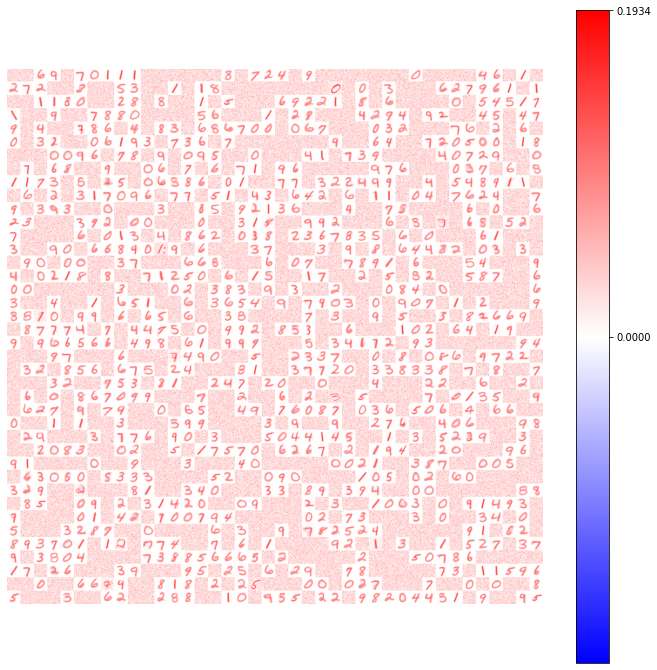

In [155]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 80
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Well, luckily for me, I know the recipe here.  Time to bump zeta.

100%|██████████| 120/120 [00:10<00:00, 11.86it/s]


Max val:  0.17458606948704208 Min value:  0.01991287224788593 Mean val:  0.03844575056648744 Std:  0.014279287699061276
Elapsed time:  10.407131433486938  seconds



Neuron classes: [2 9 4 ... 2 2 7]
Accuracy: 93.9%
Misclassifieds:  [ 13.  14.  62.  75. 109.  60.  22.  65.  83. 107.]


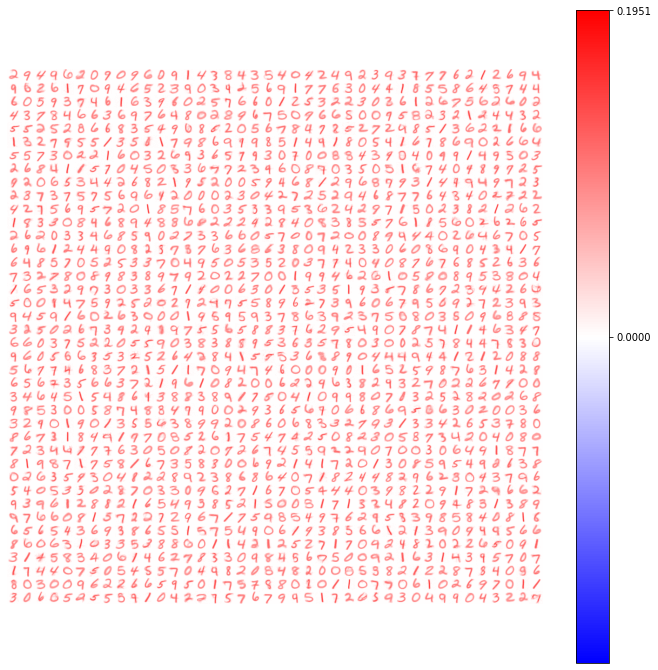

In [157]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 160
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Ok, looks like we're sitting just under 94%.  Time for 5 epochs.

100%|██████████| 120/120 [00:10<00:00, 11.77it/s]


Max val:  0.7334281545516771 Min value:  0.09862729126843307 Mean val:  0.3649752048627585 Std:  0.09346146327130943
Elapsed time:  52.96998357772827  seconds



Neuron classes: [7 5 9 ... 8 6 2]
Accuracy: 95.43%
Misclassifieds:  [ 9.  8. 40. 54. 71. 62. 11. 64. 65. 73.]


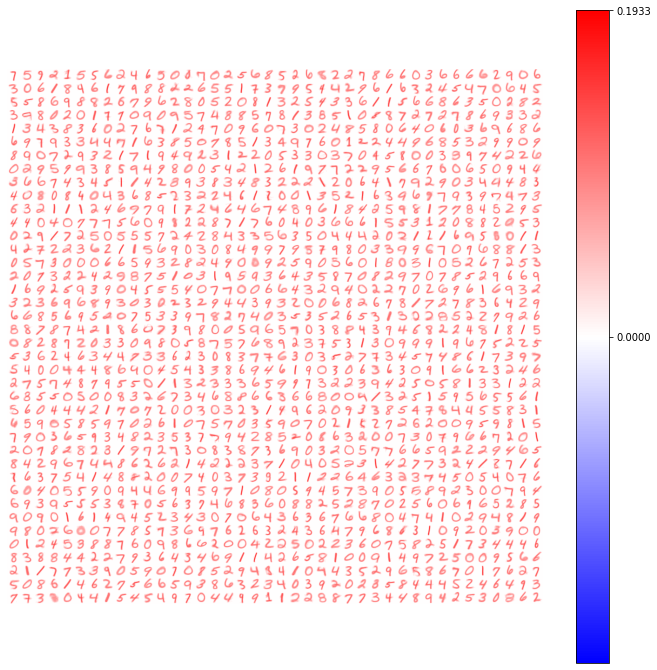

In [158]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 5
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 160
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Now that is just dope beyond words.  After 5 epochs, our 1,600 neuron network is doing better than Diehl's 6,400 neuron network.  Well, let's do 10 epochs, and see what's good in the hood.

100%|██████████| 120/120 [00:10<00:00, 11.74it/s]


Max val:  0.9121483193704455 Min value:  0.21364553443854703 Mean val:  0.5894117309732345 Std:  0.11207006469054326
Elapsed time:  105.66838788986206  seconds



Neuron classes: [8 4 5 ... 2 9 3]
Accuracy: 95.96%
Misclassifieds:  [ 6.  5. 29. 61. 58. 53. 17. 54. 54. 67.]


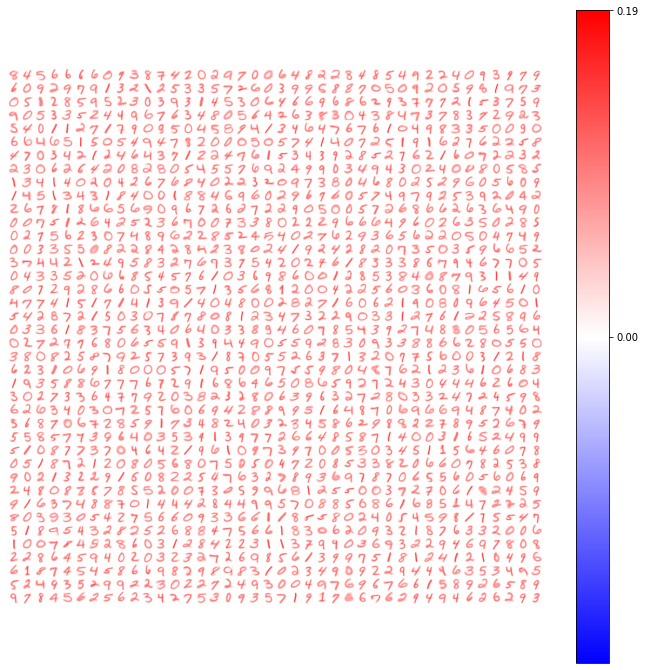

In [159]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 160
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Get wrecked Diehl.  My fucking unsupervised learning algorithm just got 96% accuracy.  

...you know what's next, right?  6,400 fucking neurons, baby!!

100%|██████████| 120/120 [00:43<00:00,  2.78it/s]


Max val:  0.20945155221203793 Min value:  0.0051623843503750145 Mean val:  0.01212427468162099 Std:  0.007357399421216766
Elapsed time:  43.94636678695679  seconds



Neuron classes: [5 9 8 ... 4 8 6]
Accuracy: 94.74%
Misclassifieds:  [ 9. 13. 44. 59. 63. 70. 25. 77. 76. 90.]


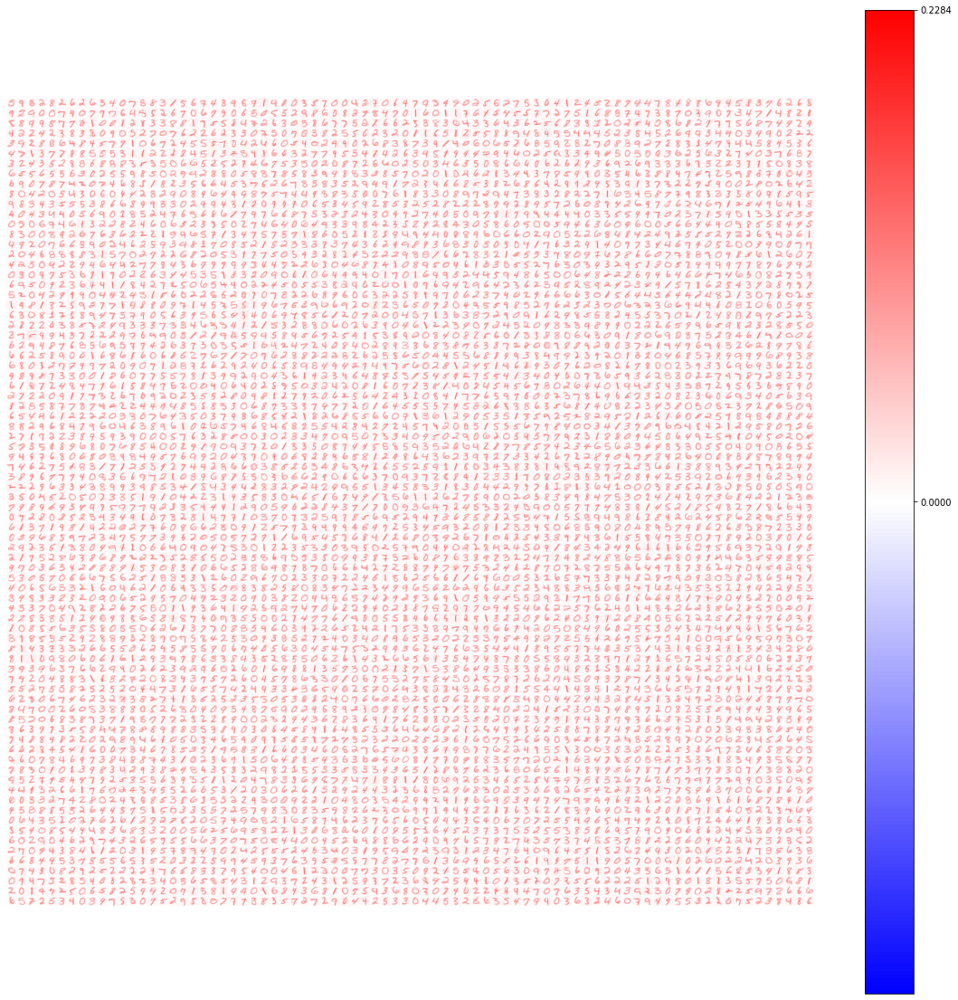

In [161]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 80
Ky = 80
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 320
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Lol.  94.7%.  I think this mother-fucker simply needs more data.  Let's let her chew on 10 epochs.

100%|██████████| 120/120 [00:42<00:00,  2.81it/s]


Max val:  0.9186606134037737 Min value:  0.012024095366251791 Mean val:  0.2428103796379743 Std:  0.11585204904528236
Elapsed time:  438.7504415512085  seconds



Neuron classes: [2 2 0 ... 0 2 6]
Accuracy: 96.54%
Misclassifieds:  [ 5.  8. 27. 49. 42. 48. 17. 43. 44. 63.]


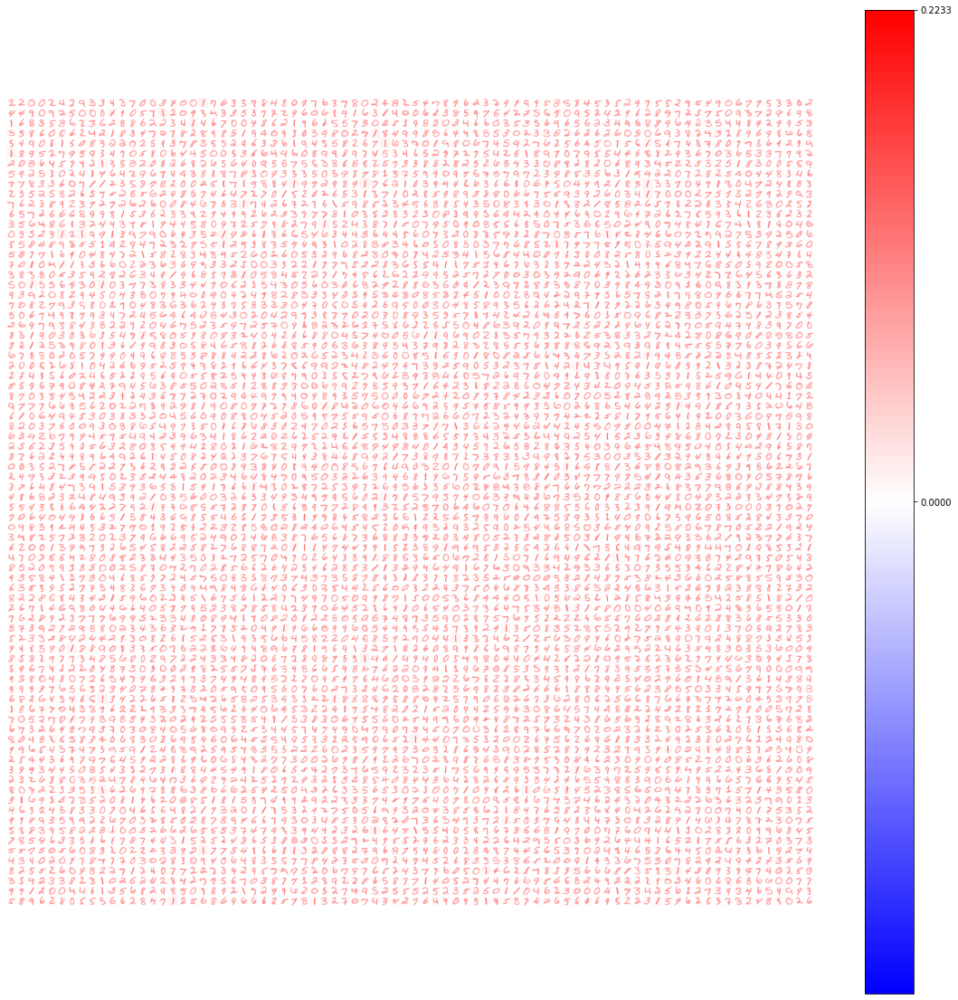

In [162]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 80
Ky = 80
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 320
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
draw_weights(w, Kx, Ky)

Ok, so it got 96.5% accuracy. That is absolutely delicious, and also pretty nutritious.  I'm hungry.  Anyway, yeah that's fucking dope.  

Also I gotta try something here.  zeta = 320 is an absolutely brutal learning curve.  I'm going to see if the 100 neuron network still plays nice with that level of zeta.

100%|██████████| 120/120 [00:00<00:00, 217.97it/s]


Max val:  0.33722310619020385 Min value:  0.22585919509140878 Mean val:  0.2959114149247217 Std:  0.019540584217082543
Elapsed time:  0.8497304916381836  seconds



Neuron classes: [0 8 3 1 0 7 5 4 0 9 5 6 1 0 5 4 2 1 7 5 9 4 3 9 0 8 8 6 3 3 9 2 1 2 3 6 5
 8 6 7 8 2 0 2 8 8 1 3 5 2 5 4 3 2 6 7 4 0 7 7 2 0 7 3 4 7 5 6 5 9 2 9 2 6
 5 2 5 7 8 1 3 2 9 4 6 8 5 8 4 1 7 4 4 0 9 9 7 9 6 3]
Accuracy: 89.52%
Misclassifieds:  [ 25.  11.  85. 121. 253.  93.  34. 117. 138. 171.]


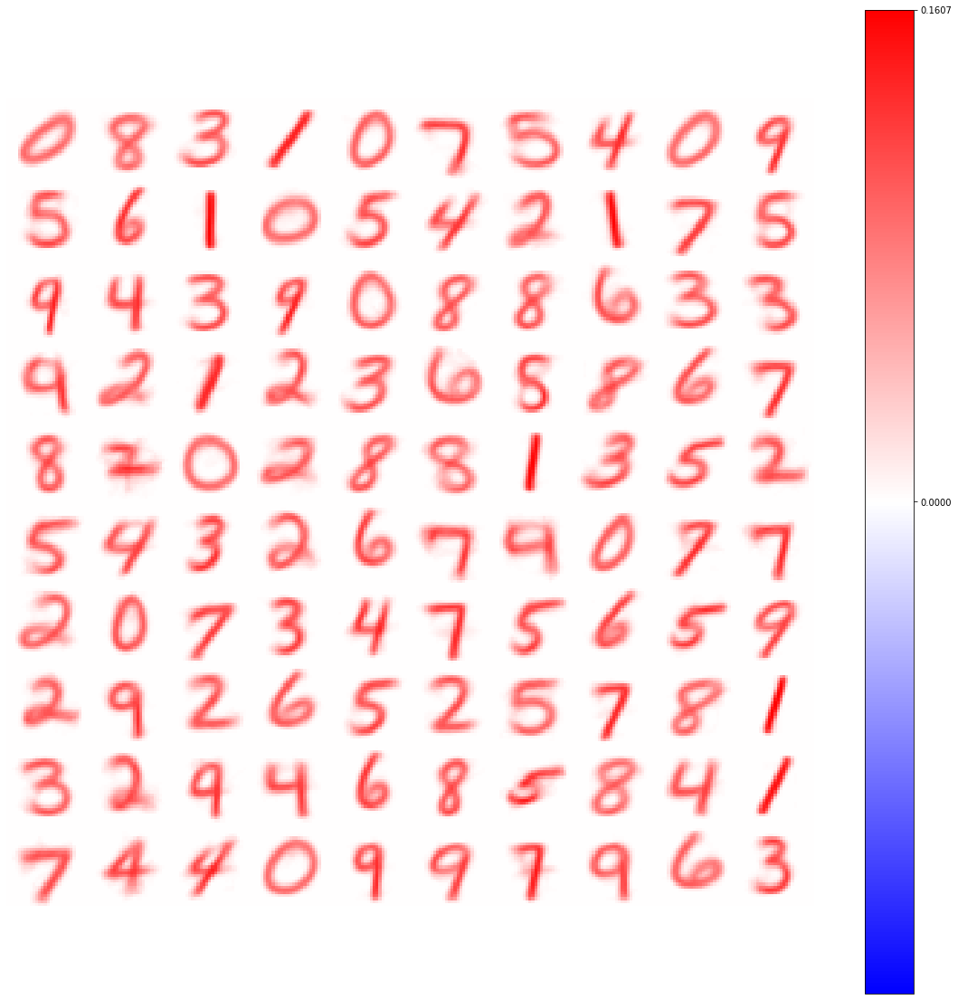

In [167]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 500
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

Well given that last one, it seems like it's fine with huge zeta.  I'm going to try an even bigger one rn.

100%|██████████| 120/120 [00:00<00:00, 216.40it/s]


Max val:  0.33291068848212674 Min value:  0.005890354082134117 Mean val:  0.2736229917528761 Std:  0.06920439953853896
Elapsed time:  0.8534679412841797  seconds



Neuron classes: [9 9 0 5 8 5 5 2 5 6 5 2 2 3 4 7 4 7 3 2 2 4 6 3 6 4 8 8 6 2 8 2 2 9 2 6 5
 0 3 2 1 6 8 3 8 8 4 1 9 9 0 5 0 1 6 7 1 7 4 5 5 2 0 1 7 9 0 1 7 2 8 4 3 2
 4 0 4 7 3 0 0 2 2 8 0 2 7 2 0 7 3 1 9 3 8 8 7 5 0 5]
Accuracy: 87.39%
Misclassifieds:  [ 29.  20.  57. 135. 262. 139.  50. 121. 139. 309.]


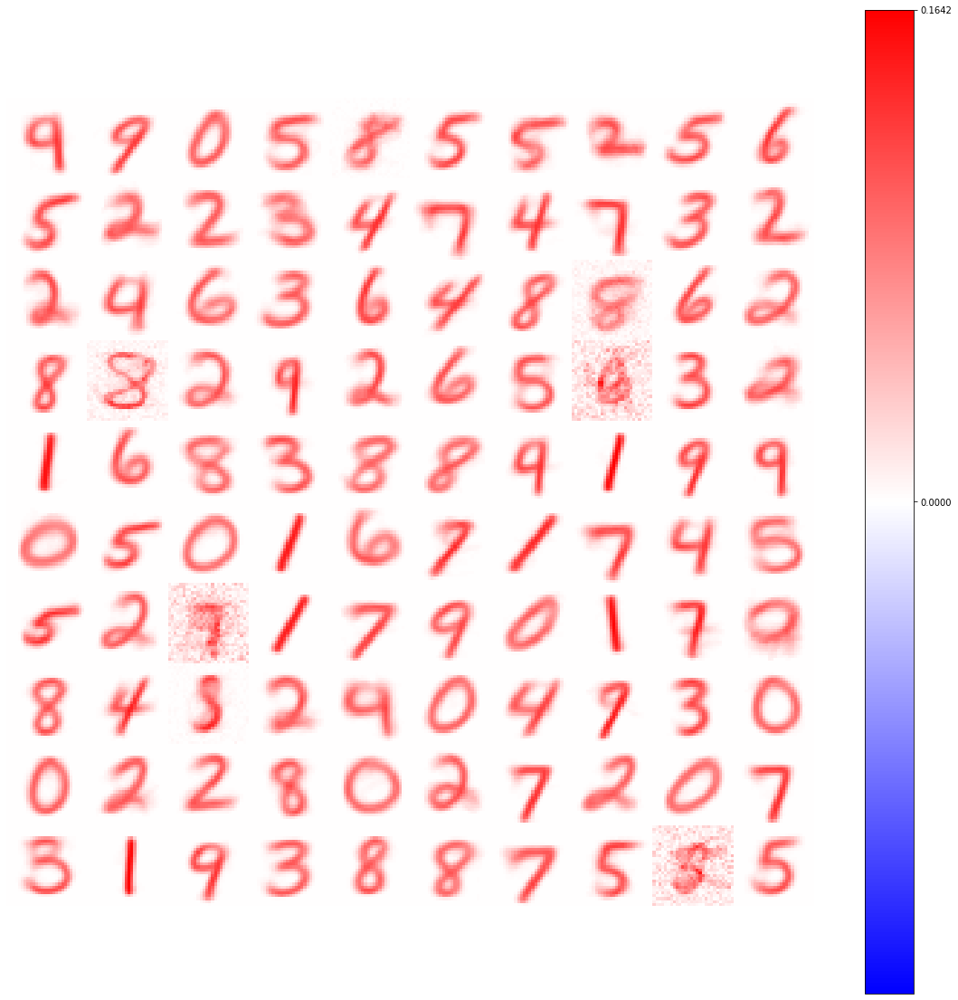

In [174]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 1000
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

Ok, there we go.  At fucking zeta = 1000, we start to get some break down.  Basically the curve is there to get the neuron in the right ball-park, and after that, it's just wta.  Let me try something else real quick.

100%|██████████| 120/120 [00:00<00:00, 216.40it/s]


Max val:  0.33291068848212674 Min value:  0.005890354082134117 Mean val:  0.2736229917528761 Std:  0.06920439953853896
Elapsed time:  0.8534679412841797  seconds



Neuron classes: [9 9 0 5 8 5 5 2 5 6 5 2 2 3 4 7 4 7 3 2 2 4 6 3 6 4 8 8 6 2 8 2 2 9 2 6 5
 0 3 2 1 6 8 3 8 8 4 1 9 9 0 5 0 1 6 7 1 7 4 5 5 2 0 1 7 9 0 1 7 2 8 4 3 2
 4 0 4 7 3 0 0 2 2 8 0 2 7 2 0 7 3 1 9 3 8 8 7 5 0 5]
Accuracy: 87.39%
Misclassifieds:  [ 29.  20.  57. 135. 262. 139.  50. 121. 139. 309.]


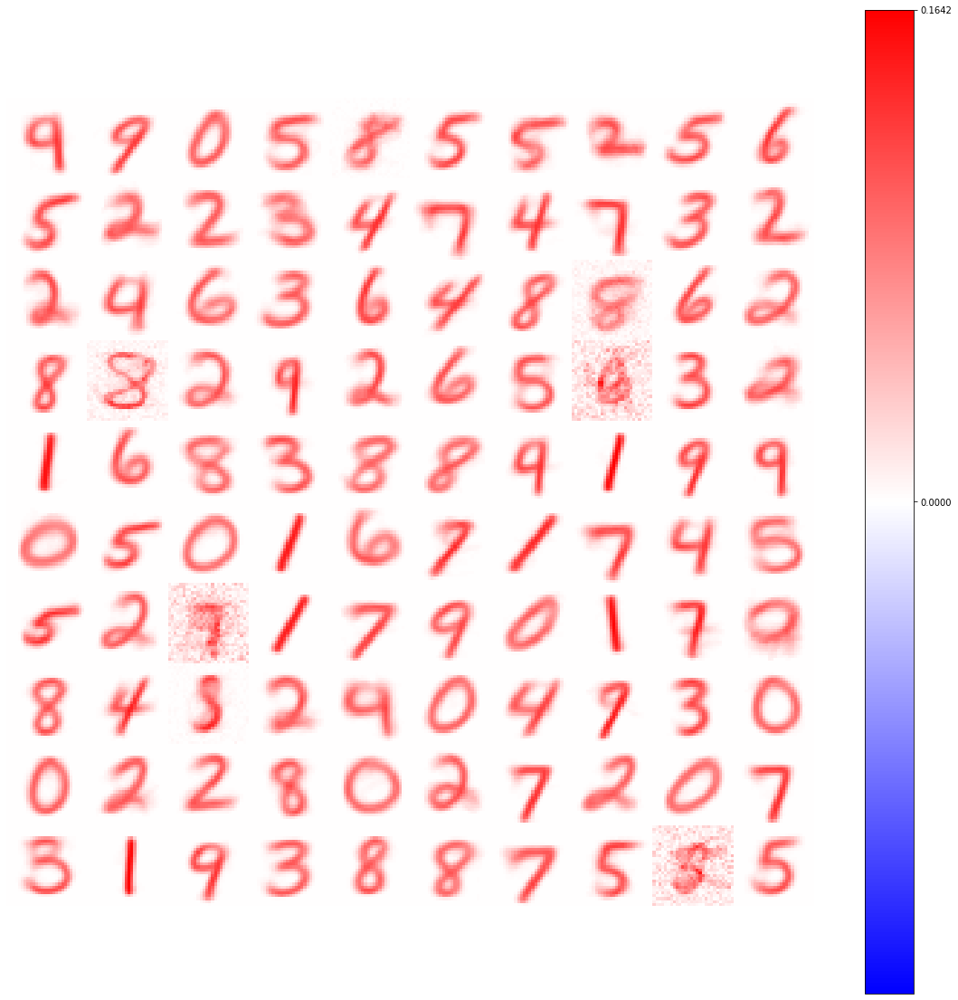

In [174]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.1

B = 500 #Batch size

(w, _) = run_comp_spec_mb(flat_x, S, L, Kx, Ky, Nep, T_s, xi, phi, B, zeta, beta)
print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

100%|██████████| 120/120 [00:02<00:00, 44.28it/s]


Max val:  0.33563389633036883 Min value:  0.06819572118139938 Mean val:  0.20712474448410817 Std:  0.0415942571347655
Elapsed time:  3.146594524383545  seconds



Neuron classes: [0 8 6 0 3 2 5 6 9 7 6 2 4 4 4 8 8 0 4 2 8 0 4 2 4 2 2 4 5 9 1 6 8 6 5 5 2
 7 1 5 7 2 8 4 9 9 0 4 0 2 5 6 5 9 4 2 7 6 2 5 7 1 4 3 1 7 9 4 8 3 0 9 6 3
 1 3 3 8 2 7 0 1 9 5 5 5 8 3 6 4 1 0 7 9 4 4 0 8 1 0 3 8 0 0 5 9 5 3 5 3 5
 1 6 1 0 6 3 9 4 0 5 8 7 1 3 7 4 2 2 7 3 7 9 7 8 3 0 4 2 7 8 8 4 5 2 5 5 8
 5 2 1 9 7 0 9 6 0 9 9 6 8 1 7 9 5 2 6 7 3 5 7 2 7 6 8 2 7 2 4 2 8 9 0 6 9
 2 7 7 0 4 6 4 9 4 2 8 0 6 3 3 7 8 1 2 3 6 8 9 7 4 4 6 3 3 5 0 4 4 2 6 6 3
 3 0 8 9 0 0 9 0 3 0 7 4 7 3 2 3 6 5 8 4 9 9 7 2 6 4 0 1 6 6 8 9 7 4 8 8 2
 0 6 0 0 0 0 2 5 0 5 0 5 7 0 9 2 6 2 0 1 6 3 8 9 7 1 0 3 7 1 6 9 5 0 6 5 5
 5 6 7 4 4 1 9 7 3 5 2 7 7 1 5 3 4 7 2 8 2 8 8 5 6 8 0 6 7 3 3 2 6 2 6 1 4
 5 2 6 2 5 3 5 6 7 9 9 8 0 7 3 7 5 9 9 6 6 0 2 6 5 7 0 2 6 2 2 0 3 7 0 2 5
 9 0 0 6 7 8 1 8 0 0 8 4 4 9 6 9 8 2 2 5 2 8 5 6 1 4 8 7 6 2]
Accuracy:

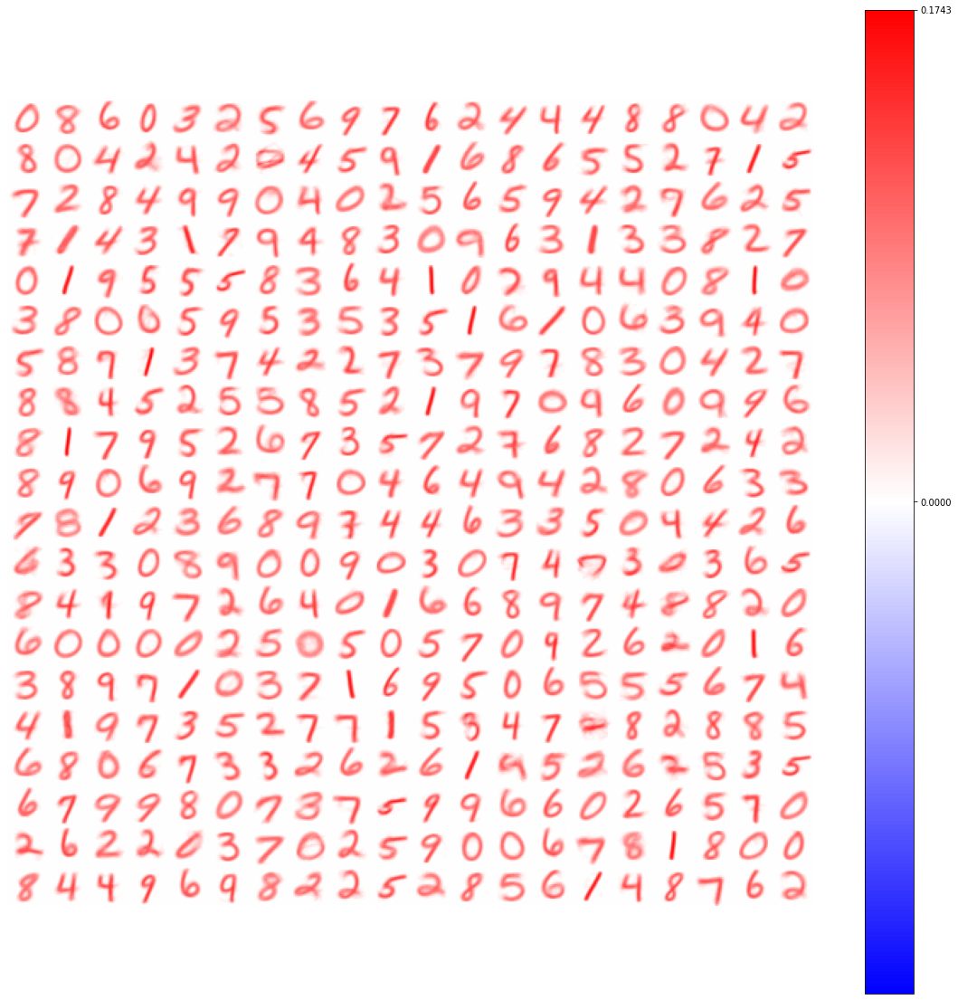

In [183]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 20
Ky = 20
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.1

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    inputs = flat_x[np.random.permutation(S), :].reshape(S, L)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) / (1 - o)

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        w += del_syn

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

Hmm I don't think it actually makes a huge difference if you use $o$ or $1 / (1 - o)$ in the denominator.  Awesome.  That means I can use $o$ and never need to worry about singularities.

100%|██████████| 120/120 [00:02<00:00, 44.78it/s]


Max val:  0.9295388863829462 Min value:  0.6571945002904583 Mean val:  0.8128873410954521 Std:  0.04442155497978497
Elapsed time:  30.446077585220337  seconds



Neuron classes: [8 5 3 1 3 0 0 6 8 2 4 5 3 0 8 2 4 9 3 0 3 1 7 2 5 9 0 5 4 2 3 7 3 9 8 2 4
 5 3 4 2 9 4 2 6 9 0 9 5 4 6 5 3 7 2 3 2 1 4 0 7 4 5 9 1 1 5 2 3 7 5 9 2 5
 4 6 8 8 7 5 0 3 6 2 4 8 5 0 3 4 7 1 4 7 5 3 0 2 5 0 0 0 3 1 3 5 9 3 0 5 3
 5 9 2 5 6 9 2 0 6 5 1 0 6 5 0 7 9 1 6 1 0 3 6 0 0 9 4 9 9 8 0 6 7 0 8 5 6
 5 1 6 7 8 8 3 6 8 7 9 4 5 6 3 4 1 8 0 6 0 0 4 4 8 6 1 6 6 1 0 3 4 1 2 0 2
 2 2 6 0 3 2 2 2 8 8 7 5 1 0 4 7 0 6 0 6 1 8 7 9 5 0 0 7 8 7 7 6 4 1 2 5 3
 7 7 7 5 3 3 8 6 5 6 2 7 6 0 6 4 2 3 6 1 7 3 1 3 1 0 4 7 4 9 0 0 0 1 2 6 6
 8 2 5 9 3 5 0 9 2 7 2 7 2 1 4 7 9 2 6 3 0 8 0 8 2 6 8 4 5 7 1 2 7 7 4 9 5
 4 3 7 8 5 3 6 4 5 2 2 0 8 0 9 8 9 4 5 0 6 9 6 0 6 7 3 2 5 7 8 2 6 0 0 3 8
 8 6 7 9 4 0 7 2 0 2 4 1 7 2 1 9 8 0 9 0 3 6 2 7 5 0 4 1 9 9 0 3 5 2 0 2 4
 6 9 9 4 7 2 7 1 3 5 5 8 4 5 3 2 3 9 6 8 3 6 0 7 8 1 5 1 5 4]
Accuracy: 

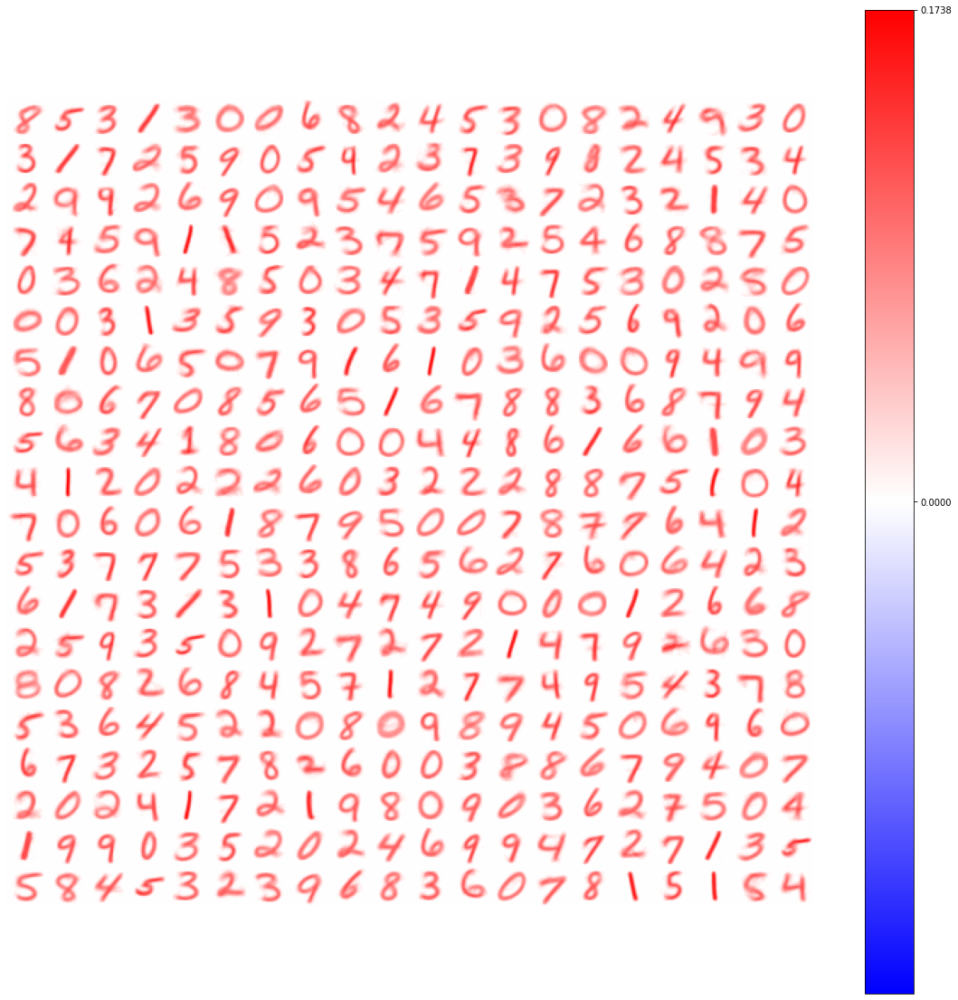

In [186]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 20
Ky = 20
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.1

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    inputs = flat_x[np.random.permutation(S), :].reshape(S, L)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        w += del_syn

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

Wow it actually looks like I'm getting better performance with $o$ that $1 / (1 - o)$.  Dang, well it looks like all my fancy bells and whistles aren't that important after all.  

I'm going to try 1,600 neurons with these new settings, and then I want to mess around with ordered data and see what happens.

100%|██████████| 120/120 [00:09<00:00, 12.02it/s]


Max val:  0.9149416444561069 Min value:  0.19318781116332714 Mean val:  0.5950725361001817 Std:  0.10668325045913403
Elapsed time:  103.75081086158752  seconds



Neuron classes: [6 1 7 ... 8 1 0]
Accuracy: 95.82%
Misclassifieds:  [ 8.  5. 35. 64. 62. 48. 23. 53. 56. 64.]


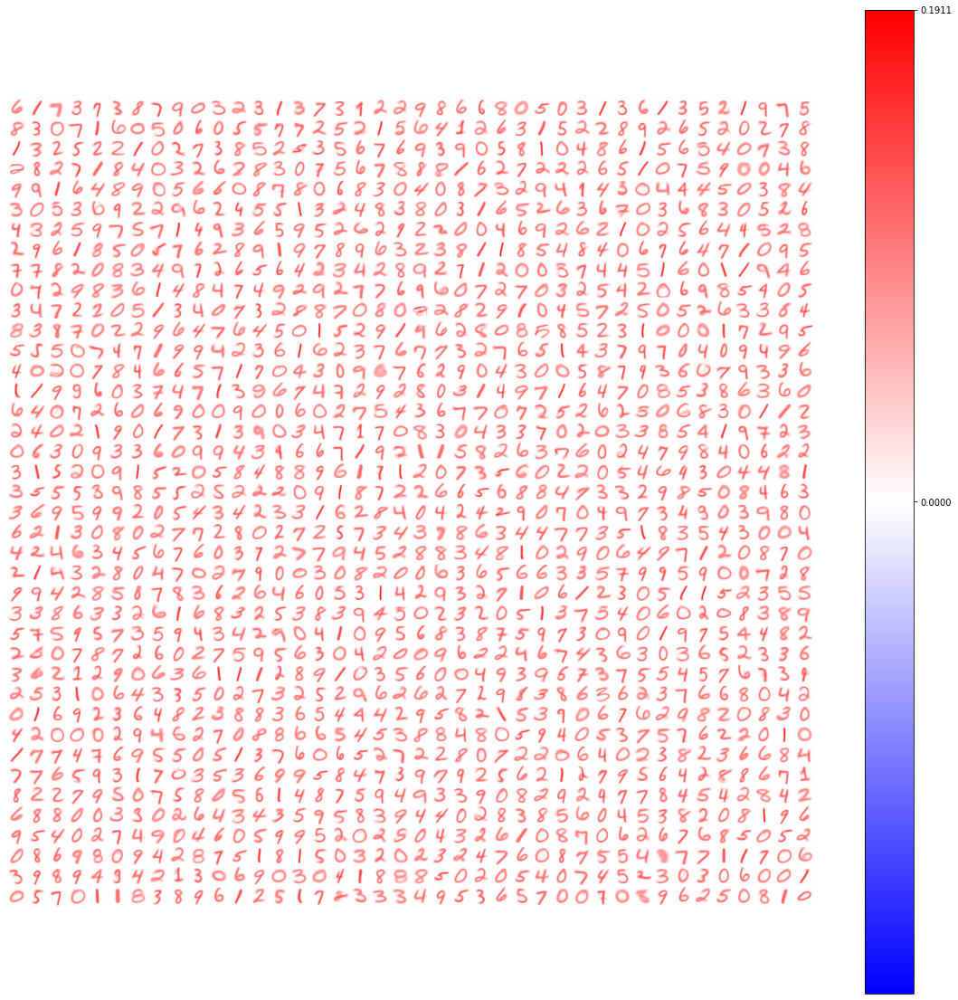

In [187]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 40
Ky = 40
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.1

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    inputs = flat_x[np.random.permutation(S), :].reshape(S, L)

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        w += del_syn

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

Yeah it doesn't seem to make any difference.  Dope.  Alright, let's try ordered data.

100%|██████████| 120/120 [00:00<00:00, 205.34it/s]


Max val:  0.21761800269983095 Min value:  0.042181356207607594 Mean val:  0.14024382745320144 Std:  0.04073229143961741
Elapsed time:  0.8836040496826172  seconds



Neuron classes: [8 7 5 6 7 4 7 9 6 9 6 9 4 0 5 7 3 0 4 3 2 7 6 6 6 6 9 1 8 7 9 8 7 7 6 0 0
 0 2 7 8 6 6 6 2 3 4 3 4 4 4 2 2 9 8 5 3 3 2 6 6 2 5 1 7 2 2 2 3 6 6 4 5 2
 6 7 5 7 5 8 8 3 0 1 9 2 4 9 4 3 0 5 0 1 7 1 6 8 5 1]
Accuracy: 60.22%
Misclassifieds:  [429.  87. 312. 464. 587. 539. 151. 290. 511. 608.]


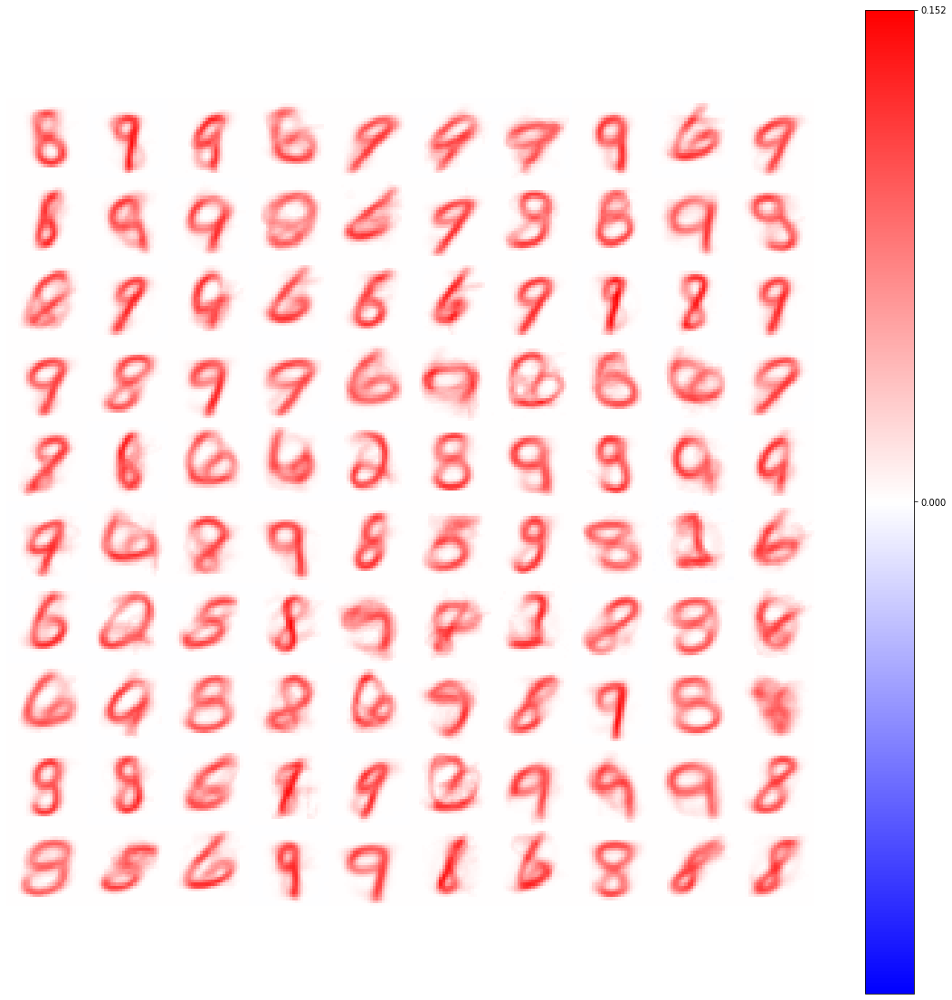

In [207]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(20,20))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.1

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :].reshape(S, L)

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        w += del_syn

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
wta_classification(w, T_s)
# draw_weights(w, Kx, Ky)

Ok, that's after one epoch.  I'm going to try with a couple epochs and see how it goes.

<IPython.core.display.Javascript object>


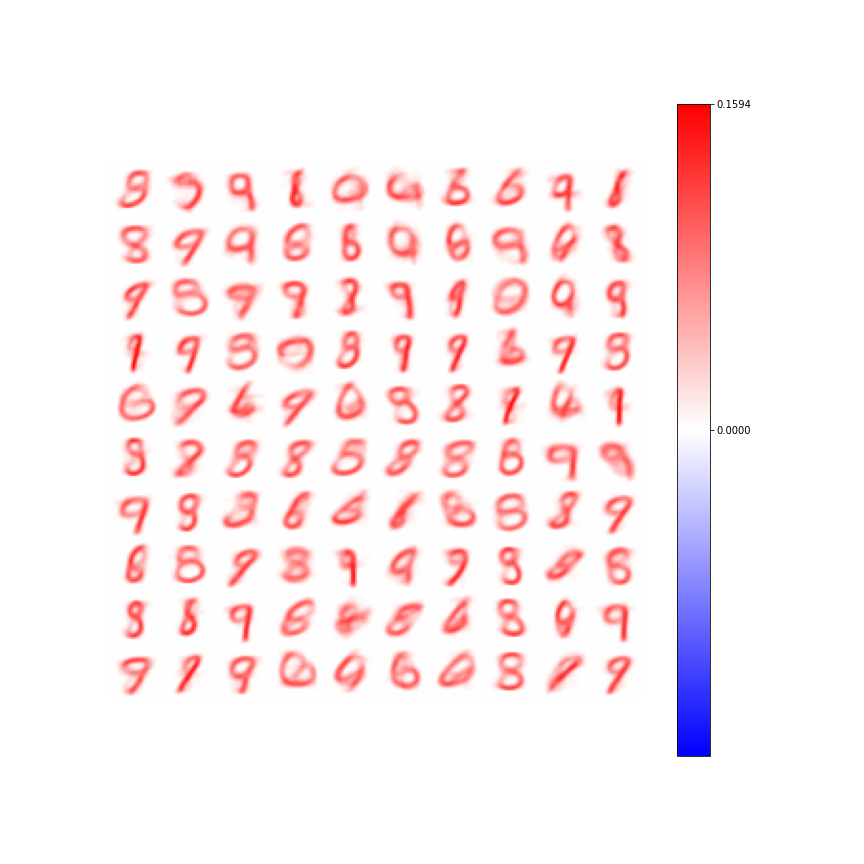

100%|██████████| 120/120 [00:00<00:00, 214.46it/s]


Max val:  0.8145391705985864 Min value:  0.707924093136525 Mean val:  0.7752558692630173 Std:  0.02109678345862346
Elapsed time:  22.585851430892944  seconds



Neuron classes: [3 7 4 1 0 6 6 0 4 1 8 4 4 0 6 2 6 4 2 3 4 5 7 7 2 9 4 0 4 9 1 9 3 0 3 9 7
 6 7 3 0 7 6 4 6 3 2 1 2 1 3 2 3 8 0 8 5 0 4 2 4 8 2 6 5 1 6 0 2 7 6 3 7 2
 9 4 7 3 5 5 8 6 7 0 2 5 6 3 6 9 7 1 9 6 6 6 0 3 8 7]
Accuracy: 56.68%
Misclassifieds:  [280.  68. 464. 413. 537. 612. 260. 410. 633. 655.]


<IPython.core.display.Javascript object>


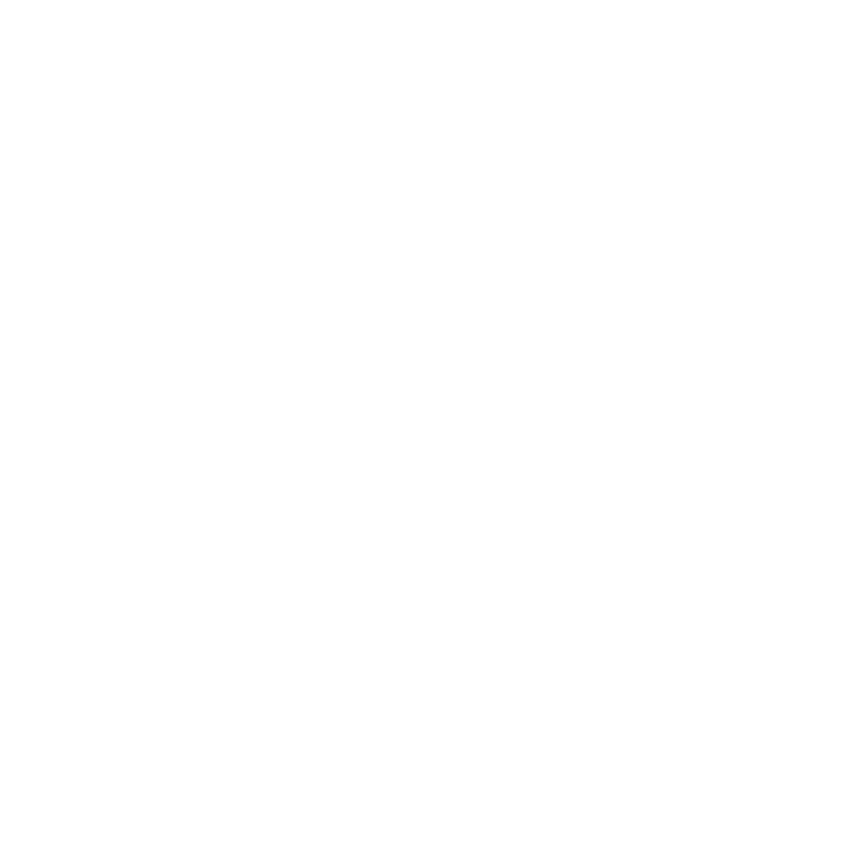

In [196]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 30
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :].reshape(S, L)

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        w += del_syn

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
wta_classification(w, T_s)

Ok, I took beta down a bit.  Now I am pretty happy with these prototypes.  The wta accuracy is pretty low, but the prototypes are still encompassing a wide range of data.  I'm going to try this with 400 neurons.

<IPython.core.display.Javascript object>


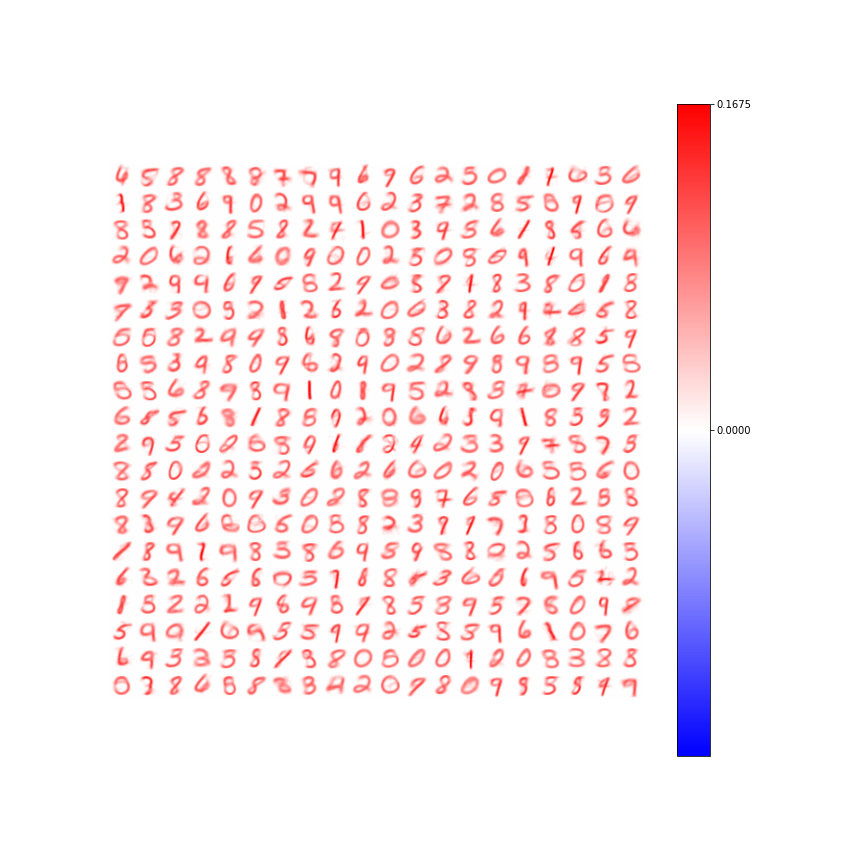

100%|██████████| 120/120 [00:02<00:00, 46.38it/s]


Max val:  0.6118229267654407 Min value:  0.18856921987219646 Mean val:  0.40811599315002645 Std:  0.09297326080606322
Elapsed time:  20.066787481307983  seconds



Neuron classes: [4 5 8 8 8 8 7 7 9 6 7 6 2 3 0 1 1 6 3 6 1 8 3 6 9 0 2 4 9 6 2 3 7 2 5 5 0
 9 0 9 3 3 7 8 8 5 8 2 4 1 0 3 4 5 6 1 8 4 6 6 2 0 6 2 6 6 0 9 0 0 2 5 0 3
 0 9 1 9 6 4 7 2 4 4 6 7 5 5 2 9 0 5 7 1 8 3 8 0 1 8 7 3 3 0 3 2 1 2 6 2 0
 0 3 8 2 4 2 0 5 2 5 0 8 2 4 4 3 6 8 0 3 5 6 2 6 6 8 8 5 7 0 3 3 4 8 0 9 6
 2 9 0 2 8 9 8 4 8 7 5 5 5 3 6 3 7 8 9 1 0 1 4 5 2 3 3 4 0 7 7 2 6 5 5 6 8
 1 8 5 9 2 0 6 6 3 9 1 8 3 3 2 2 7 5 0 2 6 3 4 1 1 2 4 2 3 3 9 7 3 7 3 2 5
 0 0 2 3 2 5 6 2 6 6 0 2 0 6 3 5 5 0 8 7 4 2 0 7 3 0 2 8 8 9 7 6 5 0 6 2 5
 8 8 3 4 6 6 0 5 0 3 8 2 3 7 7 7 3 3 0 8 9 1 8 4 1 4 3 3 8 0 4 5 9 8 8 2 2
 5 6 6 3 6 3 2 6 5 6 0 3 7 8 8 5 3 6 0 6 9 5 2 2 1 5 2 2 2 9 6 4 3 7 8 3 3
 7 5 7 5 0 9 8 5 4 0 1 6 4 5 5 9 9 2 5 3 5 9 6 1 0 7 6 6 9 3 3 3 8 4 3 8 0
 5 0 0 1 2 0 3 3 8 3 0 3 8 6 5 8 3 3 4 2 0 7 8 0 7 5 3 5 4 7]
Accuracy

<IPython.core.display.Javascript object>


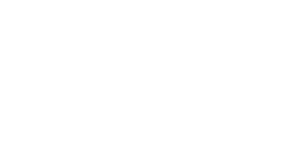

In [198]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 7
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = flat_x[np.argsort(train_y), :].reshape(S, L)

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    

    for i in tqdm(range(T_s // B)):
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        del_syn = (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        w += del_syn

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
wta_classification(w, T_s)

The interesting thing about these ones is that they pretty much settled down after 5 epochs.  Maybe even 3.  Actually might be an aspect of memory.  That's interesting.  

Anyway, I'm going to build out the cs-i classifier, but with just CompSpec and see what happens.  Hopefully it'll go well, but I'm been pummeled by this classifier enough to know that it probably won't.  At least the implementation isn't as hard.

100%|██████████| 120/120 [00:02<00:00, 42.79it/s]


Max val:  0.6430679160152456 Min value:  0.10557130418097134 Mean val:  0.40448386910600276 Std:  0.09577246277911133
Elapsed time:  21.215020895004272  seconds





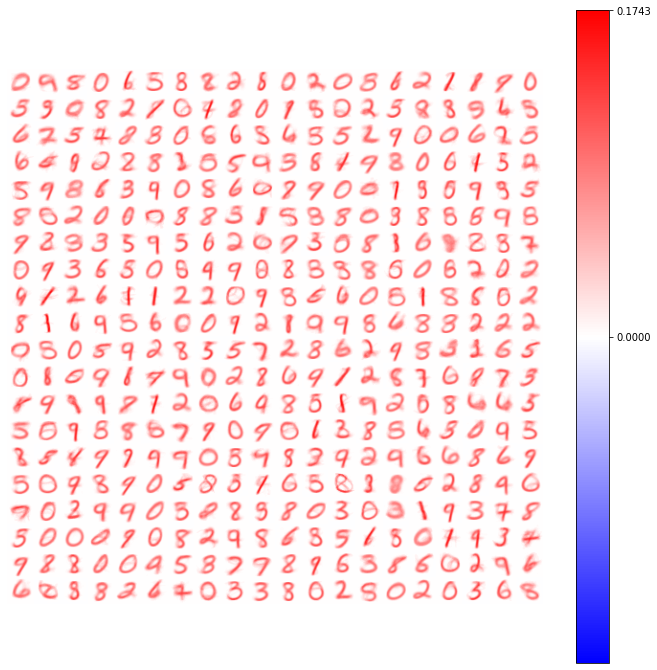

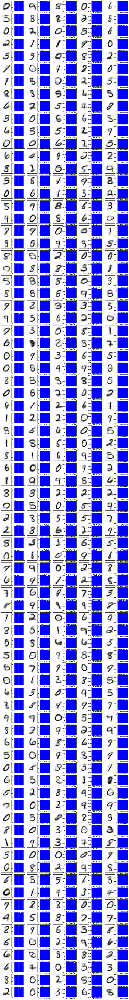

In [212]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 7
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x[np.argsort(train_y), :].reshape(S, L)

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
plot_everything(w, w_c, 5, 80)

In [214]:
s_c

array([[0.94657069],
       [0.9463263 ],
       [0.94658667],
       [0.94647072],
       [0.94662412],
       [0.94648563],
       [0.94655035],
       [0.94643442],
       [0.9463198 ],
       [0.94648695]])

I simply refuse to believe that the classification weights are that even.  God, that fucking sickens me.  I'm rarely felt more passionate anger in my life than how I do in this moment toward this stupid fucking classifier.  So help me, I'm going to re-write the entire fucking thing.  There's an error somewhere in there that causing uniformity.  There's no other way.  I also haven't eaten yet today, and it's almost three o'clock, so I'm going to shut this down for the moment and eat some food.  

Oh, wait. I found the bug. I ordered the image data and not the labeled data.  Lol.

Here's the classifier, hopefully without the fucking bug.

100%|██████████| 120/120 [00:00<00:00, 179.04it/s]


Max val:  0.31656315941586327 Min value:  0.1704148113227174 Mean val:  0.2718680815469516 Std:  0.021503842041929823
Elapsed time:  0.7589387893676758  seconds





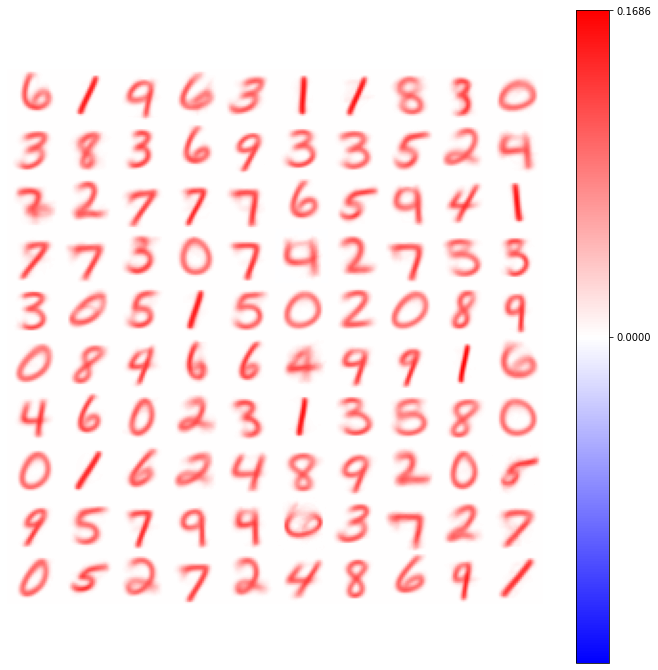

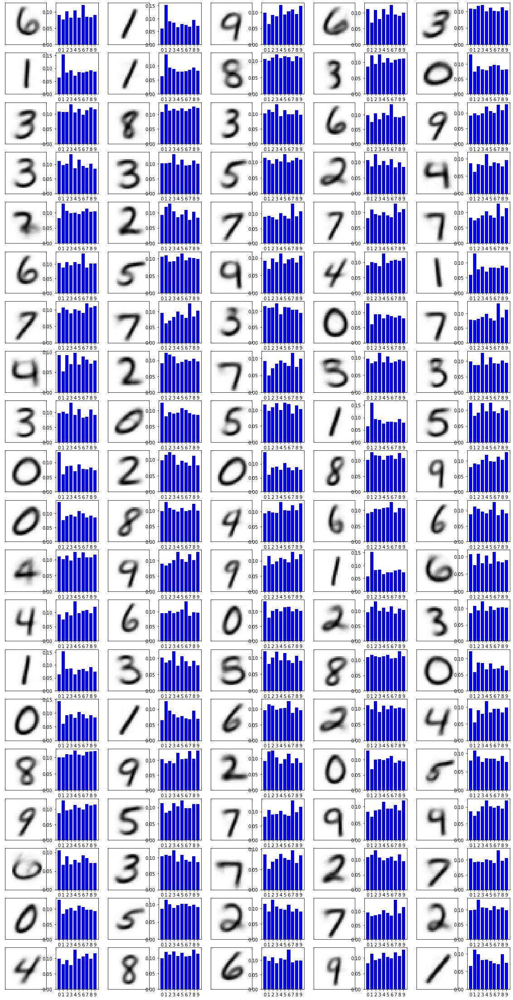

In [217]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 1
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

print("\n\n")
plot_everything(w, w_c, 5, 20)

Ok, that's looking much better.  Now I'm going to write the fucking accuracy measure.

In [221]:
def class_acc(w, w_c):
    res = w_c @ w @ flat_test.T
    winners = np.argmax(res, axis=0).reshape(-1)
    
    dubs = np.zeros(test_y.shape[0])
    dubs[winners == test_y] = 1
    num_correct = np.sum(dubs)
    
    print("Accuracy: ", 100 * num_correct / test_y.shape[0], "%")

In [224]:
class_acc(w, w_c)

Accuracy:  71.67 %


So this classifier isn't as good as wta classification, but at least it's a step in the right direction.  I'm going to try more epochs now.

100%|██████████| 120/120 [00:00<00:00, 182.11it/s]


Max val:  0.9041594278930093 Min value:  0.7366496824530842 Mean val:  0.8131922156097565 Std:  0.03617265016571828
Elapsed time:  7.786898374557495  seconds
Accuracy:  72.66 %





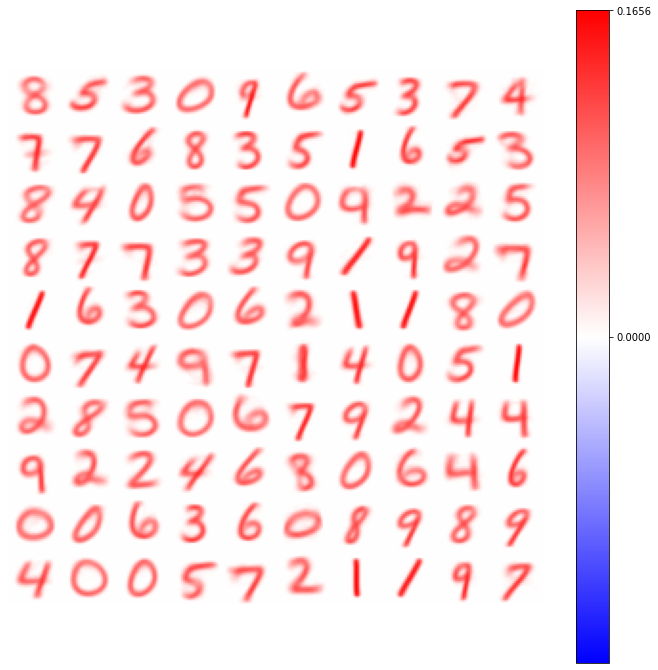

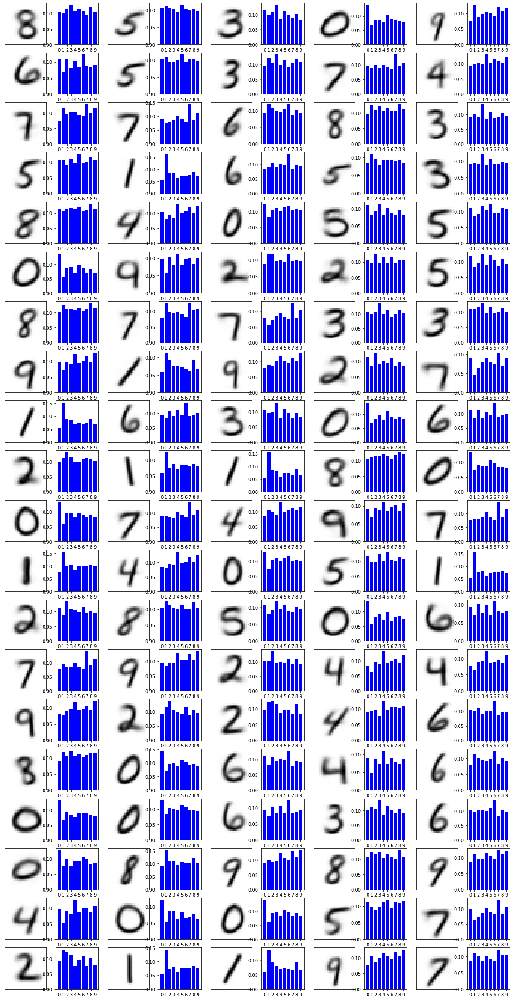

In [226]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

class_acc(w, w_c)

print("\n\n")
plot_everything(w, w_c, 5, 20)

Hmm, so we're peaking at around 72.2%.  Fan-fucking-tastic. Let's do more neurons.

100%|██████████| 120/120 [00:02<00:00, 42.49it/s]


Max val:  0.9295788426957386 Min value:  0.5401889336704038 Mean val:  0.8009447257179626 Std:  0.052406058227524
Elapsed time:  29.333767652511597  seconds
Accuracy:  73.61 %





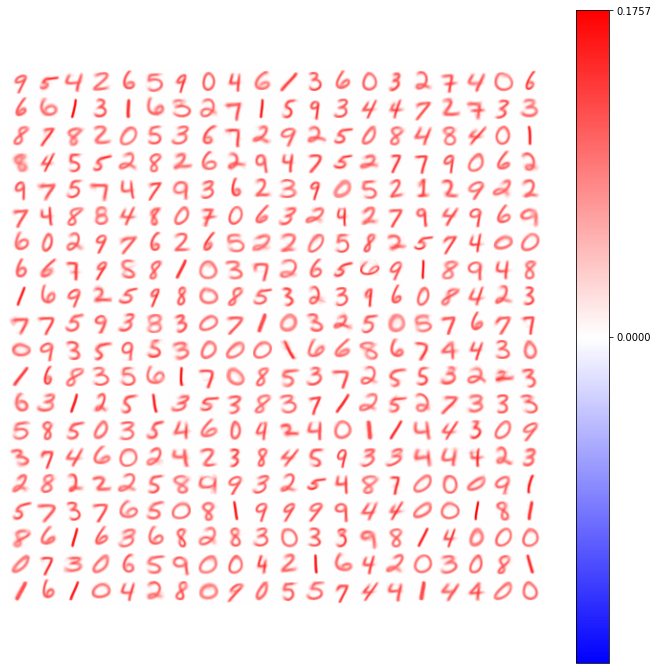

In [227]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

class_acc(w, w_c)

print("\n\n")
# plot_everything(w, w_c, 5, 20)

Huge rip.  Let's try 1,600 and then call it a day.

100%|██████████| 120/120 [00:10<00:00, 11.35it/s]


Max val:  0.9128173937755089 Min value:  0.06303704080199712 Mean val:  0.56545645436117 Std:  0.1224824018325239
Elapsed time:  107.41914224624634  seconds
Accuracy:  74.04 %





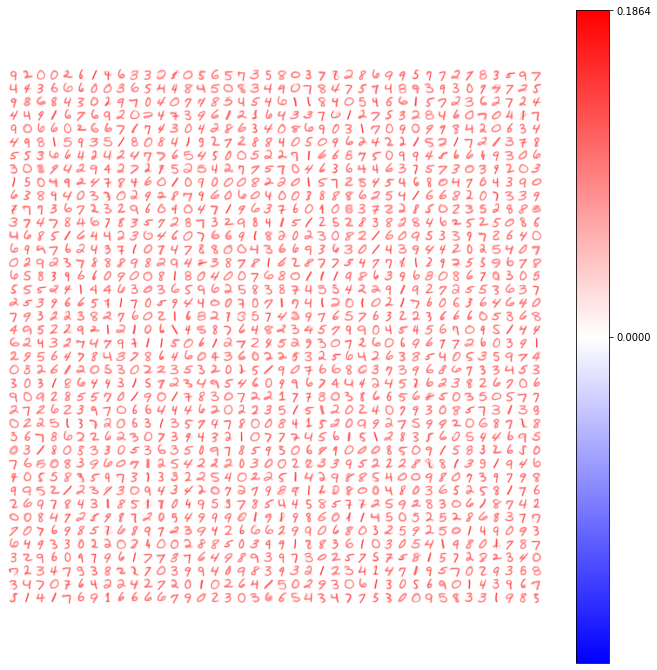

In [228]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

class_acc(w, w_c)

print("\n\n")
# plot_everything(w, w_c, 5, 20)

Wow, this is actually kinda weird.  It's about 74% every time.  Imma eat lunch, and then I'm going to investigate this.  

Ok, I rested for 2 hours.  Time to take a look at this bad boi with fresh eyes.  One thing I'd like to potentially try is to make the output of the layer 0 everywhere except the neuron that wins.  Then I'm essentially making the wta classifier, but using these neurons.  Yeah.  Imma do that.  Time to rework some shit.

100%|██████████| 120/120 [00:00<00:00, 180.12it/s]


Max val:  0.9073932150504286 Min value:  0.7254693469544571 Mean val:  0.8142640472789999 Std:  0.037702304591305365
Elapsed time:  7.851036071777344  seconds





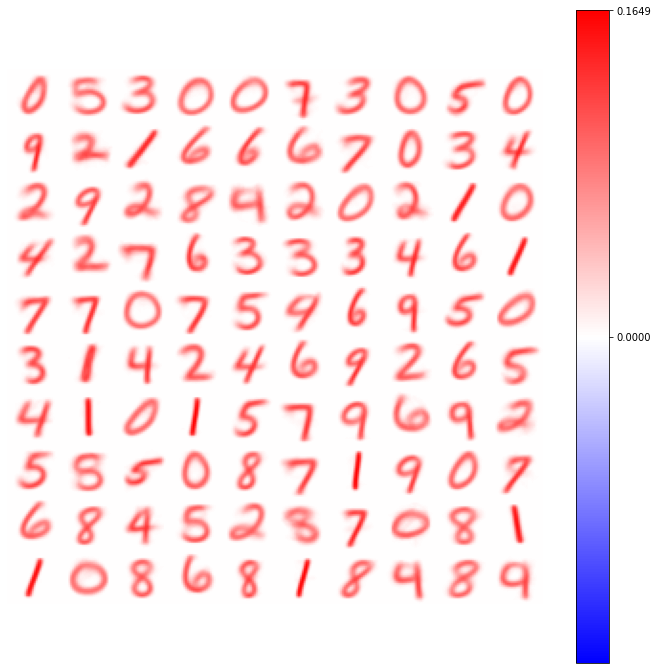

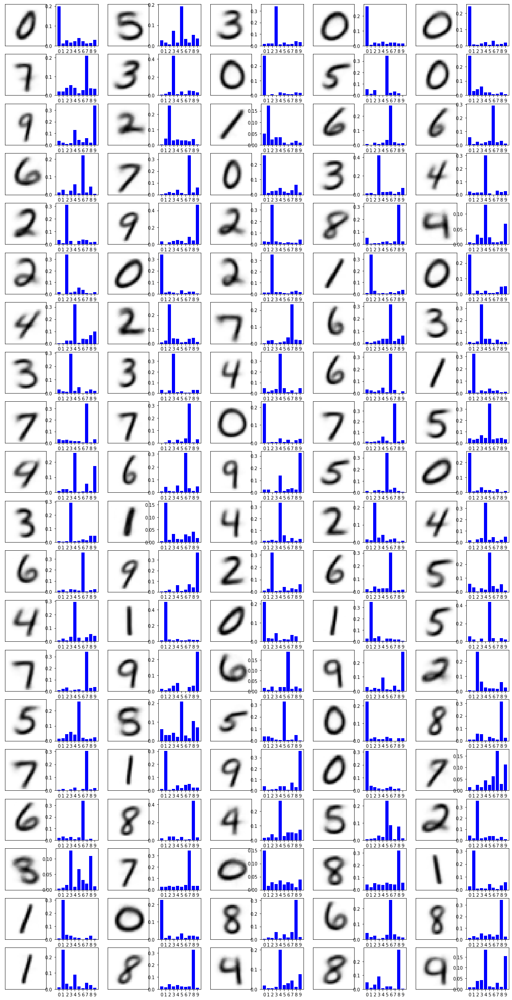

In [230]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask_o = np.zeros((N, B))
        win_mask_o[wins, np.arange(B)] = 1
        win_mask = (win_mask_o / np.maximum(np.sum(win_mask_o, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ win_mask_o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(win_mask_o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ win_mask_o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

# class_acc(w, w_c)

print("\n\n")
plot_everything(w, w_c, 5, 20)

In [233]:
def class_acc_m(w, w_c):
    gloat = w @ flat_test.T
    
    wins = np.argmax(gloat, axis=0)     

    win_mask_o = np.zeros(gloat.shape)
    win_mask_o[wins, np.arange(gloat.shape[1])] = 1
    
    res = w_c @ win_mask_o
    winners = np.argmax(res, axis=0).reshape(-1)
    
    dubs = np.zeros(test_y.shape[0])
    dubs[winners == test_y] = 1
    num_correct = np.sum(dubs)
    
    print("Accuracy: ", 100 * num_correct / test_y.shape[0], "%")

In [234]:
class_acc_m(w, w_c)

Accuracy:  88.83 %


100%|██████████| 120/120 [00:02<00:00, 41.91it/s]


Max val:  0.928965374349979 Min value:  0.5547397346525232 Mean val:  0.8019657502032892 Std:  0.05046294305985977
Elapsed time:  29.70635485649109  seconds
Accuracy:  92.9 %





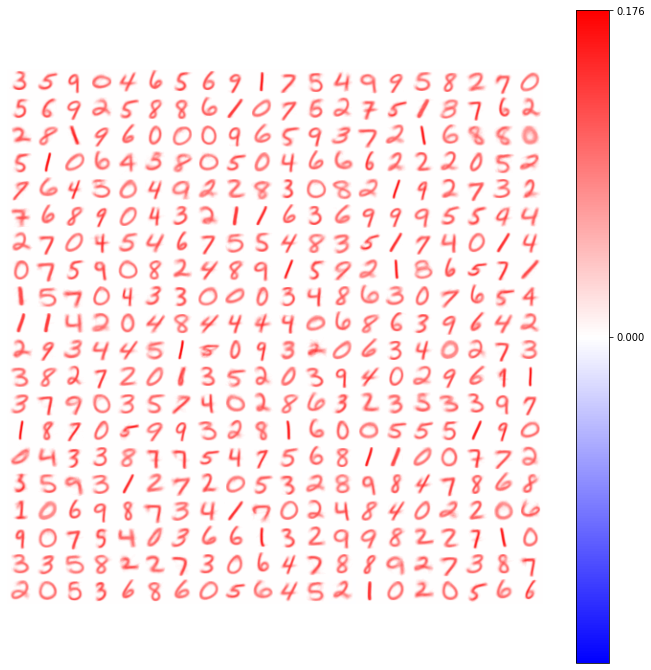

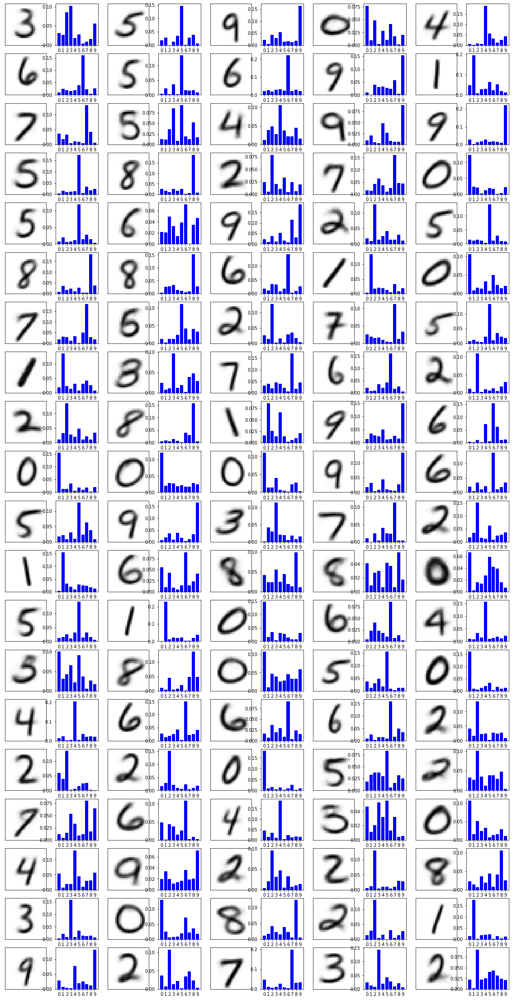

In [235]:
%matplotlib inline
# %matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = flat_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask_o = np.zeros((N, B))
        win_mask_o[wins, np.arange(B)] = 1
        win_mask = (win_mask_o / np.maximum(np.sum(win_mask_o, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ win_mask_o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(win_mask_o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ win_mask_o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)

print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

class_acc_m(w, w_c)

print("\n\n")
plot_everything(w, w_c, 5, 20)

Wow.  So that kinda confirms the hypothesis that I've been cooking up for the past two hours.  The output should be bumped if it's a winner, and nerfed if it's a loser.  

Also, it seems pretty brittle to have one winner decide everything.  Yeah, I think I'm going to make things more distributed in terms of inhibitory connections.  That'll be interesting.  Before I finish everything out, I'd like to try this nonsense on a different dataset: Fashion mnist!  Just to see what's cooking.  

In [244]:
from tensorflow.keras.datasets import fashion_mnist

(tr_x, tr_y), (te_x, te_y) = fashion_mnist.load_data()
tr_x = tr_x / 255.0
te_x = te_x / 255.0

fa_x = np.reshape(tr_x, [-1, L])
fa_test = np.reshape(te_x, [-1, L])

<IPython.core.display.Javascript object>


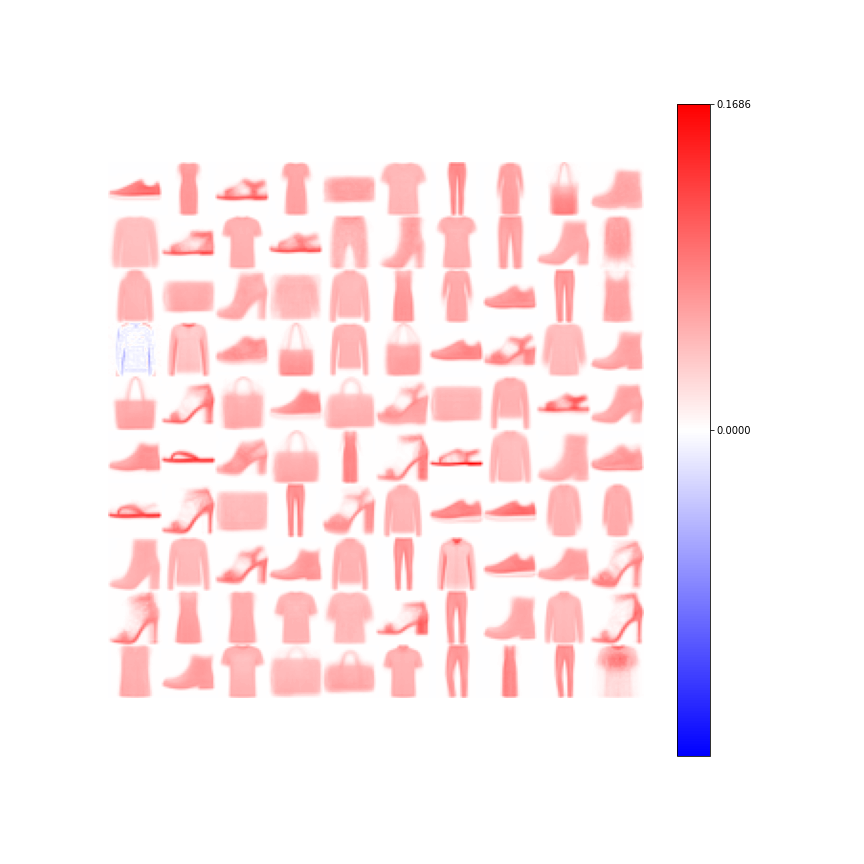

100%|██████████| 120/120 [00:00<00:00, 183.99it/s]


Max val:  0.9542032557654374 Min value:  0.006333985600276679 Mean val:  0.880169627222654 Std:  0.10494417138067853
Elapsed time:  8.28097915649414  seconds


<IPython.core.display.Javascript object>


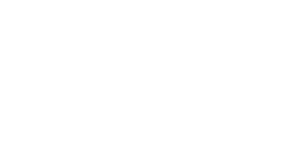

In [246]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 10
Ky = 10
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = fa_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)
    
print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")


LOOOOOOLLLLLLLLL!  I don't know why I find this so funny, but I dooooooooooo!!!!!!!! HAHAHAHAHAAHAHAHAHAHAHA! 

Oh my fucking gosh that's hilarious.  I got to run a classifier over this bad boi.

In [249]:
def wta_fa_class(w):    
    
    wins = np.argmax(w @ fa_x.T, axis=0)
    
    n_wins = np.zeros((w.shape[0], 10))
    
    for (n_i, lbl) in zip(wins, tr_y):
        n_wins[n_i][lbl] += 1
        
    n_cls = np.argmax(n_wins, axis=1)
    print("Neuron classes:", n_cls)
    
    num_test = te_y.shape[0]    
    num_correct = 0
    
    incorrect = np.zeros(10)
    
    for i in range(num_test):
        w_mul_v = w @ fa_test[i].T
        
        n_max = np.argmax(w_mul_v)
        
        pre = n_cls[n_max]
        if pre == te_y[i]:
            num_correct += 1
        else:
            incorrect[te_y[i]] += 1
            
    print("Accuracy:", str(num_correct * 100 / num_test) + '%')
    print("Misclassifieds: ", incorrect)

In [250]:
wta_fa_class(w)

Neuron classes: [7 3 5 3 8 0 1 3 8 9 2 5 0 5 1 9 0 1 9 4 4 8 9 8 4 3 3 7 1 0 0 2 7 8 2 8 7
 5 6 9 8 5 8 7 8 5 8 4 5 9 9 5 5 8 3 5 5 2 9 7 5 5 8 1 5 4 7 7 4 4 9 2 5 9
 4 1 6 7 9 5 5 3 0 0 6 5 1 9 6 5 6 9 0 8 8 0 1 3 1 0]
Accuracy: 75.4%
Misclassifieds:  [184.  75. 520. 240. 315. 288. 610. 114.  63.  51.]


Well, I don't know why this is funny, but it is. Also the mother fucker got 75% correct!  I have no idea if that's good!  It seems pretty good.  Let's do 400 neurons!

<IPython.core.display.Javascript object>


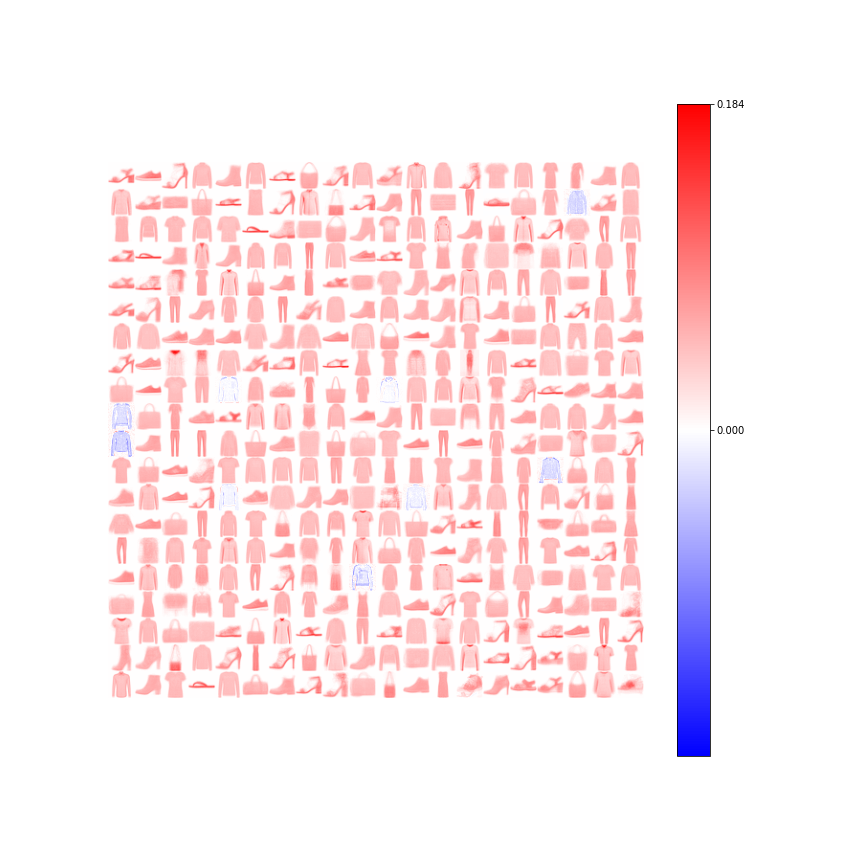

100%|██████████| 120/120 [00:02<00:00, 41.85it/s]


Max val:  0.9623064450853258 Min value:  0.0061198607175779515 Mean val:  0.8272142502972138 Std:  0.16637116846668829
Elapsed time:  30.893475770950317  seconds
Neuron classes: [5 7 5 4 9 2 5 8 5 2 5 6 4 5 0 2 3 3 9 4 6 5 8 8 5 6 5 6 8 5 9 1 8 1 5 8 3
 0 5 6 0 2 0 4 6 5 9 8 8 9 0 2 2 9 8 6 5 6 1 2 5 5 9 4 9 4 2 1 2 7 5 0 0 0
 8 0 4 2 4 1 5 5 0 3 6 8 9 3 5 8 6 9 9 2 4 1 4 8 3 1 5 5 1 9 3 4 1 5 4 9 4
 9 9 2 9 8 1 5 2 9 6 4 7 9 9 6 9 4 7 2 8 7 9 0 7 8 4 1 4 9 5 7 0 3 0 5 5 2
 5 3 3 4 4 3 2 5 2 8 0 2 8 7 0 1 0 4 5 3 8 3 0 2 2 2 0 5 5 7 9 9 0 8 3 7 5
 2 6 0 4 7 9 1 8 2 1 9 4 4 9 7 0 9 1 1 4 8 9 0 8 8 0 7 1 7 3 5 8 0 8 5 0 8
 7 5 0 2 2 2 1 3 3 0 6 9 0 3 0 8 4 3 7 6 7 5 0 7 6 9 9 8 5 0 4 9 4 1 4 5 8
 3 6 7 8 1 2 0 8 4 4 0 2 8 5 5 3 1 8 8 8 3 1 2 2 6 2 6 9 6 3 6 8 3 7 9 6 1
 0 7 5 3 7 6 4 4 6 1 5 4 3 0 4 3 2 5 0 6 8 0 0 4 8 3 8 4 0 7 2 3 7 3 4 7 5
 0 8 1 9 9 8 5 0 2 8 8 5 8 6 5 4 1 5 2 0 6 5 0 5 7 1 5 9 9 8 4 5 3 5 8 2 9
 2 8 2 2 5 5 5 8 6 3 6 9 0 5 2 8 9 5 5 8 8 9 3 7 9 5 5 8 6 5]
Accuracy: 

<IPython.core.display.Javascript object>


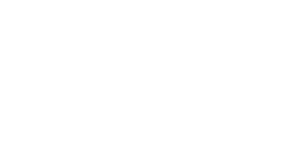

In [253]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 20
Ky = 20
Nep = 10
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

w_c = np.abs(np.random.normal(0, 1, (10, N))) # synapses of each neuron
w_c = w_c / np.array([np.linalg.norm(w_c, axis=1)]).T
s_c = np.zeros(10).reshape(-1, 1) # Specialization for each neuron+

win_c_mask = np.zeros((10, train_y.shape[0]))
win_c_mask[train_y, np.arange(train_y.shape[0])] = 1

inputs = fa_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
        #Classification layer
        batch_win_c_mask = win_c_mask[:, i * B: (i + 1) * B]
        batch_win_c_mask = batch_win_c_mask / np.maximum(np.sum(batch_win_c_mask, axis=1), 1).reshape(-1, 1)

        batch_wins = train_y[i * B: (i + 1) * B]

        w_mul_v_c = w_c @ o
        
#         print(o.shape, w_c.shape, np.linalg.norm(o, axis=0).shape)
        
        o_c = w_mul_v_c / (np.linalg.norm(w_c, axis=1).reshape(-1, 1) * np.linalg.norm(o, axis=0))

        win_avg_c = (np.sum(w_mul_v_c * batch_win_c_mask, axis=1)).reshape(-1, 1)

        v_update_c = batch_win_c_mask @ o.T

        w_c += (v_update_c - (win_avg_c * w_c)) * (np.exp(-1 * zeta * s_c) + beta) * xi

        s_c[batch_wins] *= (1 - phi)
        s_c += phi * np.sum(o_c * batch_win_c_mask, axis=1).reshape(-1, 1)

    draw_weights(w, Kx, Ky)
    
print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

wta_fa_class(w)

You know what?  I actually don't think this accuracy is super bad.  The 784-128-10 DNN from the tensorflow tutorials got 86%.  This actually isn't too far underneath.  Neat! 

Imma do 1600 neurons now, see how that bad boi goes.  

<IPython.core.display.Javascript object>


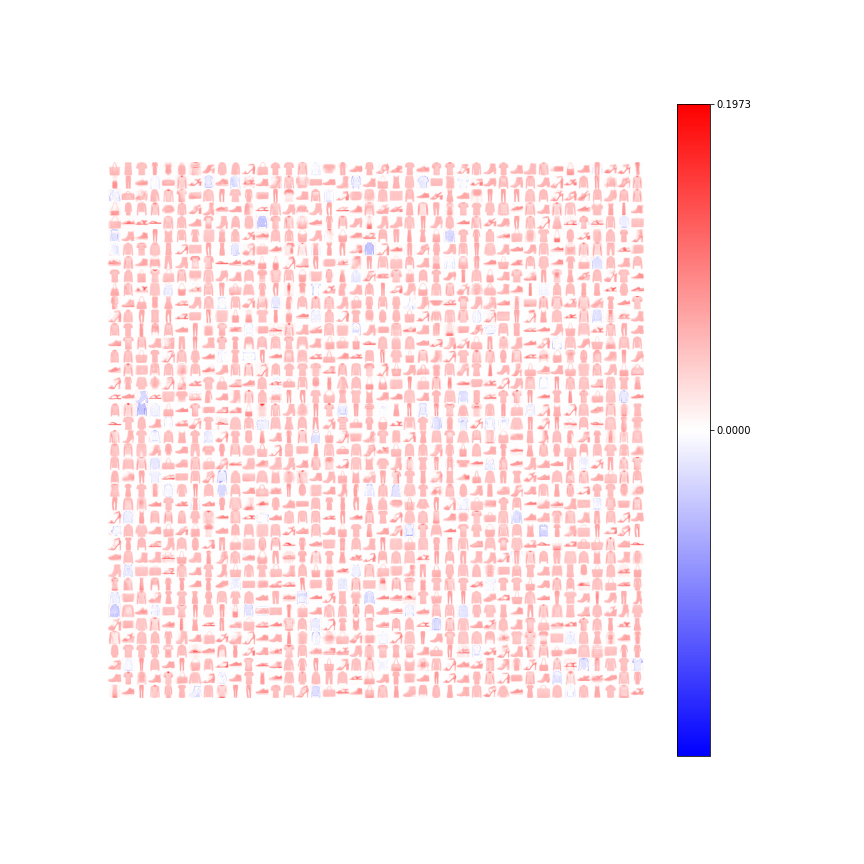

100%|██████████| 120/120 [00:10<00:00, 11.86it/s]


Max val:  0.5829931647716852 Min value:  0.005896699746324189 Mean val:  0.21266042325339407 Std:  0.11709231490644055
Elapsed time:  40.964470863342285  seconds
Neuron classes: [8 6 0 ... 6 2 5]
Accuracy: 82.95%
Misclassifieds:  [175.  45. 267. 132. 263. 149. 513.  56.  34.  71.]


<IPython.core.display.Javascript object>


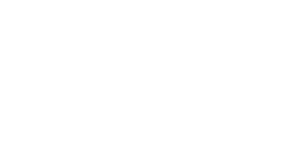

In [256]:
%matplotlib inline
%matplotlib notebook
fig=plt.figure(figsize=(12,12))

Kx = 40
Ky = 40
Nep = 4
T_s = 60000
xi = 0.1
phi = 2 / 501

zeta = 200
beta = 0.05

B = 500 #Batch size

start = time()
N = Kx * Ky

w = np.abs(np.random.normal(0, 1, (N, L))) # synapses of each neuron
w = w / np.array([np.linalg.norm(w, axis=1)]).T #NORMALIZE THE WEIGHTS TO PREVENT EXXXPLOSIONS
s = np.zeros(N).reshape(-1, 1) # Specialization for each neuron+

inputs = fa_x

for ep in range(Nep):
    # Uncomment the following line if you'd like to shuffle the data between epochs
    
    for i in tqdm(range(T_s // B)):
        # Hidden Layer
        v = inputs[i * B: (i + 1) * B, :]

        w_mul_v = w @ v.T 
        o = w_mul_v / (np.linalg.norm(w, axis=1).reshape(-1, 1) * np.linalg.norm(v, axis=1))

        c = (np.exp(-1 * zeta * s) + beta) * o

        wins = np.argmax(c, axis=0)     

        win_mask = np.zeros((N, B))
        win_mask[wins, np.arange(B)] = 1
        win_mask = (win_mask / np.maximum(np.sum(win_mask, axis=1), 1).reshape(-1, 1))

        win_avg = (np.sum(w_mul_v * win_mask, axis=1)).reshape(-1, 1)

        v_update = win_mask @ v

        w += (v_update - (win_avg * w)) * (np.exp(-1 * zeta * s) + beta) * xi

        s[wins] *= (1 - phi)
        s += phi * np.sum(o * win_mask, axis=1).reshape(-1, 1)
        
    draw_weights(w, Kx, Ky)
    
print("Max val: ", np.amax(s), "Min value: ", np.amin(s), "Mean val: ", np.mean(s), "Std: ", np.std(s))
print("Elapsed time: ", time() - start, " seconds")

wta_fa_class(w)

Well that's pretty fucking neat.  And it got 83% accuracy!  Yay!  

As a final step in this cookhouse, I'm going to pull in cifar-10 and train on it!  I gotta get over this hump.  I feel like it's a pretty small hump.

In [274]:
from tensorflow.keras.datasets import cifar10
import matplotlib.pyplot as plt

(tri_x, tri_y), (tei_x, tei_y) = cifar10.load_data()

tri_x = tri_x / 255.0
tei_x = tei_x / 255.0

<IPython.core.display.Javascript object>


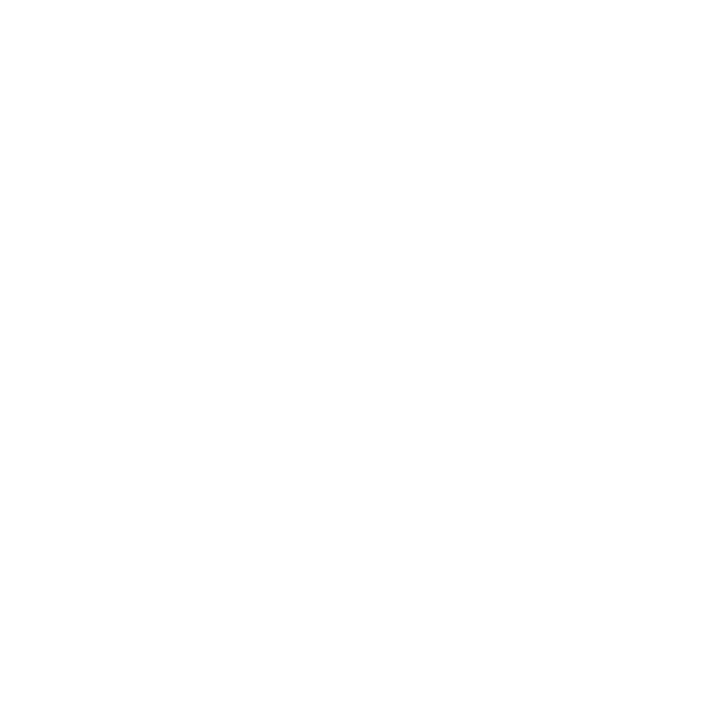

<IPython.core.display.Javascript object>


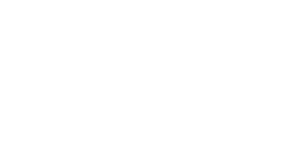

In [273]:
plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(tri_x[i], cmap=plt.cm.binary)
    # The CIFAR labels happen to be arrays, 
    # which is why you need the extra index

plt.show()

Just kidding.  imshow just decided to die on me, and I don't really want to figure that one out rn, so we're just going to head on over to the conclusions section.  

## Conclusions

Well, this was a wild experiment.  A cookhouse indeed!  What did I learn?  Basically don't try any silly shit with wta.  The purpose of specialization is to quickly get weight prototypes into the ball-park of the input state.  After that, literally just do wta.  

To put this in more precise language, the purpose of specialization is two-fold.  First of all, it's there to help uninitialized (and therefore unspecialized) neurons win.  We don't want to bunch of uninitialized poosers hanging about. Secondly, if a neuron isn't specialized, it has a much higher learning constant, and therefore rockets into the input space faster than a well-established neuron moves about.  

That's all specialization is supposed to do.  After that, the network should basically just behave as wta.  Winner-takes-all appears to be the key to the universe.  None of that special shit with cs-i or cs-i2, or any of that trumps this basic recipe:

Use specialization to get weight-prototypes into the ball-park, and then, after that, just do basic wta.  

Also, my OG classifier is absolute horseshit.  What isn't horseshit, you ask?  Wta classification, that's what.  My fucking 100 neuron networks were getting 90% on Mnist.  That's fucking ridiculous.  90%!!!  So I basically rigged the network to output 1 if the neuron wins, and 0 if it doesn't.  I think that's simply the move.  

## Next steps

CompSpec is good.  There's simply no way around it.  But now I have to figure out how to make it better.  I have a couple things in mind.  

First of all, having a single winner is good.  As previously mentioned, it gets us 90% accuracy on mnist.  But what about those tricky cases?  I think it might be nice (or simply necessary) to have more than one opinion.  So that's the premise of my networks moving forward.  I do believe we need different notions of competition to build more robust representations of information.  

It's also time to start thinking about multiple layers.  And breaking up inputs into smaller chunks.  Those two things are key.  The question is, how do you do it?  I'm going to look up connections in CNNs to see how those work, but I have some ideas about how I'm going to do this.  

Anyway.  Good to know that literally all my cute bells and whistles are basically shit in the face of wta.  But yeah.  This cookhouse was a huge success.